# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [1]:
# if plotnine is not installed in Jupter then use the following command to install it 

!pip install plotnine --user

Running this project require the following imports 

In [8]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
import random
import math
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN


from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.colors as mcolors


%matplotlib inline

In [9]:
def display_cluster(X, km=None, num_clusters=0):
    #     color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', "#93C572", "#FFA555", "#F1235A"]  # List of colors
    #     color = random.sample(colors, 5000)


    #colors = ['#%02x%02x%02x' % (r, g, b) for r in range(256) for g in range(256) for b in range(256)]
    color = list(mcolors.XKCD_COLORS.values())
    alpha = 0.5  # Opacity of the colors
    s = 20  # Size of points

    num_dimensions = X.shape[1]  # Number of dimensions in the dataset

    if num_dimensions < 2:
        print("Cannot display less than 2 dimensions.")
        return

    if num_dimensions == 2:
        if num_clusters == 0:
            plt.scatter(X[:, 0], X[:, 1], c=color[0], alpha=alpha, s=s)
        else:
            for i in range(num_clusters):
                plt.scatter(X[km.labels_ == i, 0], X[km.labels_ == i, 1], c=color[i], alpha=alpha, s=s)
                #plt.scatter(km.cluster_centers_[i, 0], km.cluster_centers_[i, 1], c=color[i], marker='x', s=100)
                
            if -1 in km.labels_ :
                 plt.scatter(X[km.labels_ == -1, 0], X[km.labels_ == -1, 1], c=color[-1], alpha=alpha, s=s)
        plt.xlabel('Dimension 1')
        plt.ylabel('Dimension 2')
        plt.title('Cluster Visualization')
        plt.show()
    else:
        subplot_size = (num_dimensions * ((num_dimensions + 1) / 2)) - num_dimensions
        fig, axs = plt.subplots(math.ceil(subplot_size / 2), 2, figsize=(80, 40))
        fig.subplots_adjust(hspace=0.5)
        
        dim = -1
        count = 0
        for k in range(num_dimensions):
            for j in range(k+1, num_dimensions):
                
                col = count%2
                if count%2 == 0:
                    dim += 1
                count += 1
                
                if num_clusters == 0:
                    axs[dim, col].scatter(X[:, k], X[:, j], c=color[0], alpha=alpha, s=s)
                else:
                    for i in range(num_clusters):
                        axs[dim, col].scatter(X[km.labels_ == i, k], X[km.labels_ == i, j],
                                              c=color[i], alpha=alpha, s=s)
                        #axs[dim, col].scatter(km.cluster_centers_[i, k], km.cluster_centers_[i, j],
                         #                     c=color[i], marker='x', s=100)
                            
                    if -1 in km.labels_ :
                         plt.scatter(X[km.labels_ == -1, k], X[km.labels_ == -1, j], c=color[-1], alpha=alpha, s=s)
                axs[dim, col].set_xlabel(f'Dimension {k+1}')
                axs[dim, col].set_ylabel(f'Dimension {j+1}')
                axs[dim, col].set_title(f'Cluster Visualization (Dimensions {k+1} and {j+1})')
                

        plt.show()


## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



In [1]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

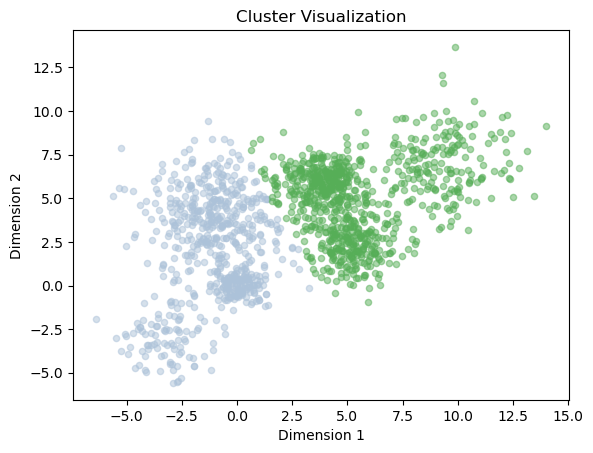

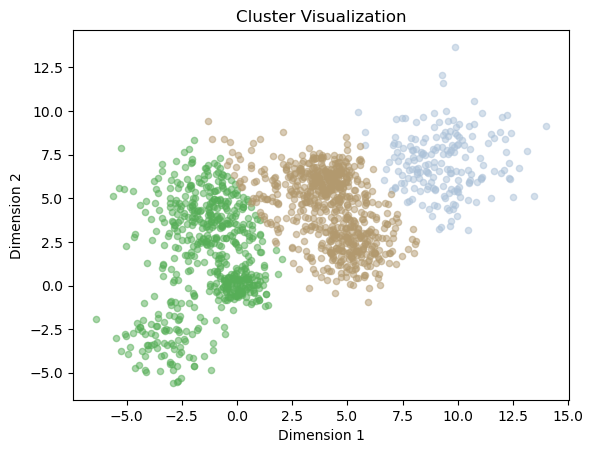

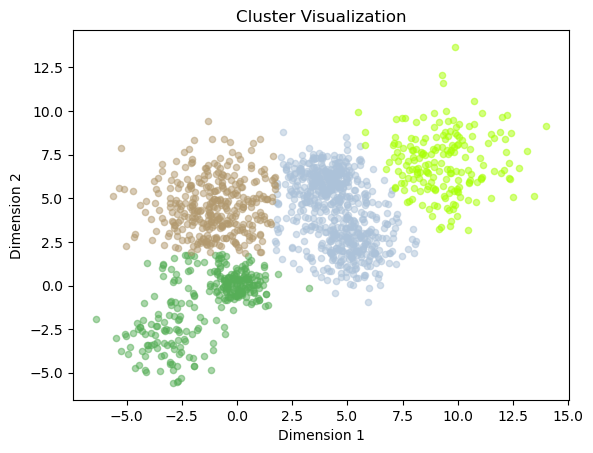

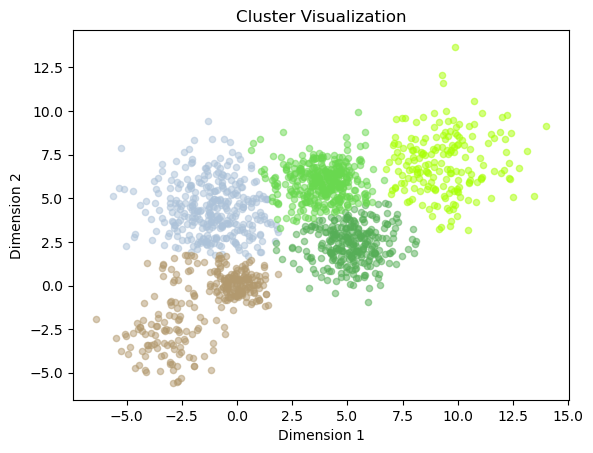

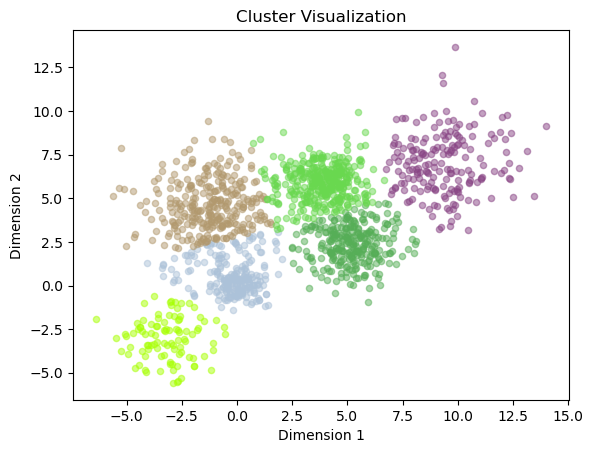

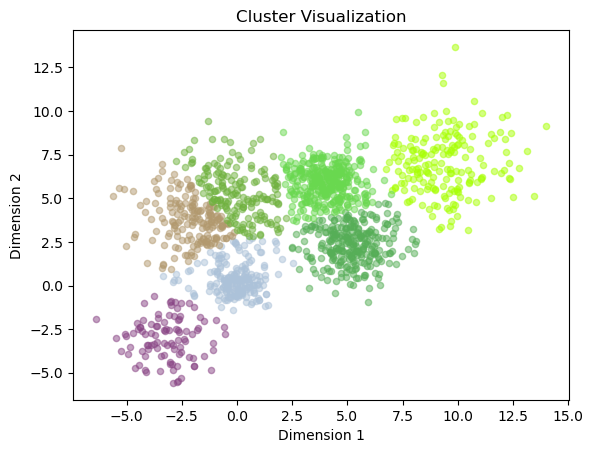

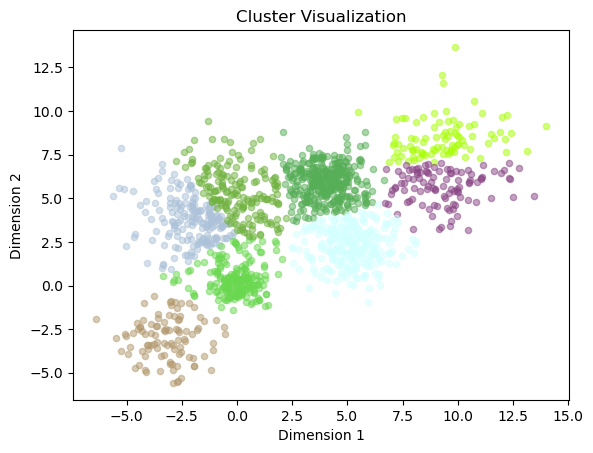

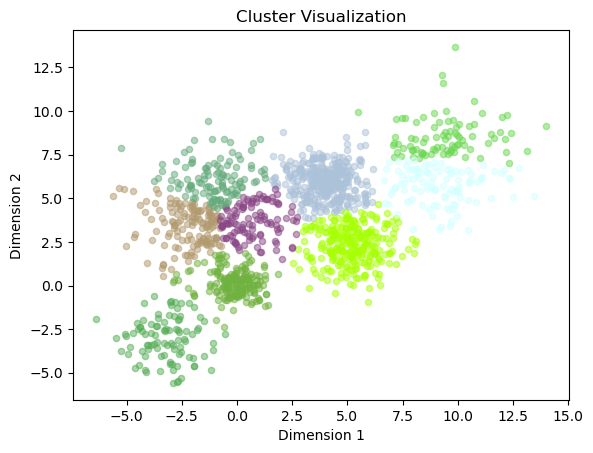

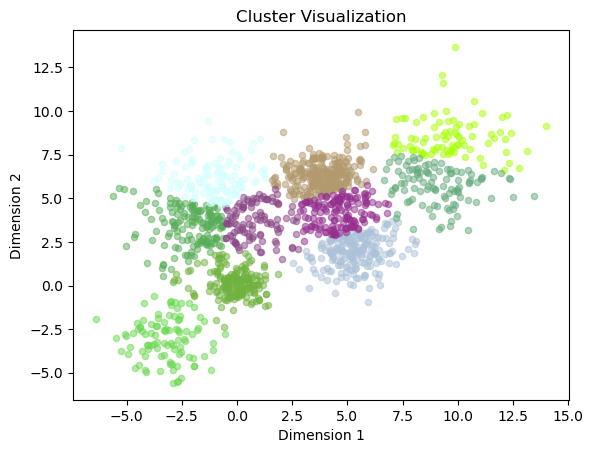

6
maximum silhouette score:  0.4862794240733028


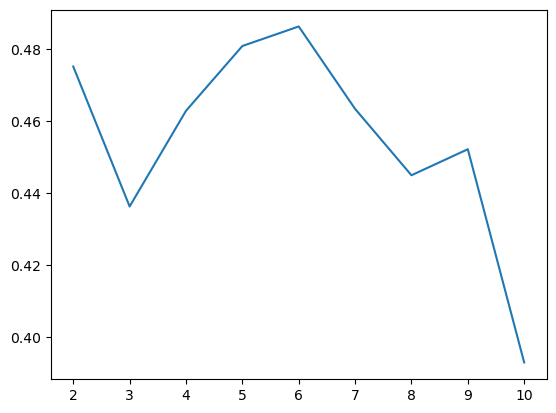

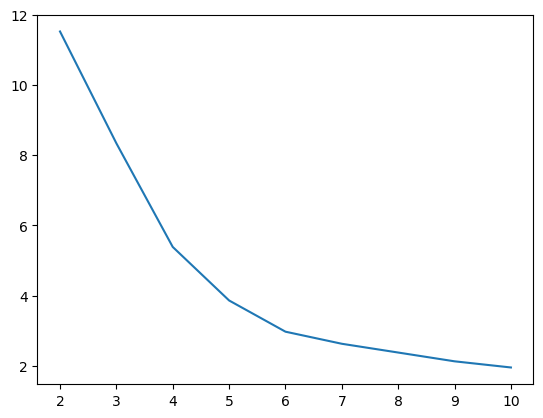

In [11]:
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
silhouette = []
metric = []
for i in range(2, 11):
    
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(Multi_blob_Data)
    metric.append((kmeans.inertia_) / len(Multi_blob_Data))
    silhouette_avg = silhouette_score(Multi_blob_Data, kmeans.labels_)
    silhouette.append(silhouette_avg)

    plt.figure()
    display_cluster(Multi_blob_Data, km=kmeans,num_clusters=i)
    
best_cluster = silhouette.index(max(silhouette)) + 2
print(best_cluster)
    
x_axis = np.linspace(2, 10, 9)

print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(x_axis, silhouette)

plt.figure()
plt.plot(x_axis, metric)



### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

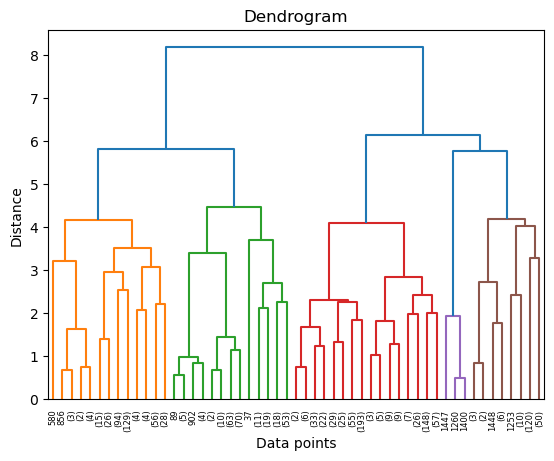

number of clusters 314


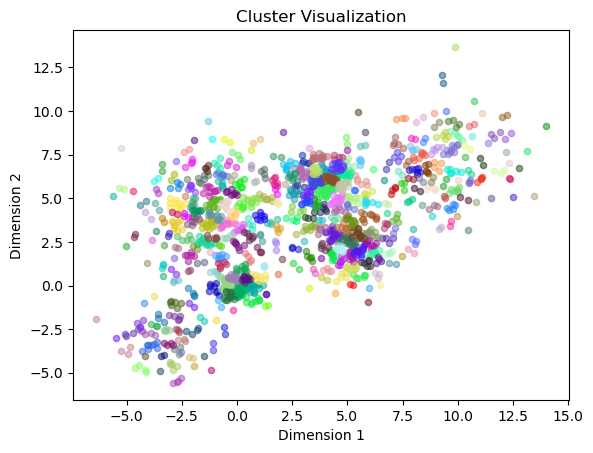

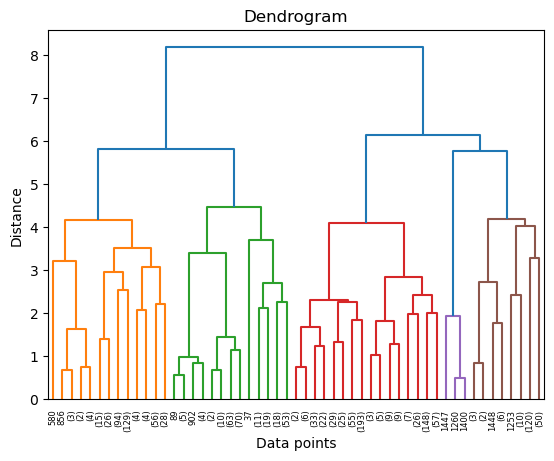

number of clusters 176


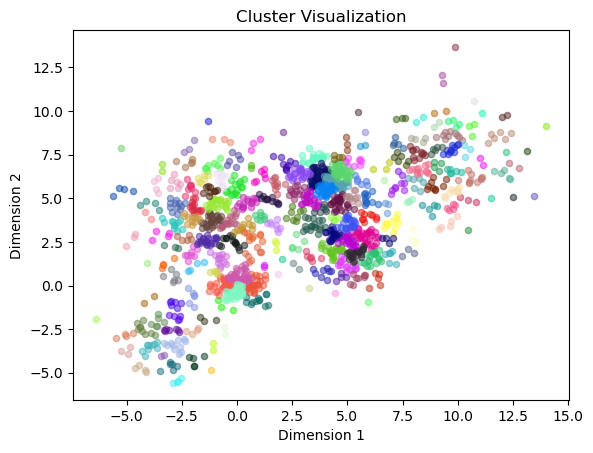

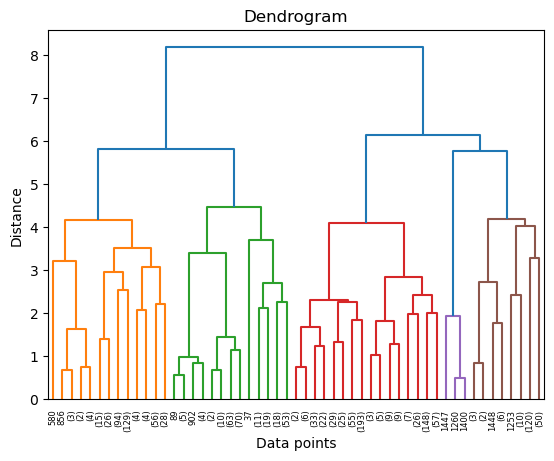

number of clusters 115


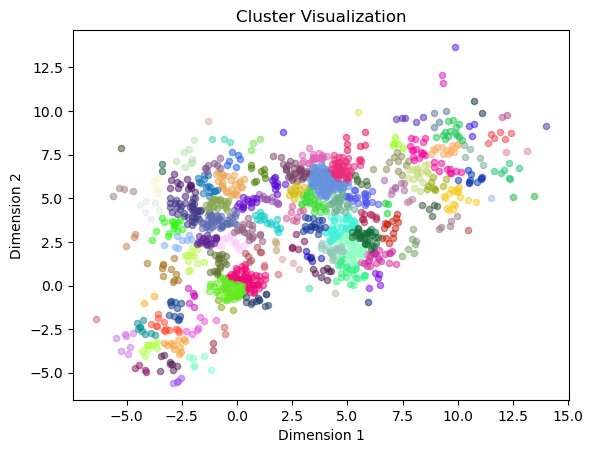

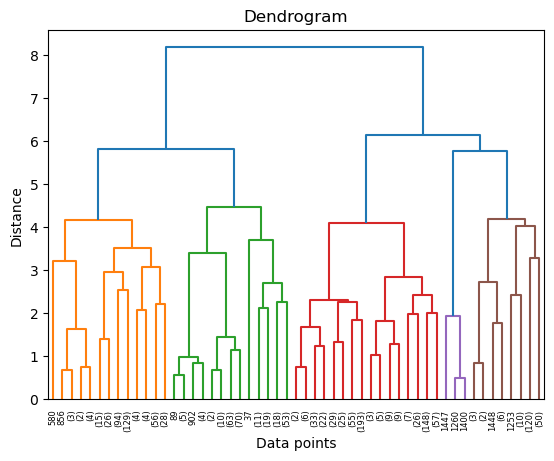

number of clusters 84


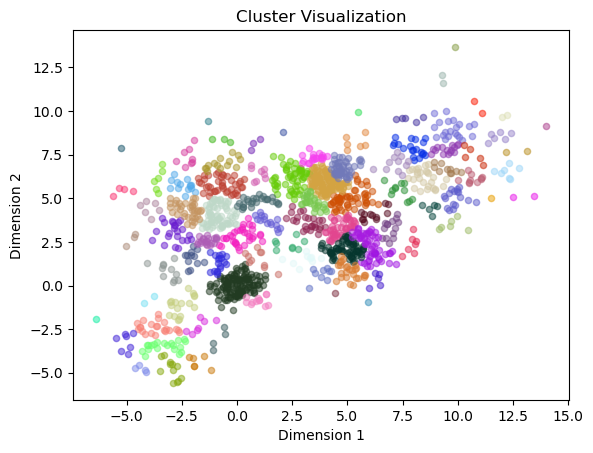

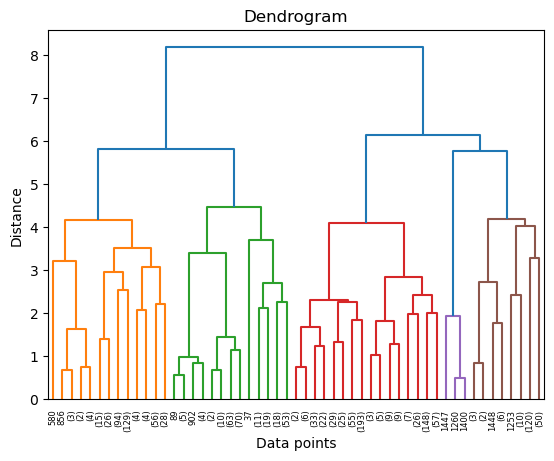

number of clusters 58


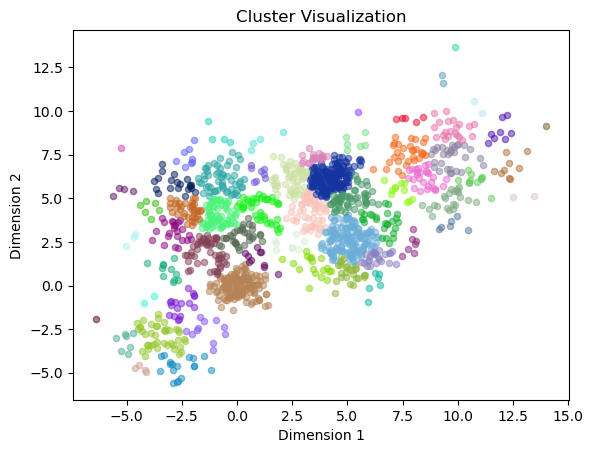

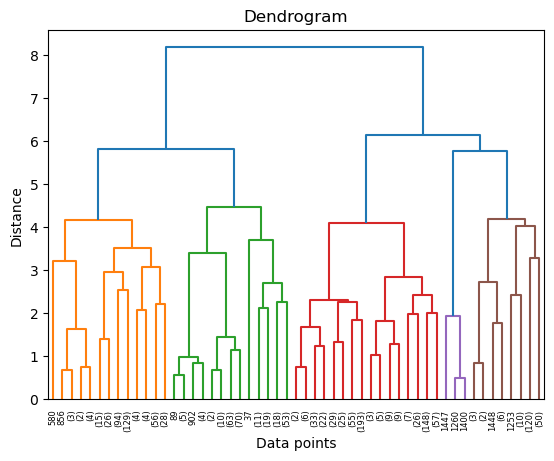

number of clusters 47


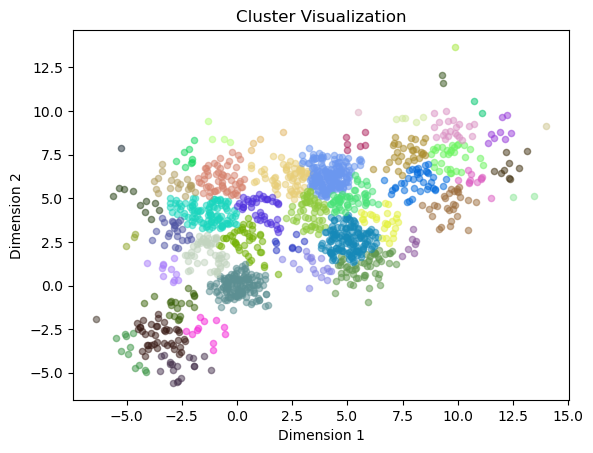

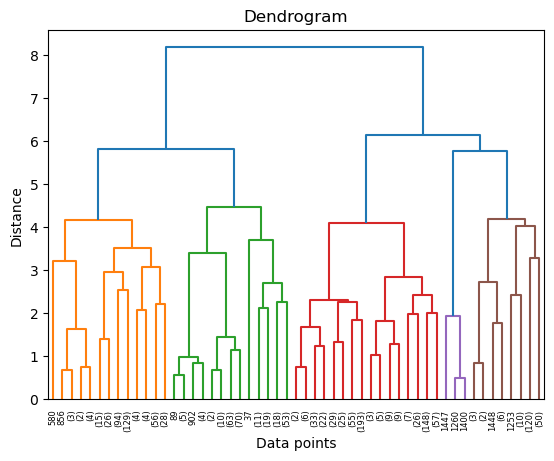

number of clusters 36


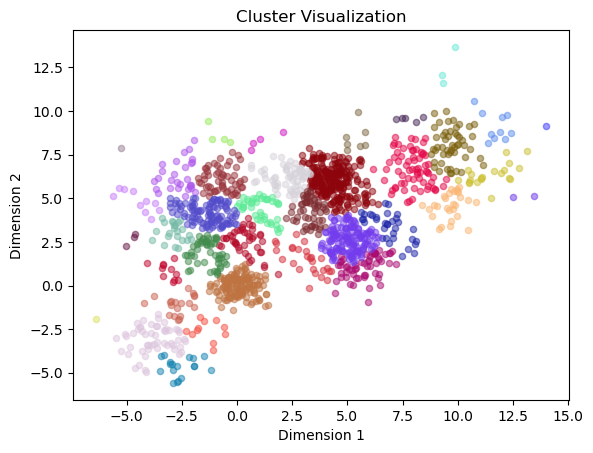

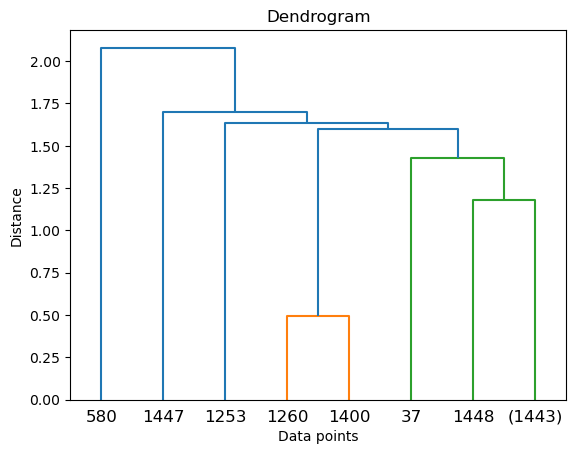

number of clusters 78


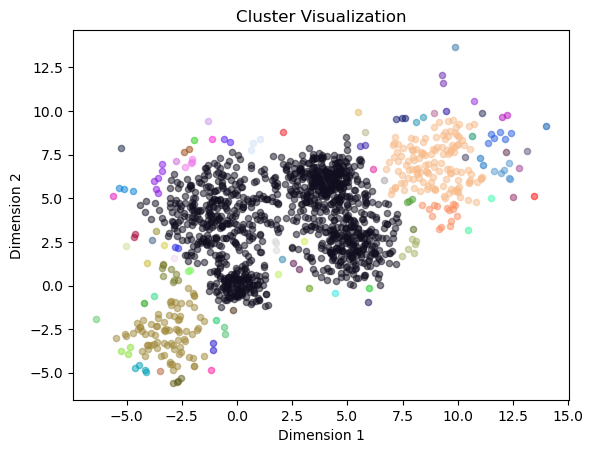

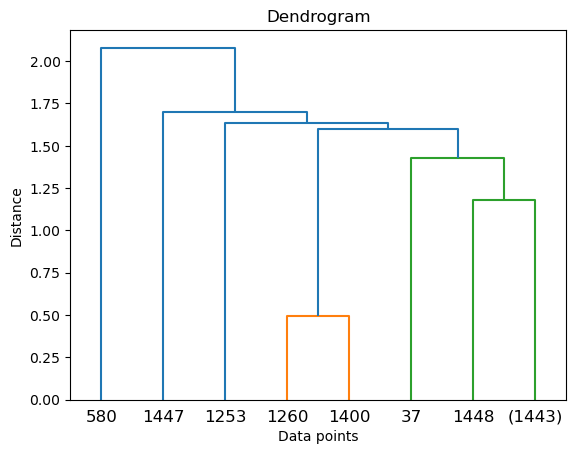

number of clusters 21


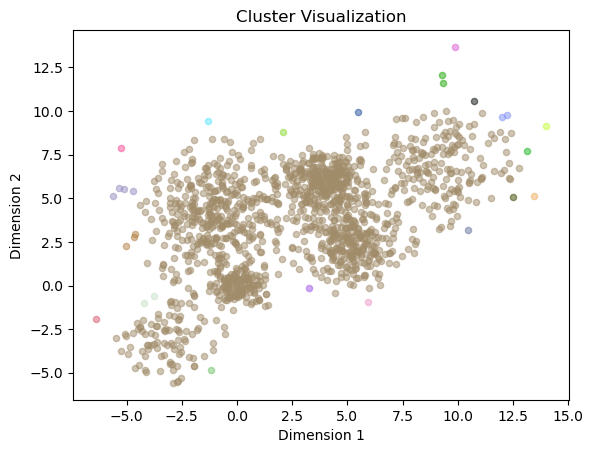

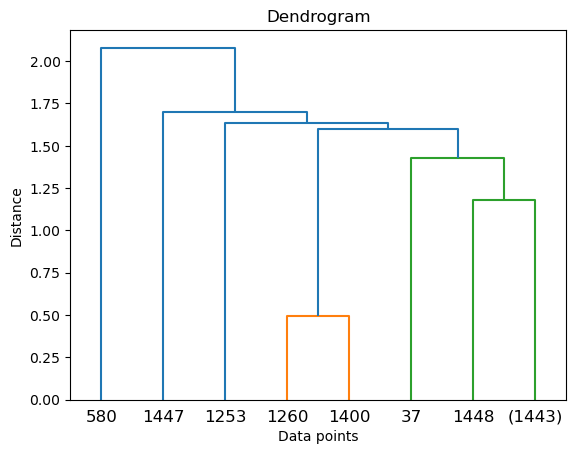

number of clusters 9


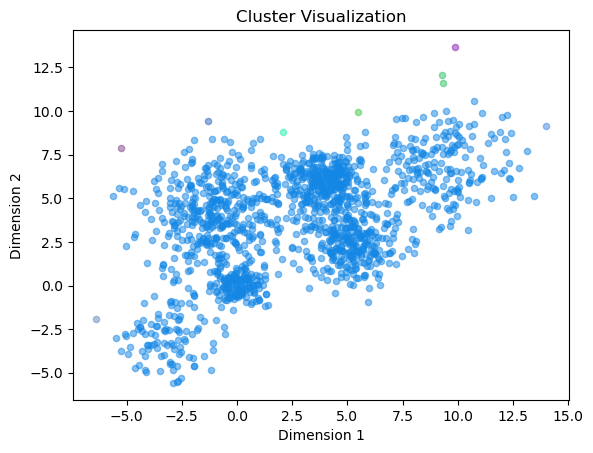

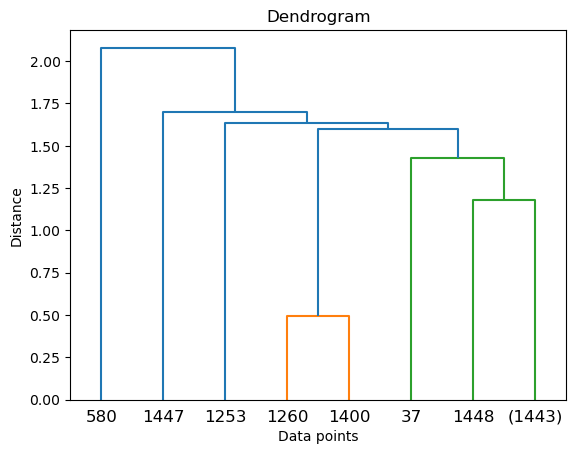

number of clusters 6


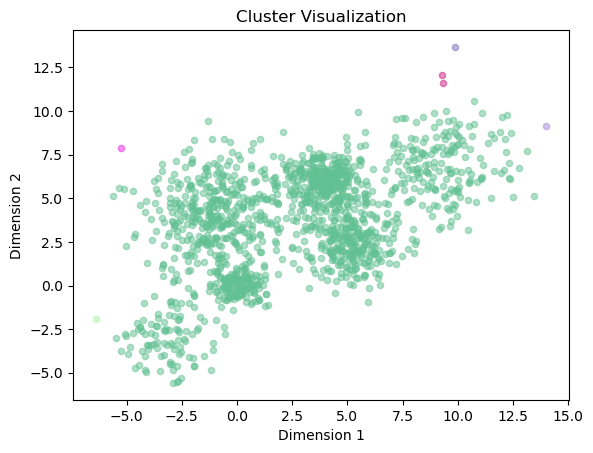

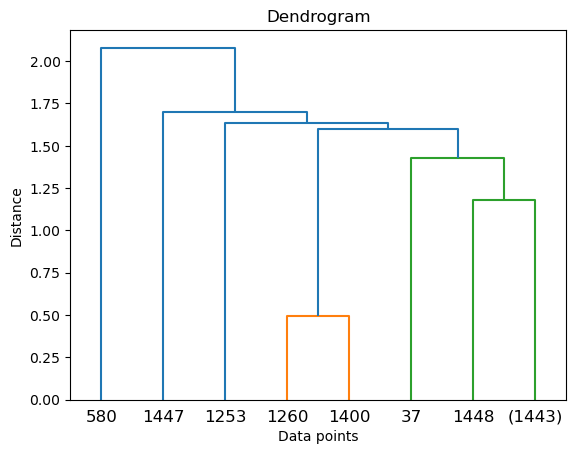

number of clusters 5


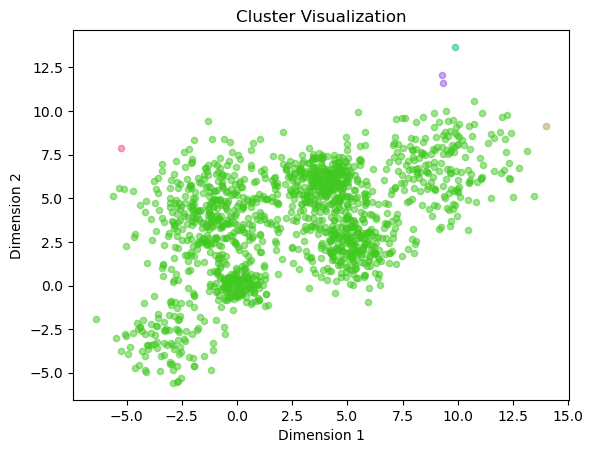

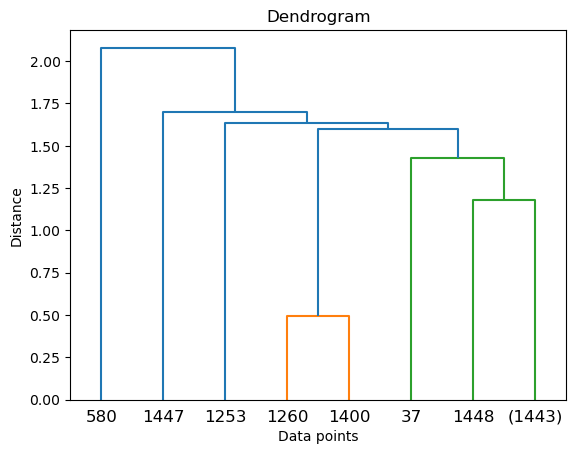

number of clusters 2


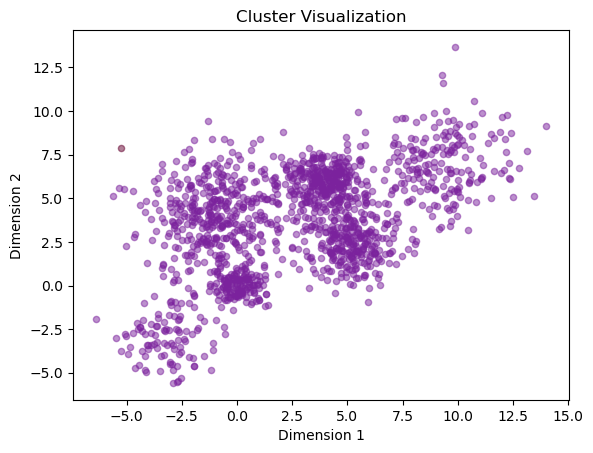

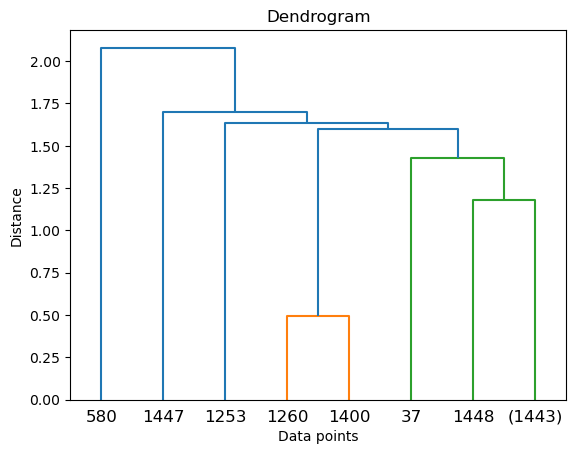

number of clusters 2


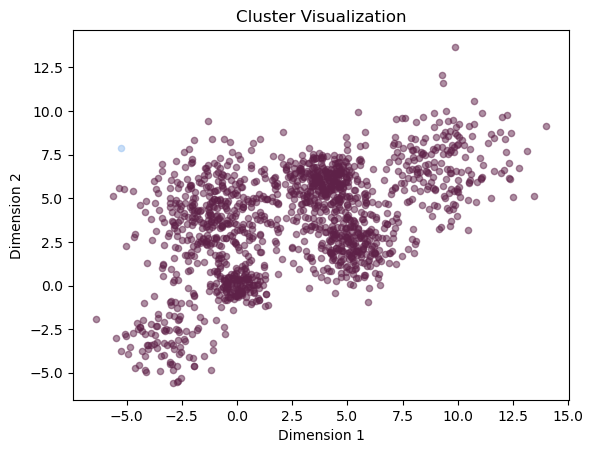

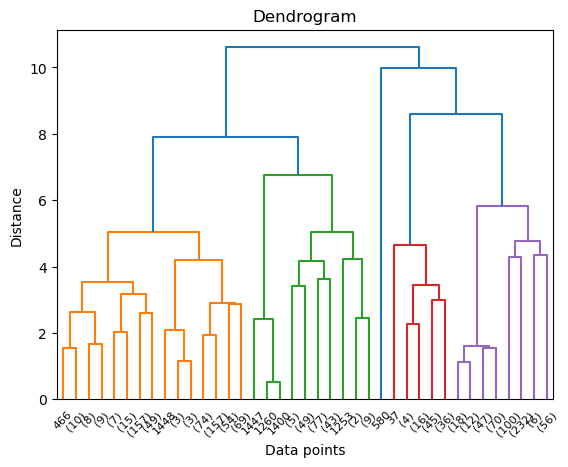

number of clusters 407


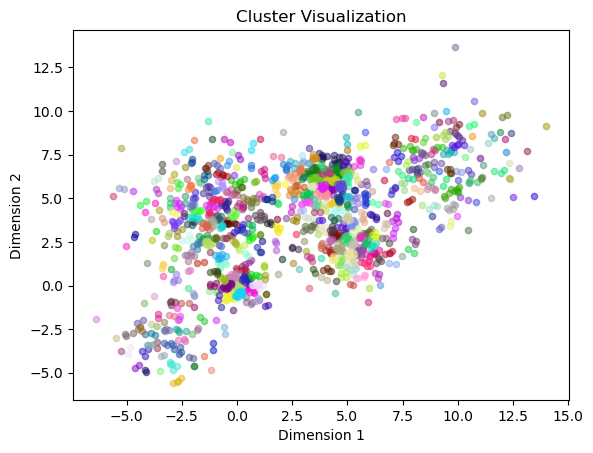

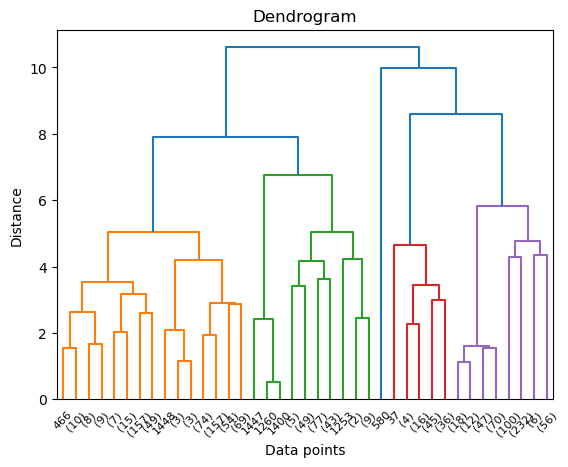

number of clusters 255


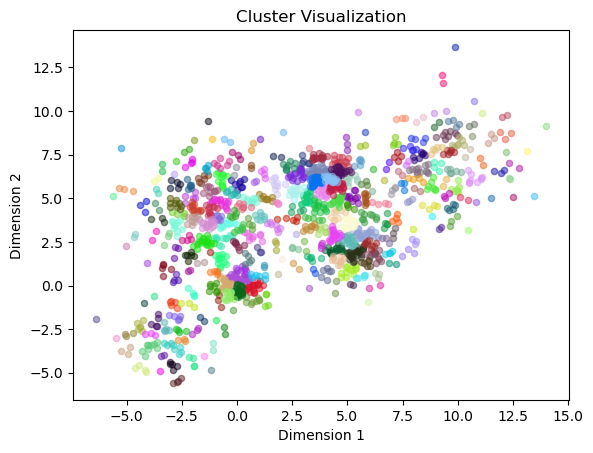

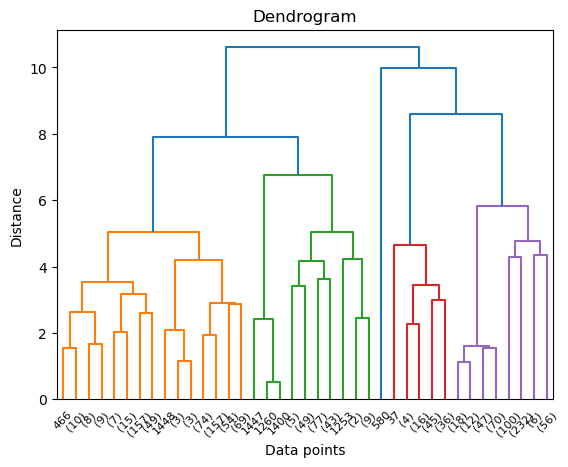

number of clusters 166


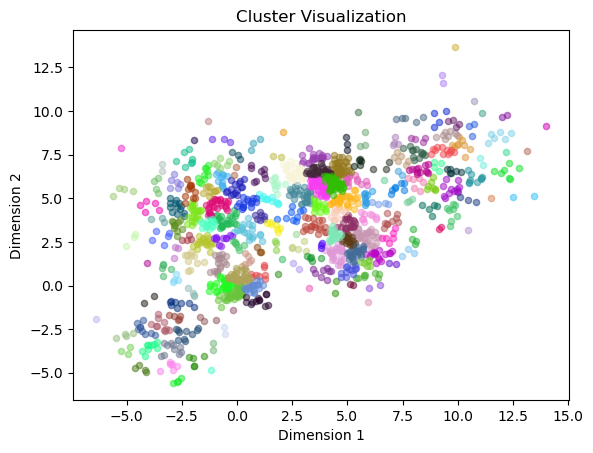

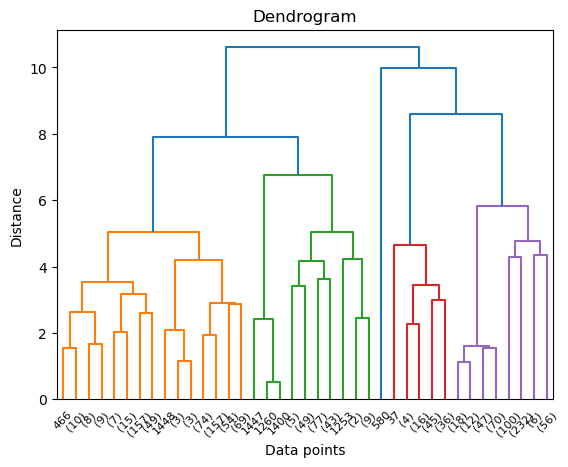

number of clusters 122


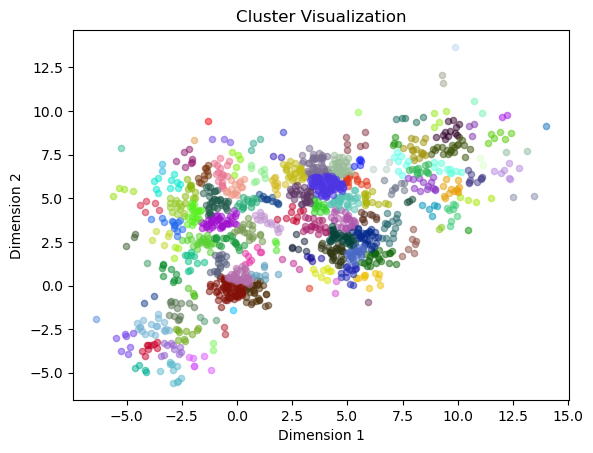

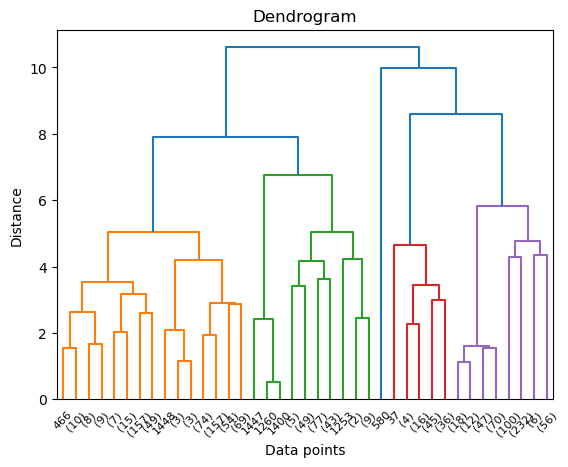

number of clusters 89


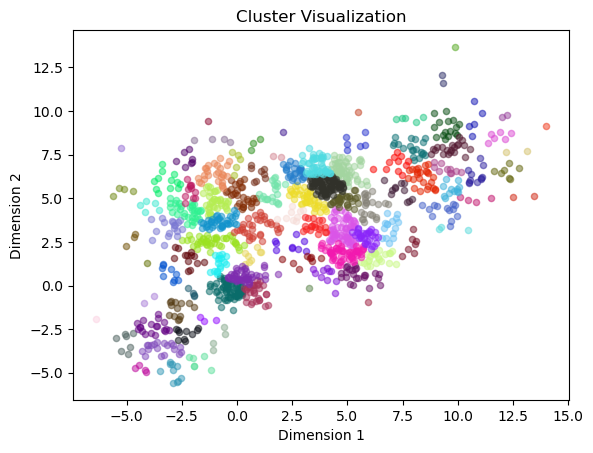

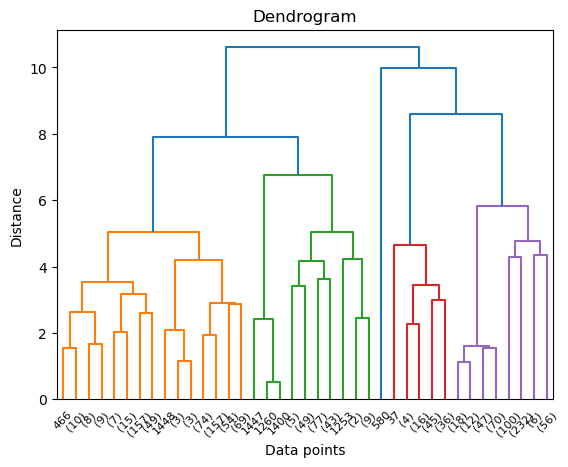

number of clusters 66


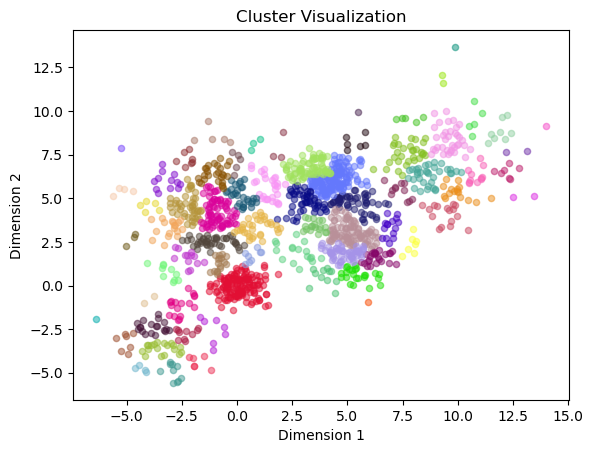

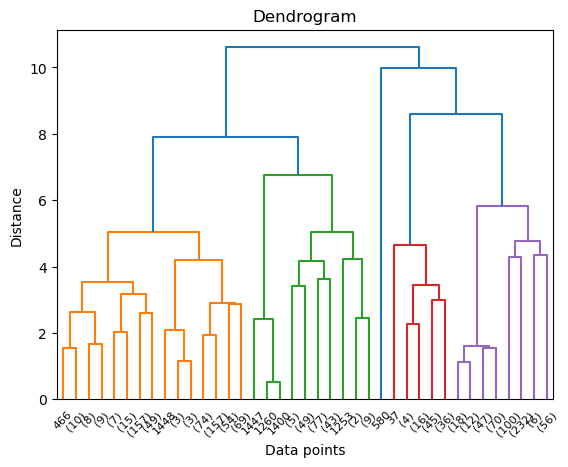

number of clusters 53


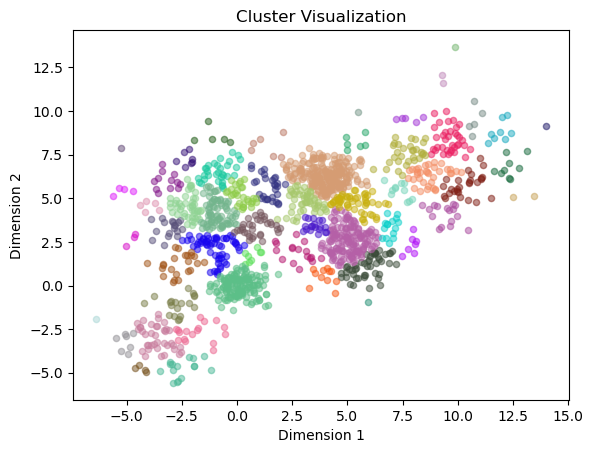

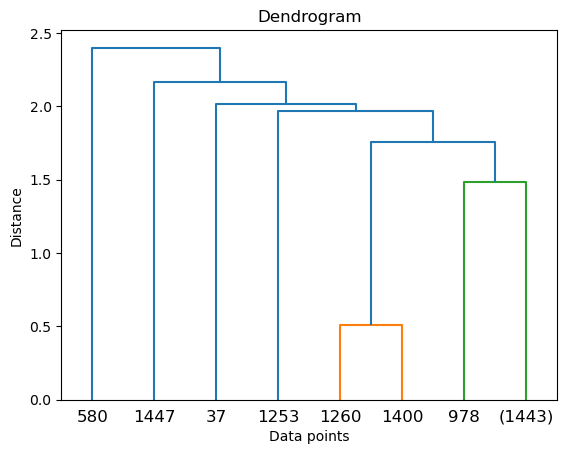

number of clusters 145


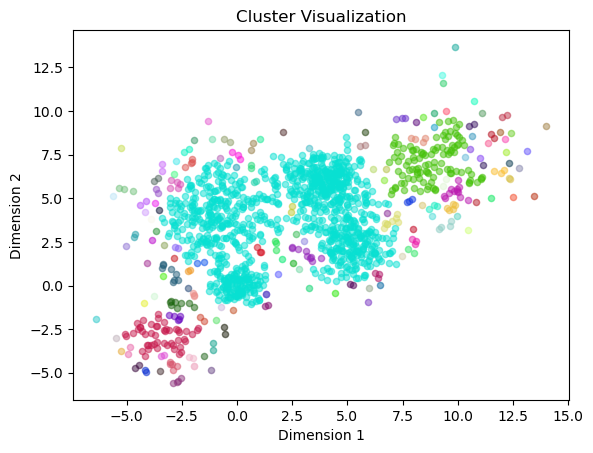

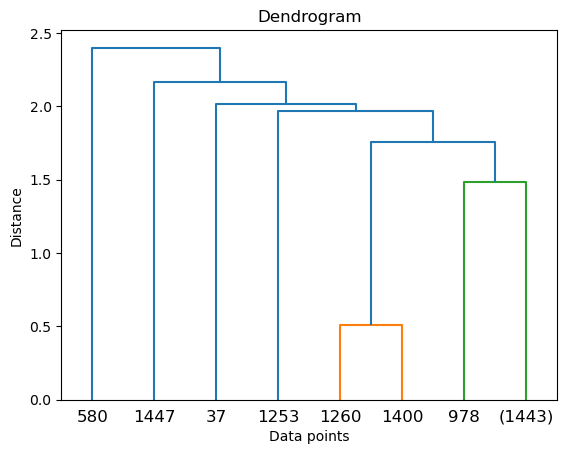

number of clusters 38


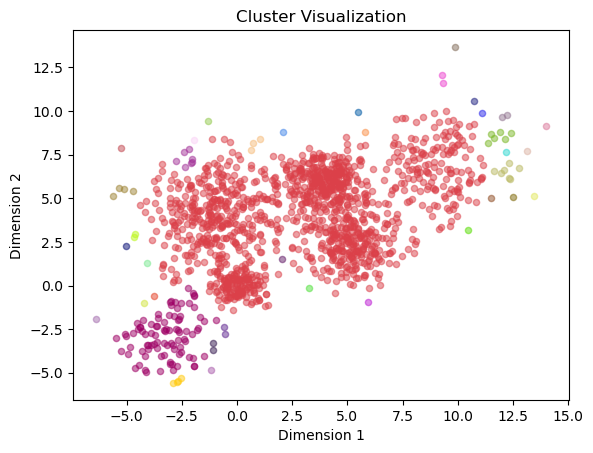

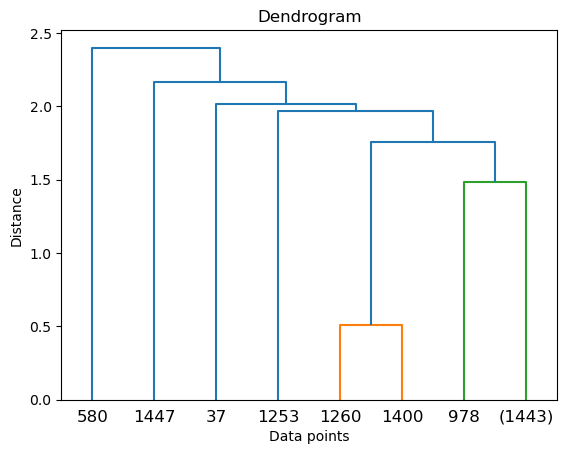

number of clusters 16


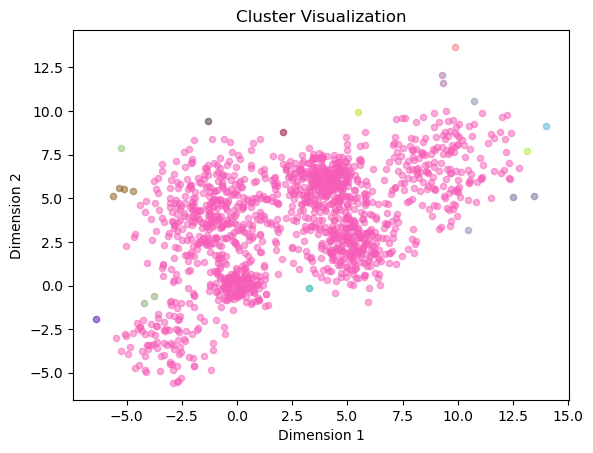

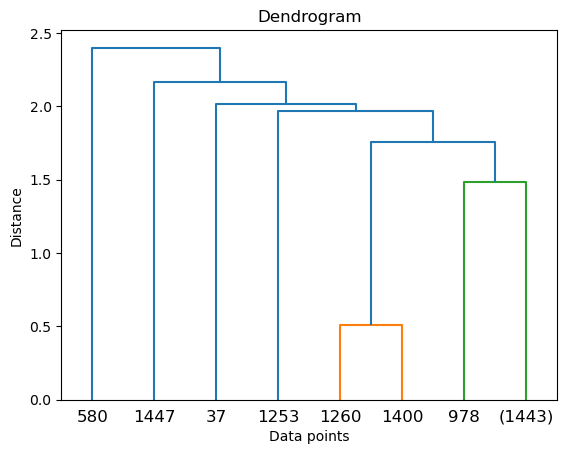

number of clusters 8


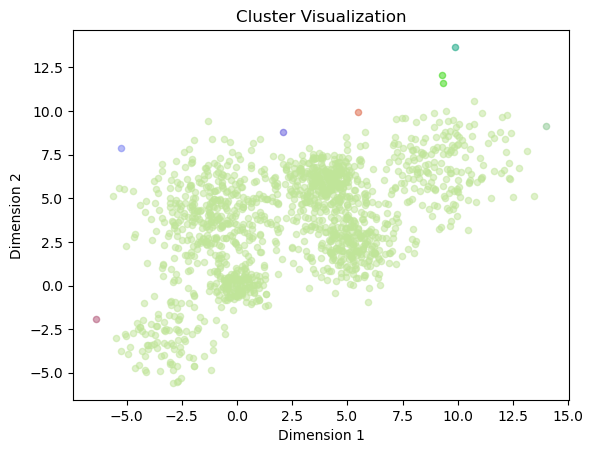

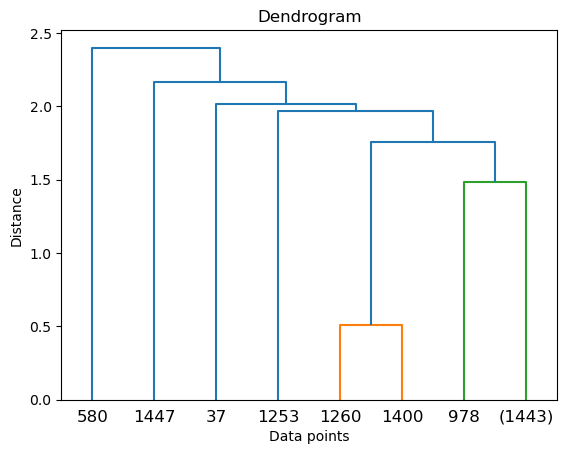

number of clusters 6


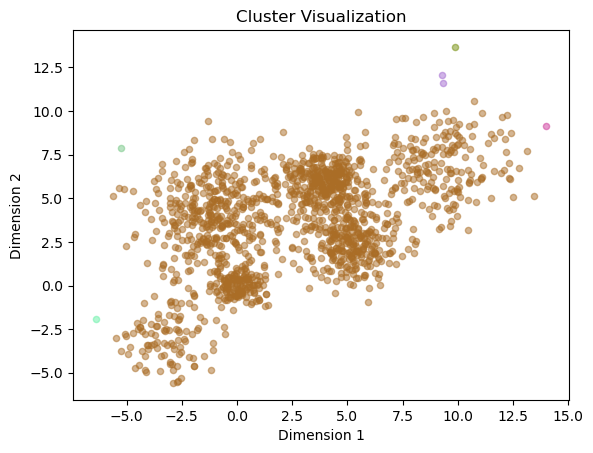

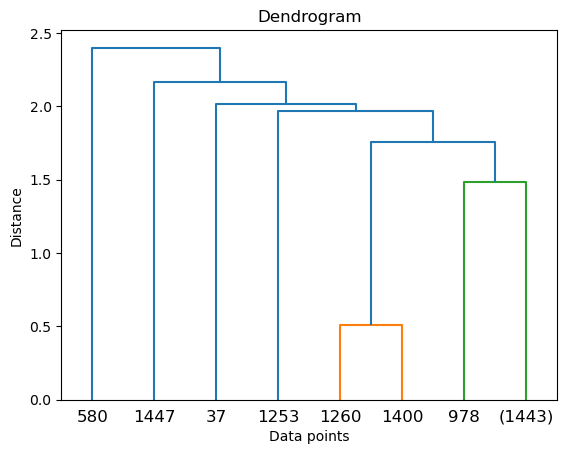

number of clusters 6


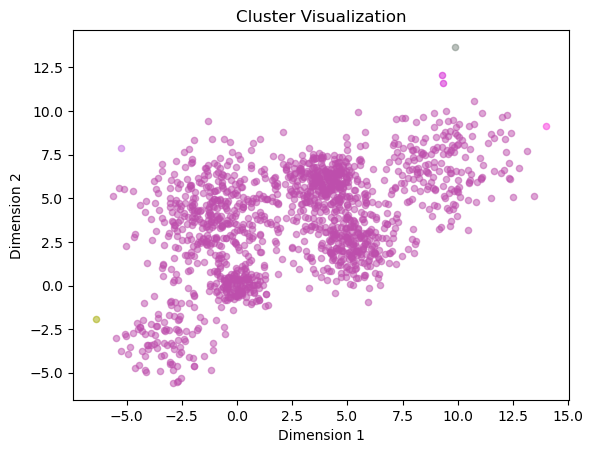

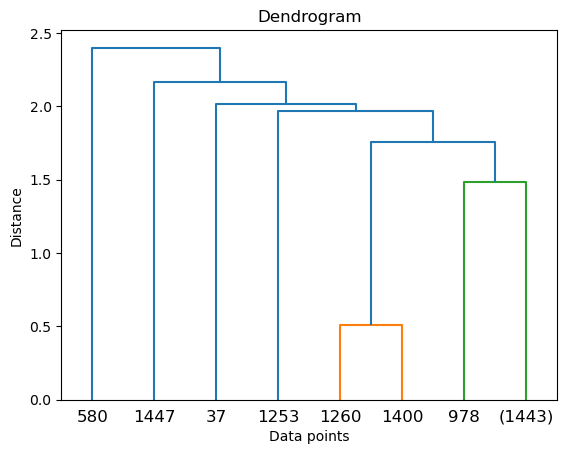

number of clusters 4


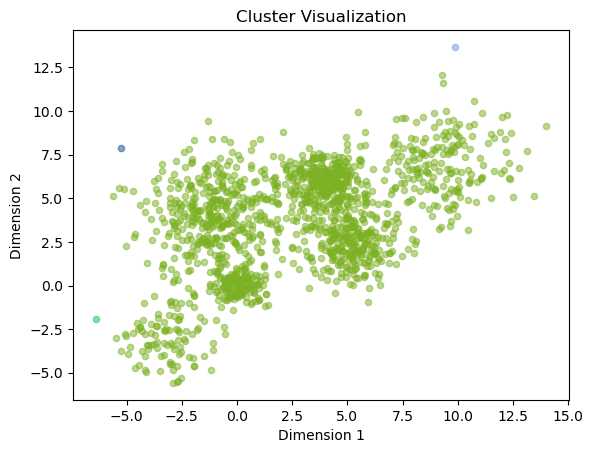

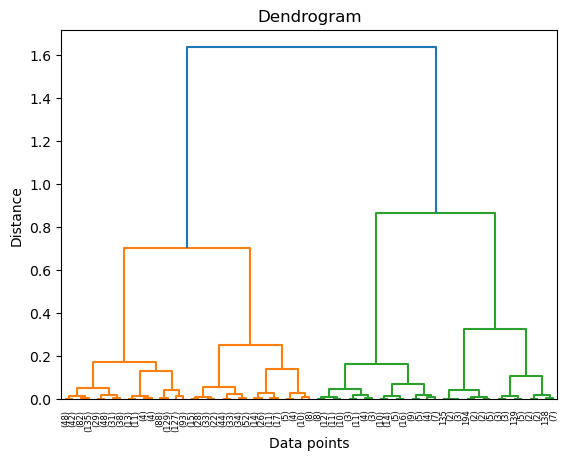

number of clusters 4


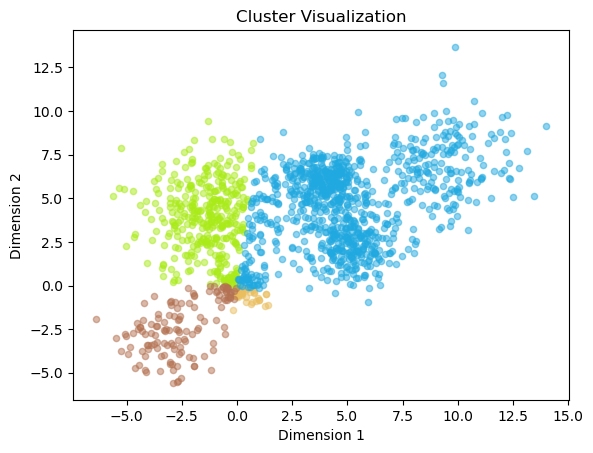

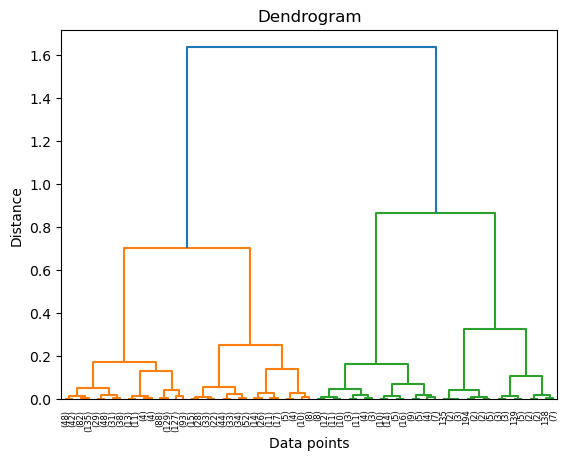

number of clusters 3


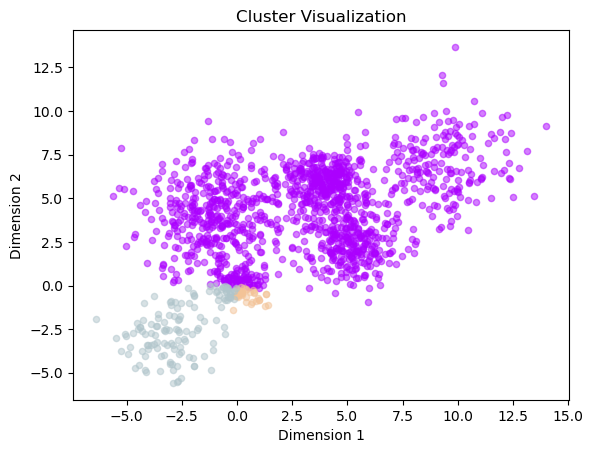

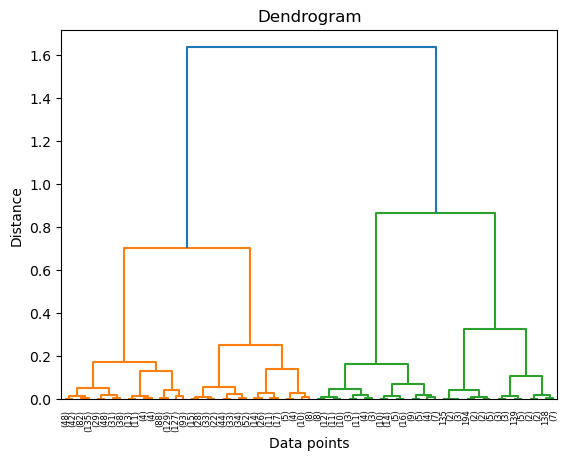

number of clusters 2


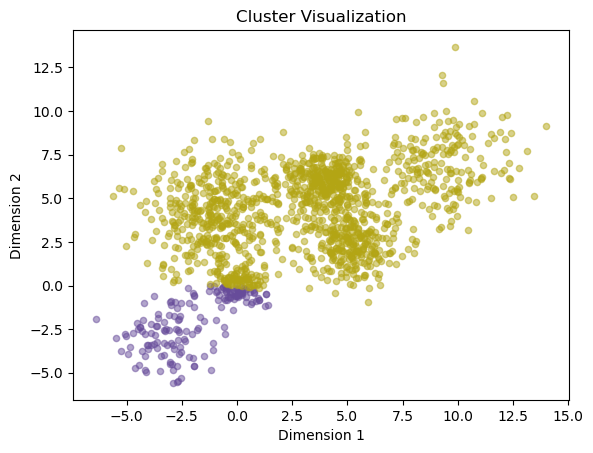

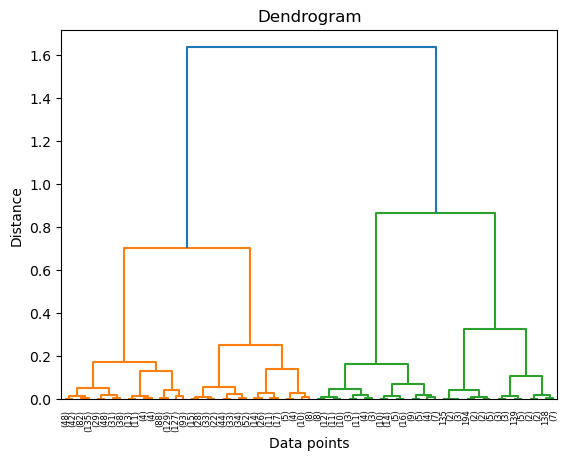

number of clusters 2


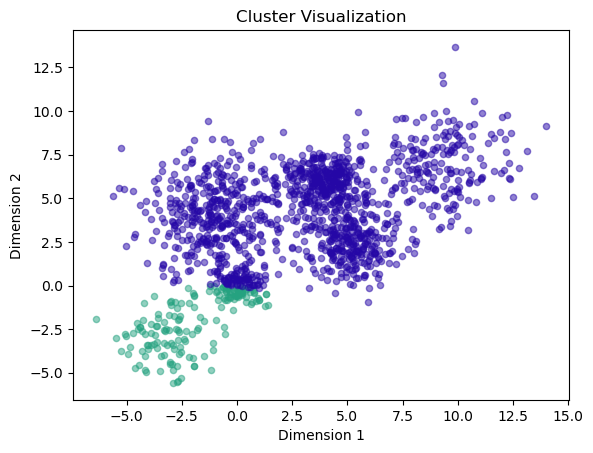

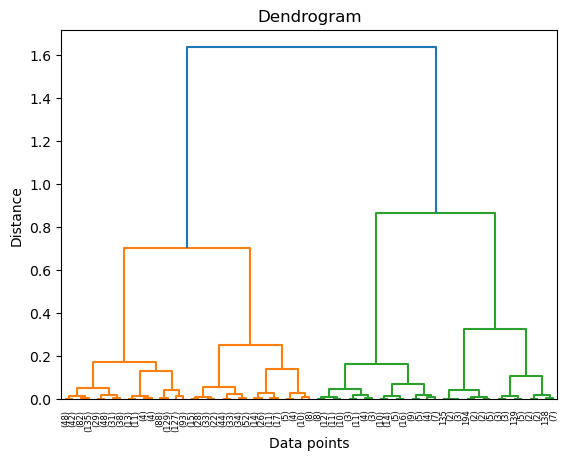

number of clusters 2


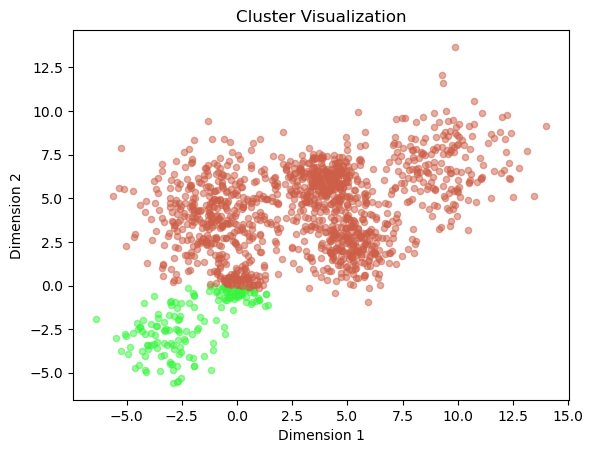

maximum silhouette score:  0.37556682733402785


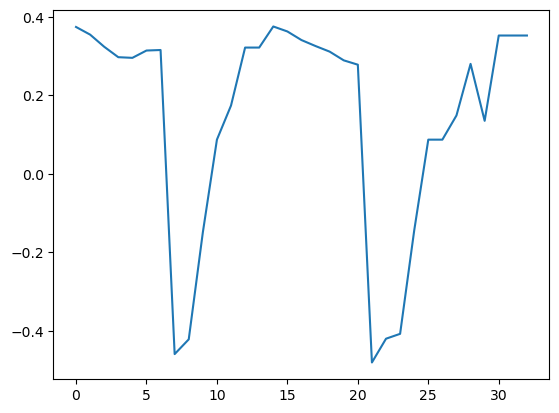

In [21]:
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)

distance_func = ['euclidean', 'manhattan', 'cosine']
Linkages = ['average', 'single']
distance_thresholds = [0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2]


silhouette = []

for distance in distance_func:
    
    for linkage_type in Linkages:
        
        for dist_thresh in distance_thresholds:
        

            model = AgglomerativeClustering(n_clusters=None, metric=distance, linkage=linkage_type, distance_threshold=dist_thresh)

            model.fit(Multi_blob_Data)
            
            if distance == 'manhattan':
                metric = 'cityblock'
            else:
                metric = distance

            linkage_matrix = linkage(Multi_blob_Data, method=linkage_type, metric=metric)
            
            if len(np.unique(model.labels_)) > 1:
            
                silhouette_avg = silhouette_score(Multi_blob_Data, model.labels_)
                silhouette.append(silhouette_avg)

                dendrogram(linkage_matrix, truncate_mode="level", p=5)  # You can adjust 'p' to control the number of clusters
                plt.title('Dendrogram')
                plt.xlabel('Data points')
                plt.ylabel('Distance')
                plt.show()
                
                print("number of clusters", model.n_clusters_)
                plt.figure()
                display_cluster(Multi_blob_Data, km=model, num_clusters=model.n_clusters_)
                
print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(silhouette)            

# plt.figure()
# display_cluster(Multi_blob_Data, km=model ,num_clusters=model.n_clusters_)

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

number of clusters:  11


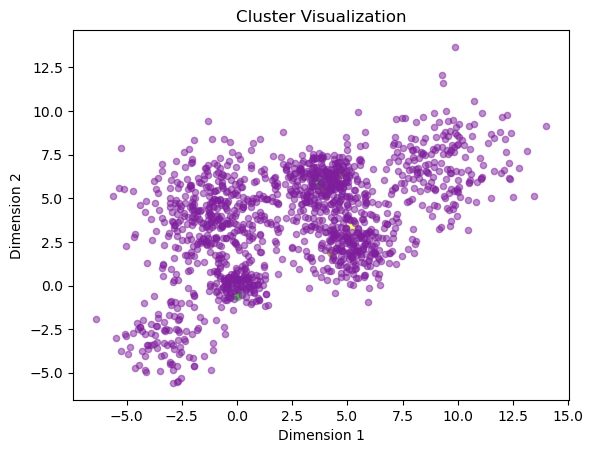

number of clusters:  10


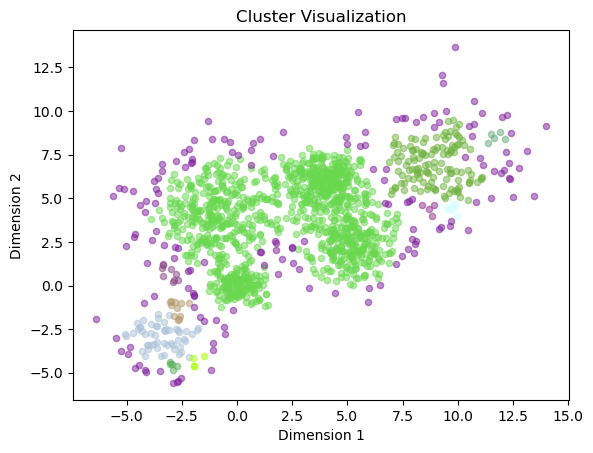

number of clusters:  6


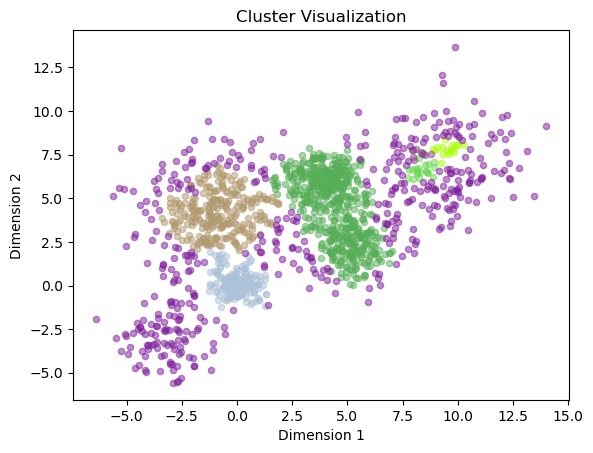

number of clusters:  4


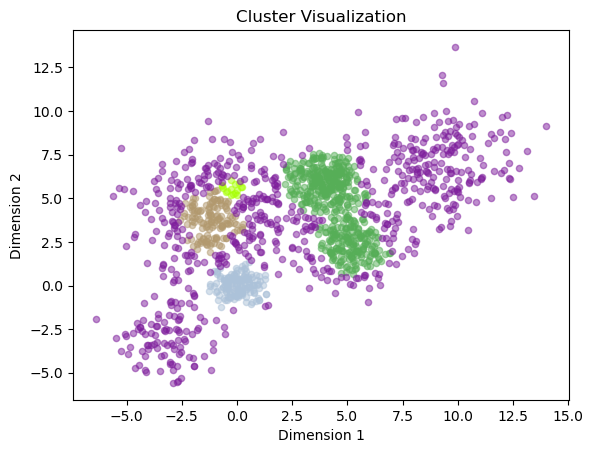

number of clusters:  5


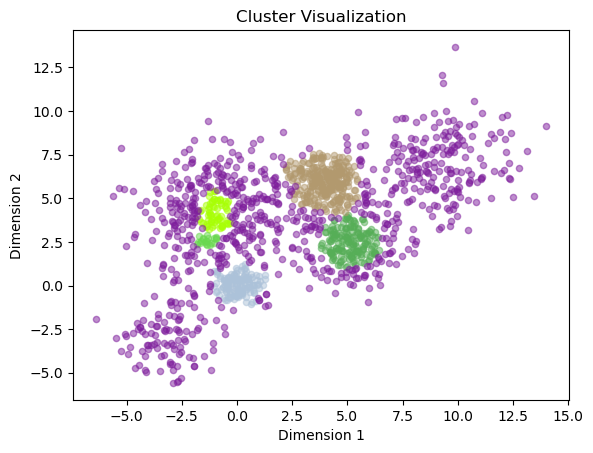

number of clusters:  4


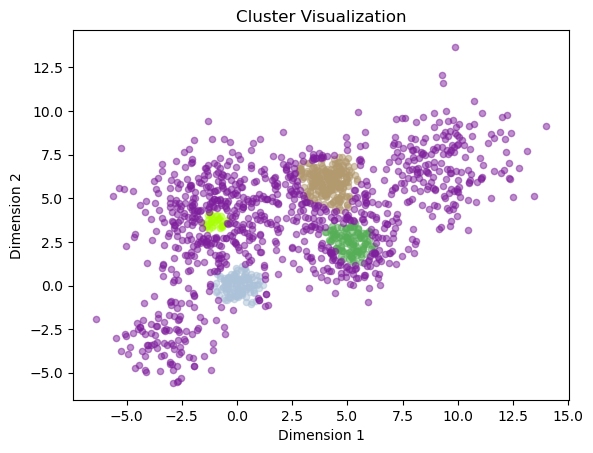

number of clusters:  1


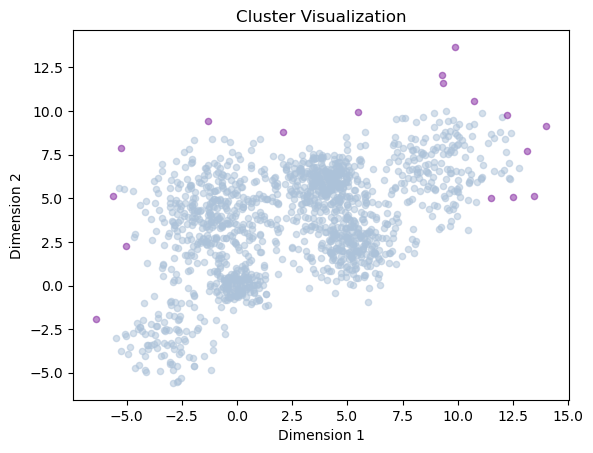

number of clusters:  2


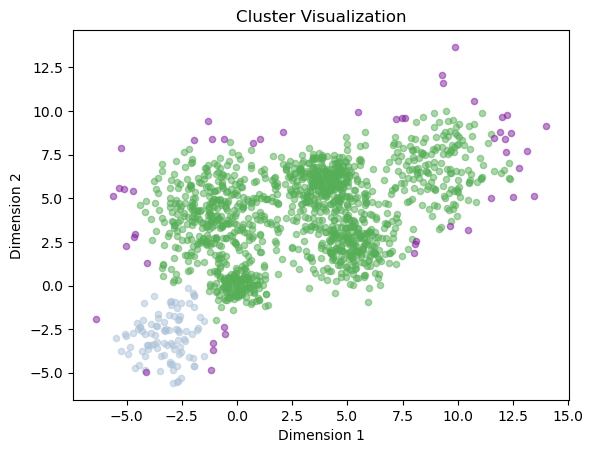

number of clusters:  3


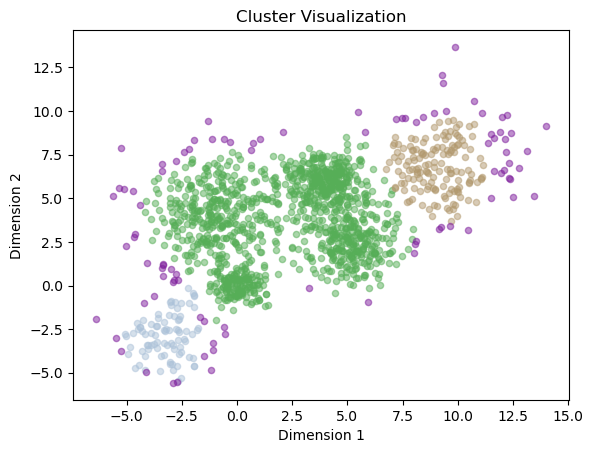

number of clusters:  3


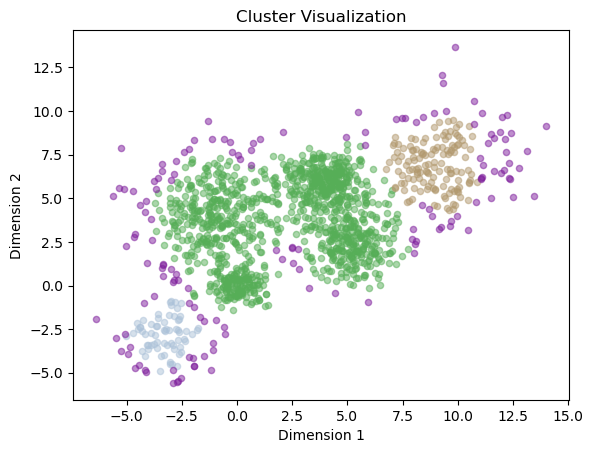

number of clusters:  3


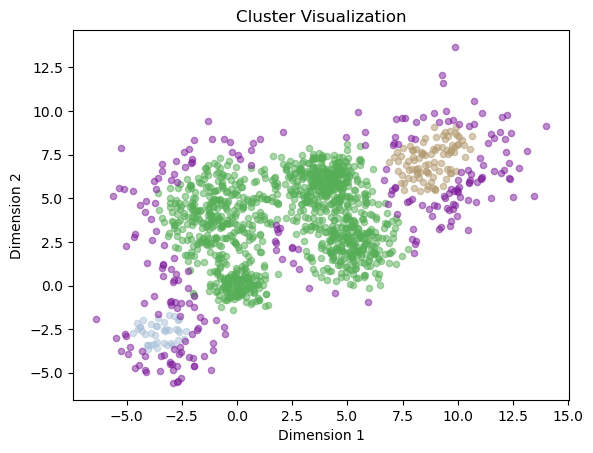

number of clusters:  1


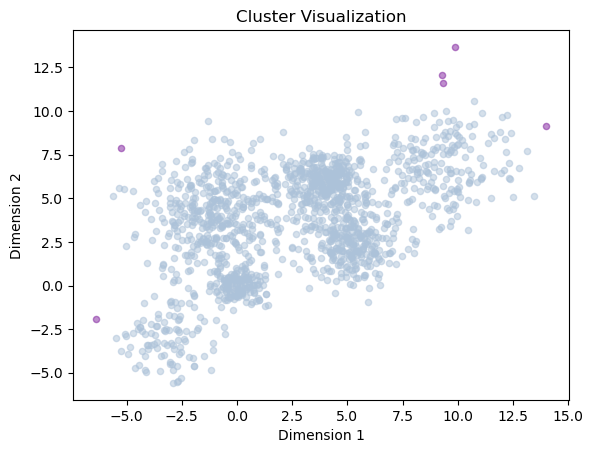

number of clusters:  1


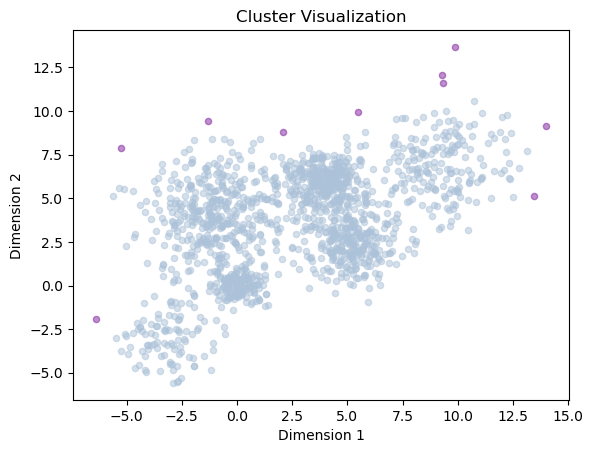

number of clusters:  1


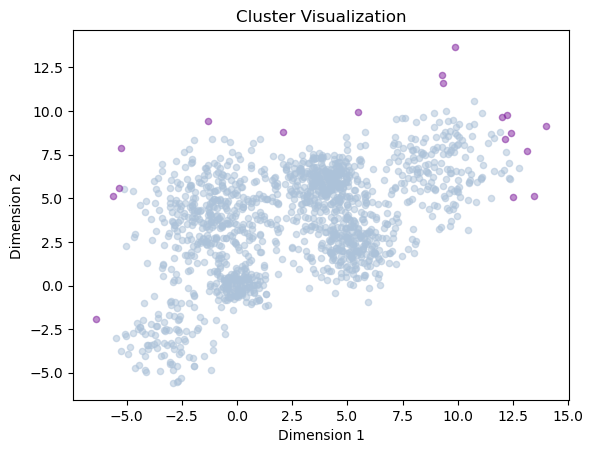

number of clusters:  1


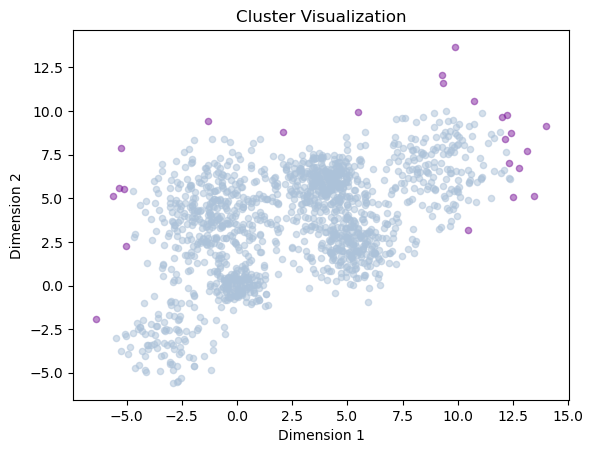

number of clusters:  1


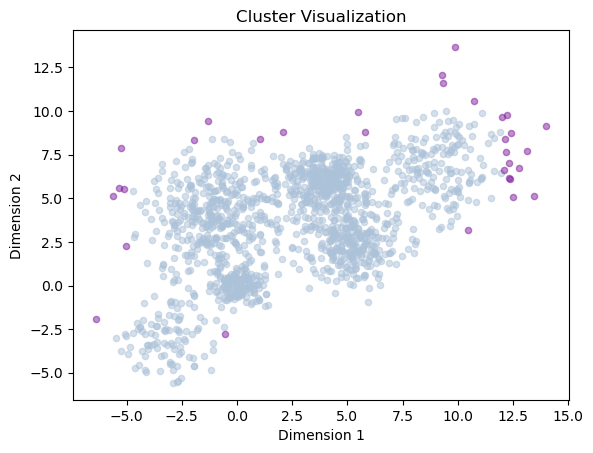

number of clusters:  1


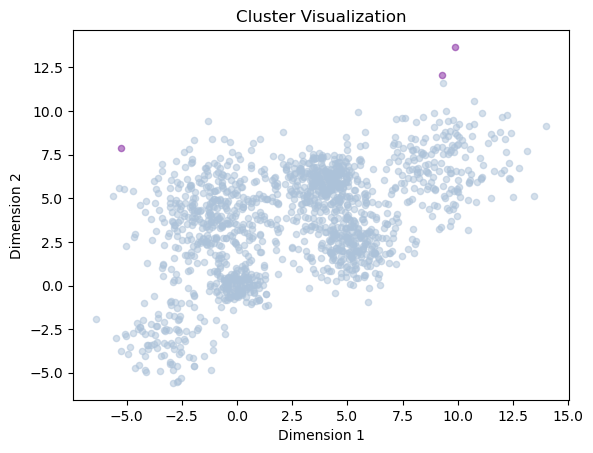

number of clusters:  1


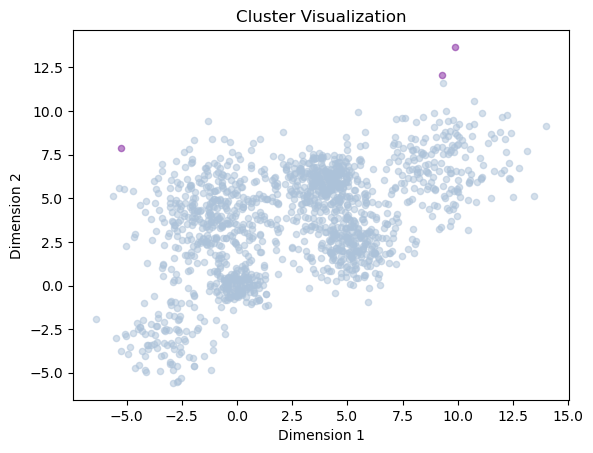

number of clusters:  1


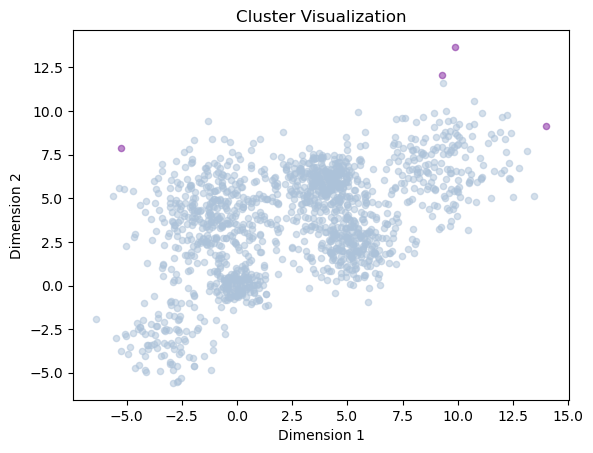

number of clusters:  1


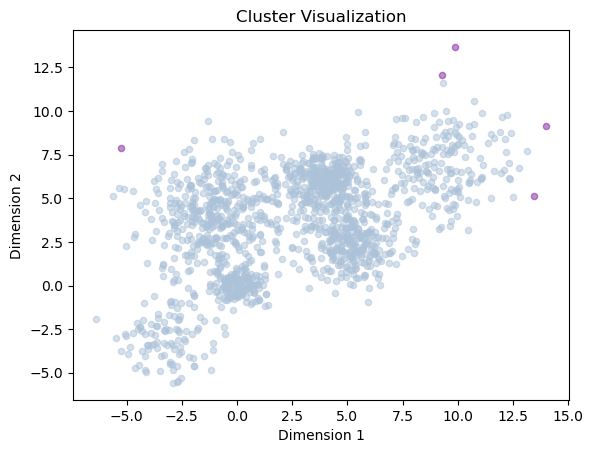

number of clusters:  1


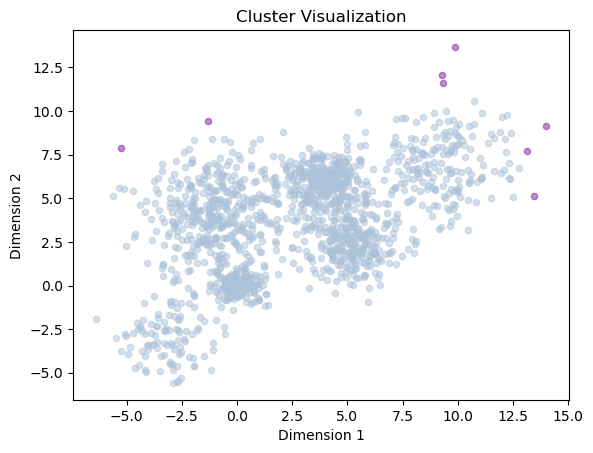

number of clusters:  1


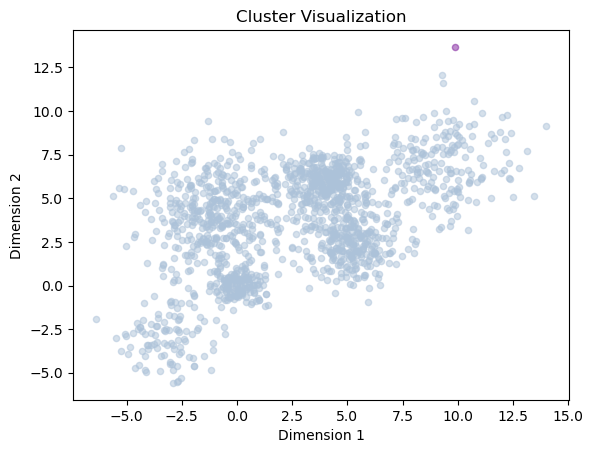

number of clusters:  1


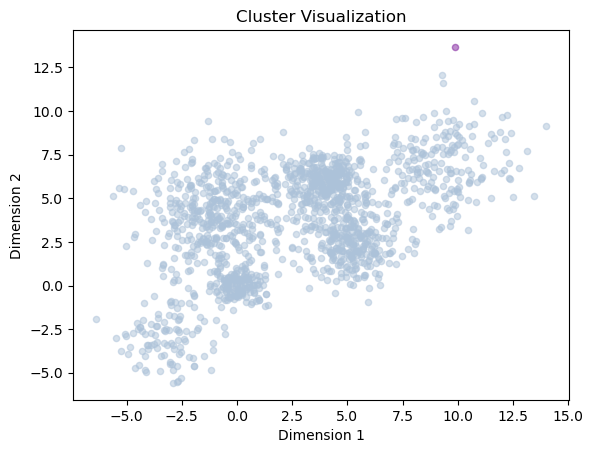

number of clusters:  1


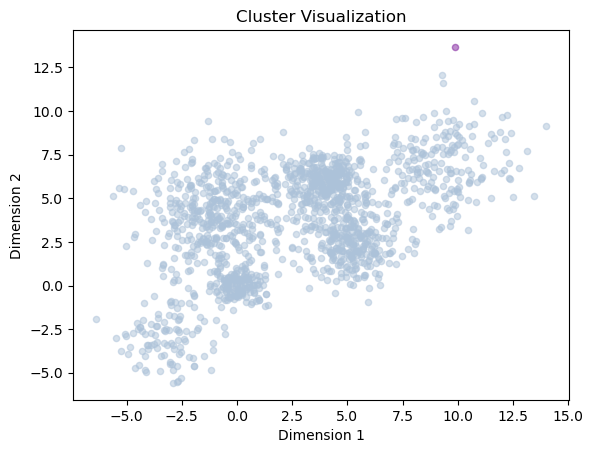

number of clusters:  1


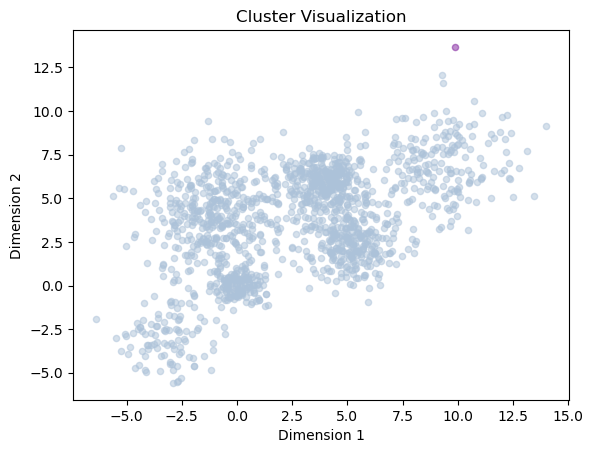

number of clusters:  1


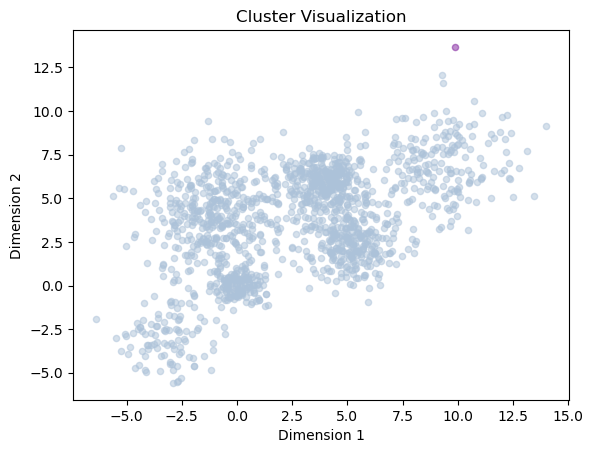

number of clusters:  1


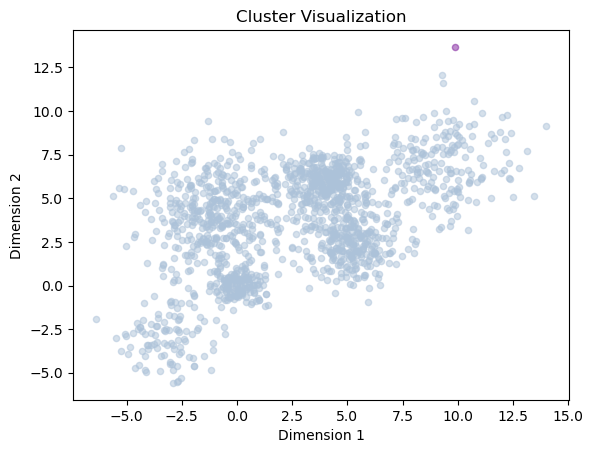

number of clusters:  1


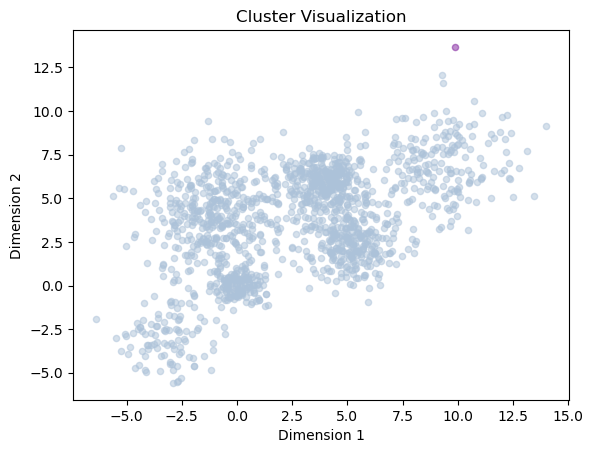

number of clusters:  1


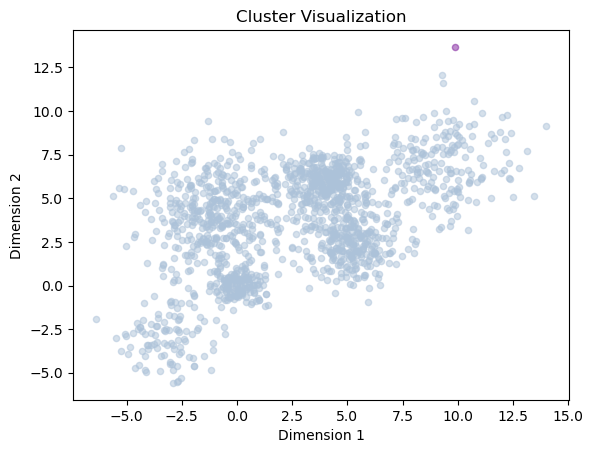

maximum silhouette score:  0.4685207355522043


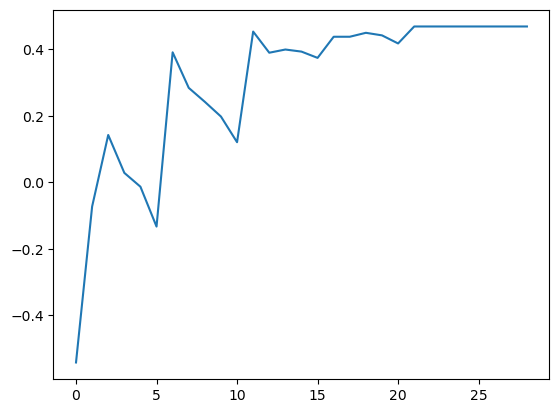

In [10]:
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)

EPS = np.arange(0.1, 3.1, 0.4)
min_samples = np.arange(5, 26, 5)

silhouette = []

for eps in EPS:
    
    for min_samp in min_samples:

        dbscan = DBSCAN(eps=eps, min_samples=min_samp)  # Adjust eps and min_samples as needed

        # Fit the model to the data
        dbscan.fit(Multi_blob_Data)

        # Get cluster labels for each data point
        cluster_labels = dbscan.labels_

        # Identify the number of clusters (excluding noise)
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)

        if len(np.unique(cluster_labels)) > 1:
            
            silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
            silhouette.append(silhouette_avg)
            
            print("number of clusters: ", n_clusters)
            
            plt.figure()
            display_cluster(Multi_blob_Data, km=dbscan, num_clusters=n_clusters)
            
print("maximum silhouette score: ", max(silhouette))
        
plt.figure()
plt.plot(silhouette)

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

maximum silhouette score:  0.48567327695888446
best parameters:  (6, 'tied')


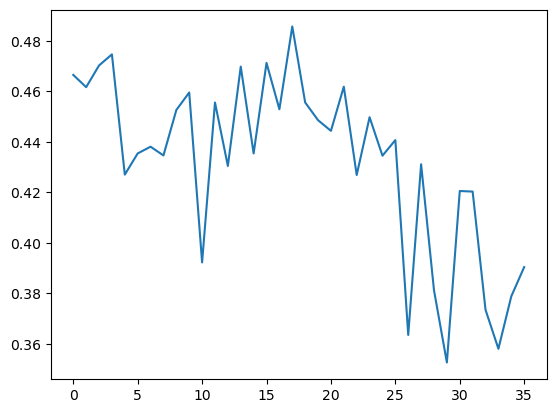

<Figure size 800x600 with 0 Axes>

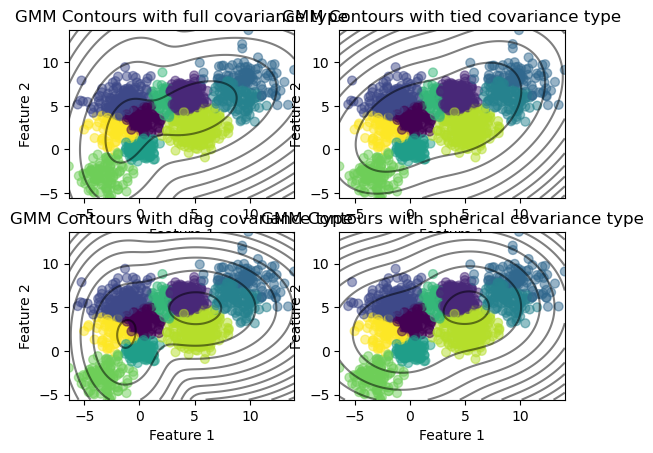

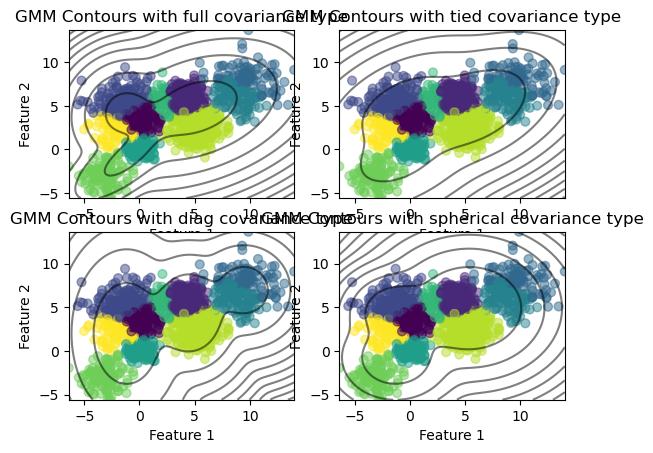

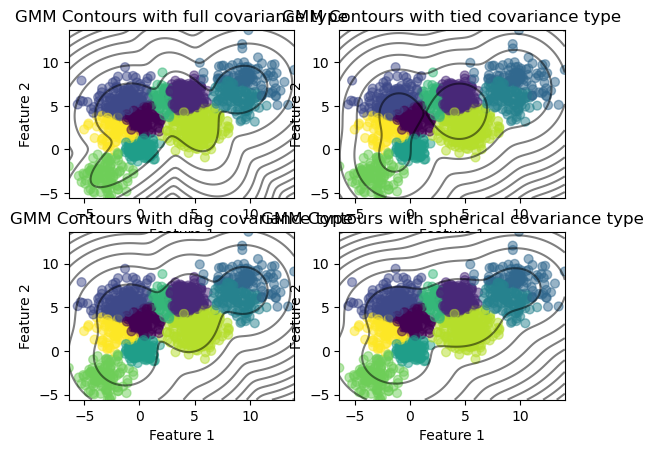

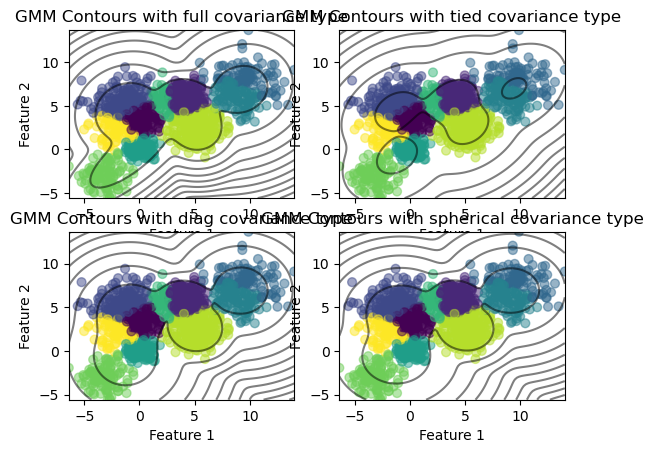

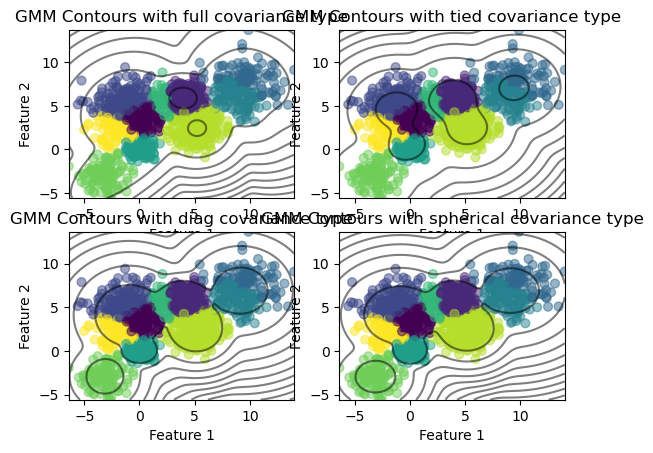

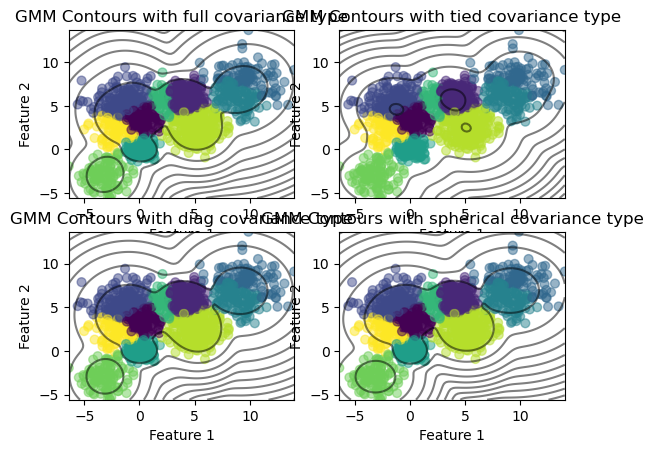

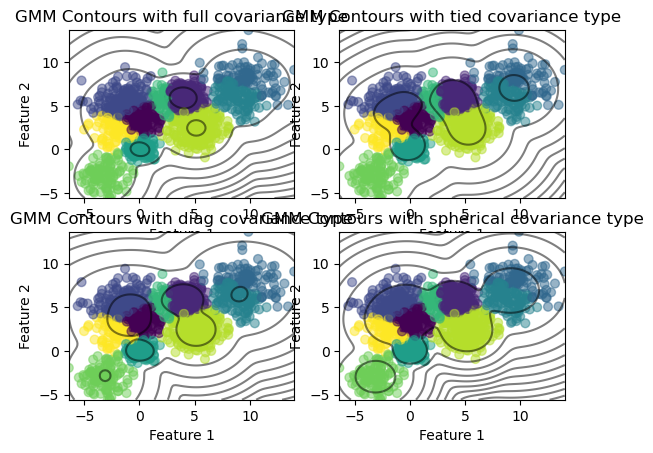

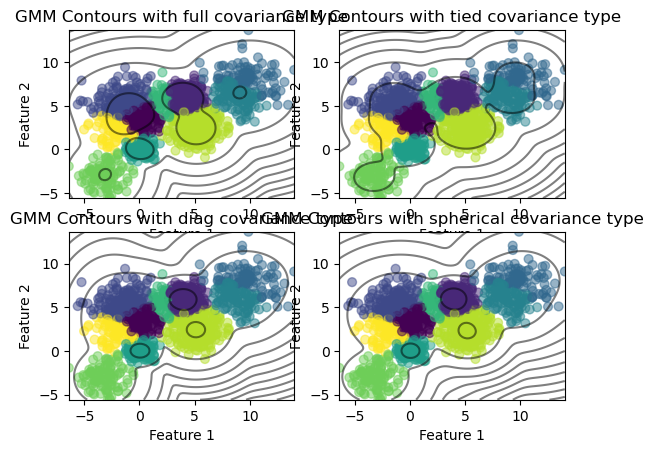

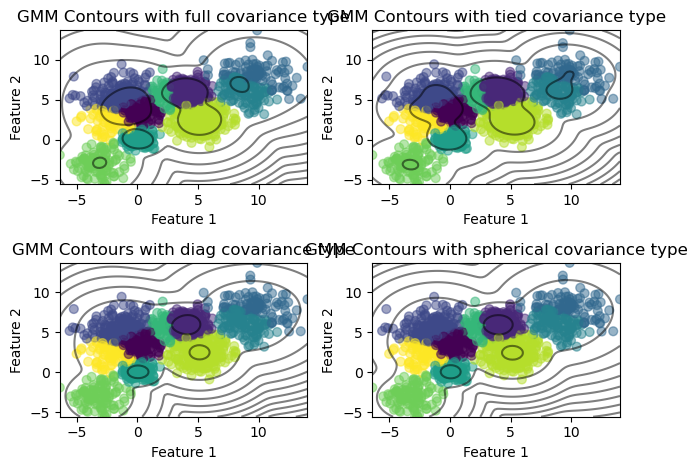

In [12]:
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)

silhouette = []
covariance_types = ['full', 'tied', 'diag', 'spherical']
param = []

for n in range(2, 11):
    for covariance_type in covariance_types:

        gmm = GaussianMixture(n_components=n, covariance_type=covariance_type)
        gmm.fit(Multi_blob_Data)
        labels = gmm.predict(Multi_blob_Data)
        probs = gmm.predict_proba(Multi_blob_Data)

        silhouette_avg = silhouette_score(Multi_blob_Data, labels)
        silhouette.append(silhouette_avg)
        parameter = (n, covariance_type)
        param.append(parameter)


    #     GMM = kmeans_res(labels)

        log_likelihoods = gmm.score_samples(Multi_blob_Data)



print("maximum silhouette score: ", max(silhouette)) 
max_index = silhouette.index(max(silhouette))
best_param = param[max_index]
print("best parameters: ", best_param)
plt.figure()
plt.plot(silhouette)
    
#     plt.figure()
#     display_cluster(Multi_blob_Data, km=GMM, num_clusters=len(labels))


plt.figure(figsize=(8, 6))

x = np.linspace(np.min(Multi_blob_Data[:,0]), np.max(Multi_blob_Data[:,0]), 100)
y = np.linspace(np.min(Multi_blob_Data[:,1]), np.max(Multi_blob_Data[:,1]), 100)
X_mesh, Y_mesh = np.meshgrid(x, y)
XX = np.array([X_mesh.ravel(), Y_mesh.ravel()]).T

for n in range(2, 11):
    plt.figure()
    for i, cov_type in enumerate(covariance_types, 1):
        gmm = GaussianMixture(n_components=n, covariance_type=cov_type)
        gmm.fit(Multi_blob_Data)
        Z = -gmm.score_samples(XX)
        Z = Z.reshape(X_mesh.shape)
        
        plt.subplot(2, 2, i)
        plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, cmap='viridis', s=40, alpha=0.5)
        plt.contour(X_mesh, Y_mesh, Z, levels=10, linewidths=1.5, colors='k', alpha=0.5)
        plt.title(f'GMM Contours with {cov_type} covariance type')
        plt.xlabel('Feature 1')
        plt.ylabel('Feature 2')

plt.tight_layout()
plt.show()

In [46]:
class kmeans_res:
    def __init__(self, labels):
        self.labels_ = labels
        

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [33]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']


['setosa', 'versicolor', 'virginica']

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

<Figure size 640x480 with 0 Axes>

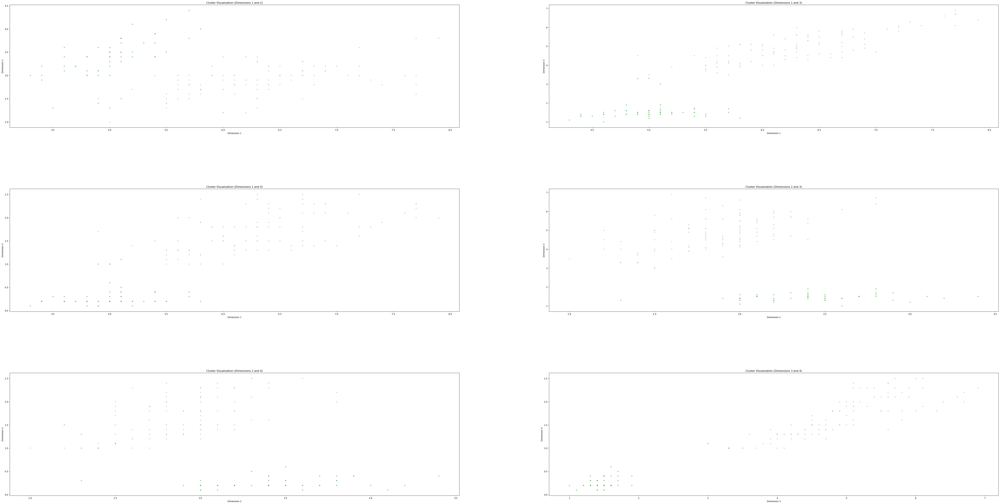

<Figure size 640x480 with 0 Axes>

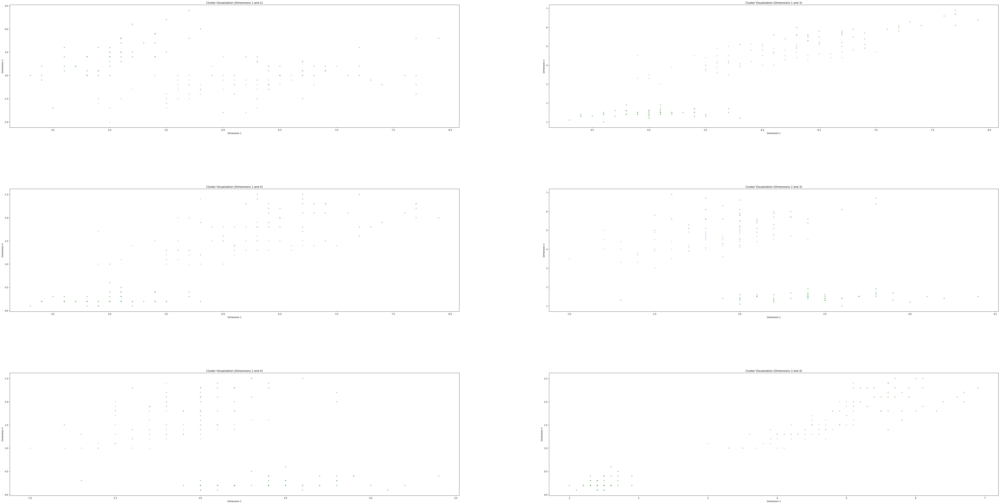

<Figure size 640x480 with 0 Axes>

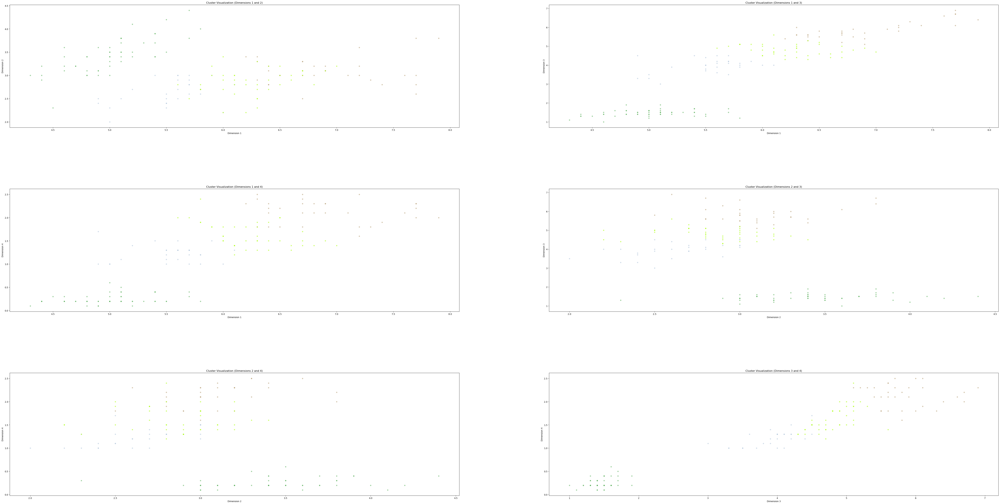

<Figure size 640x480 with 0 Axes>

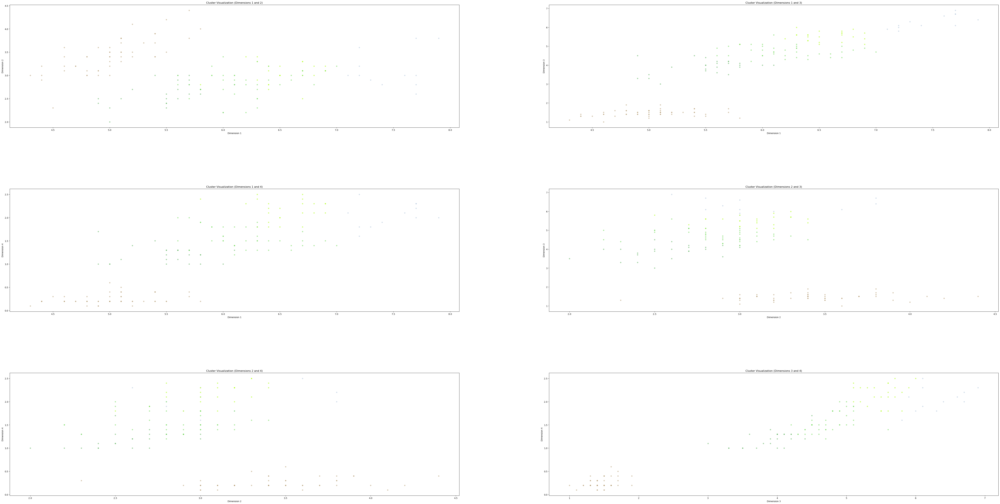

<Figure size 640x480 with 0 Axes>

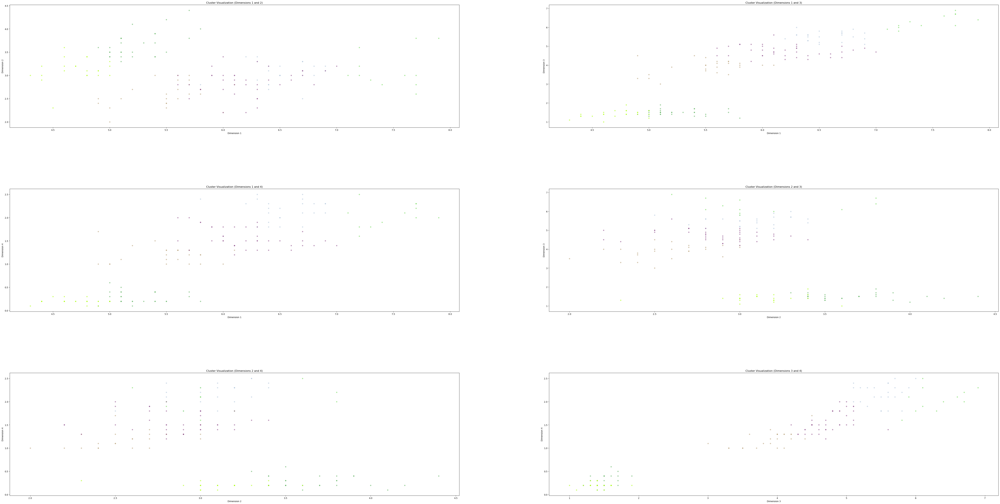

<Figure size 640x480 with 0 Axes>

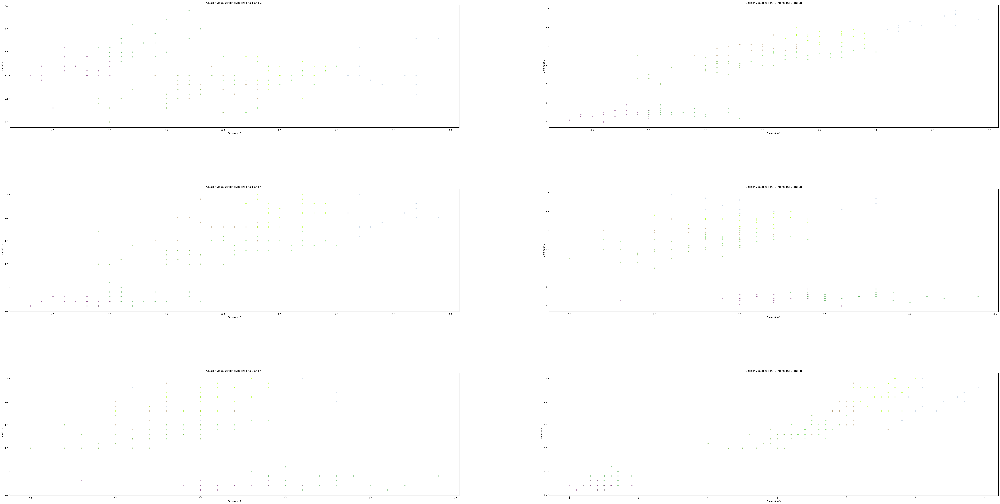

<Figure size 640x480 with 0 Axes>

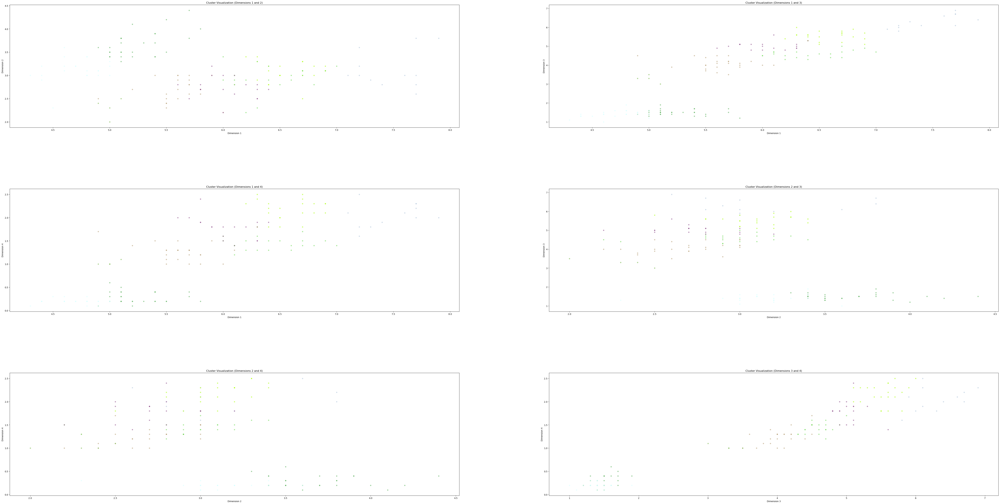

<Figure size 640x480 with 0 Axes>

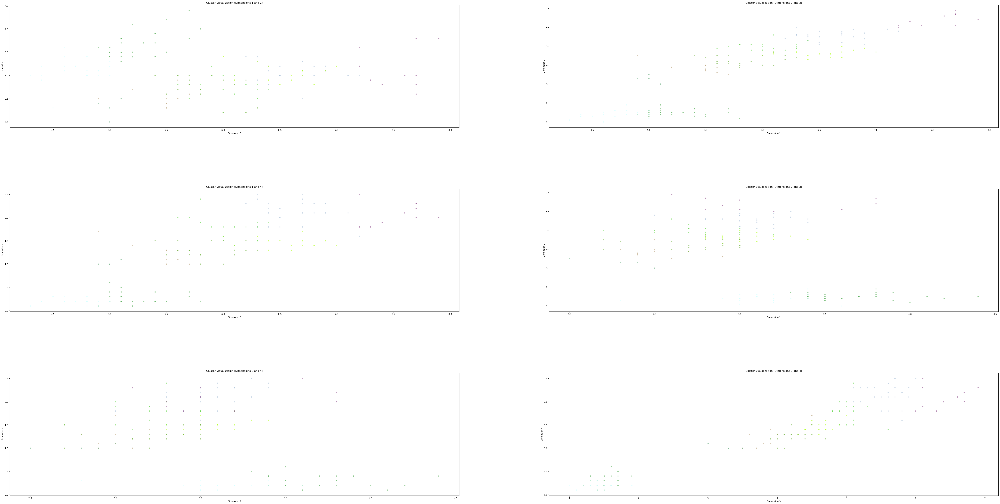

<Figure size 640x480 with 0 Axes>

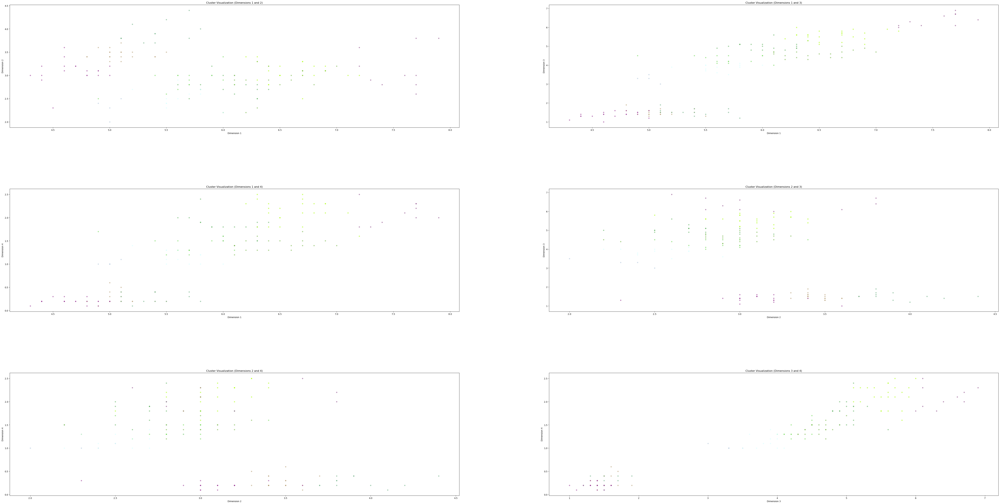

2
maximum silhouette score:  0.6810461692117462


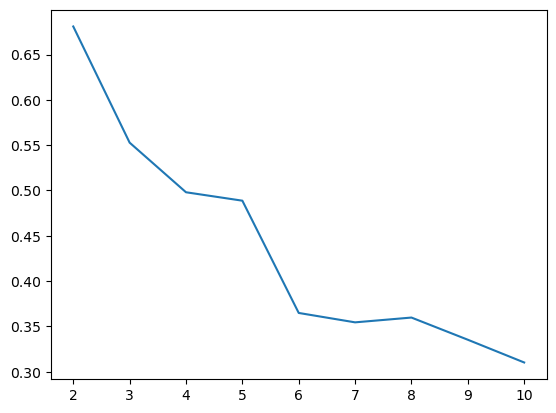

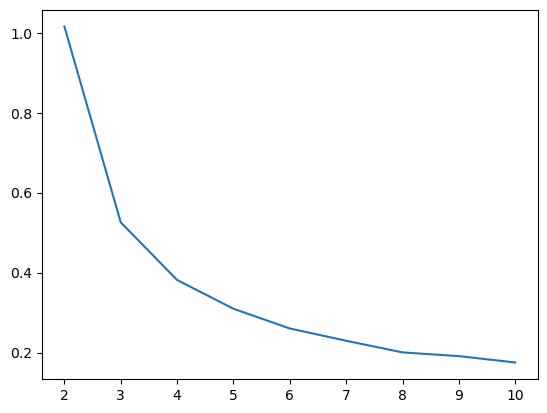

In [13]:
from sklearn.datasets import load_iris
iris_data = load_iris()

data = iris_data.data

silhouette = []
metric = []
for i in range(2, 11):
    
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(data)
    metric.append((kmeans.inertia_) / len(data))
    silhouette_avg = silhouette_score(data, kmeans.labels_)
    silhouette.append(silhouette_avg)

    plt.figure()
    display_cluster(data, km=kmeans,num_clusters=i)
    
    
    
best_cluster = silhouette.index(max(silhouette)) + 2
print(best_cluster)
    
x_axis = np.arange(2, 11)

print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(x_axis, silhouette)

plt.figure()
plt.plot(x_axis, metric)

In [14]:
# from sklearn.datasets import load_iris
# iris_data = load_iris()

# data = iris_data.data
    
# kmeans = KMeans(n_clusters=3)
# kmeans.fit(data)
# metric = (kmeans.inertia_) / len(data)
# silhouette_avg = silhouette_score(data, kmeans.labels_)

# plt.figure()
# display_cluster(data, km=kmeans,num_clusters=3)
    
# print("silhouette score : ", silhouette_avg)

# print("metric : ", metric)

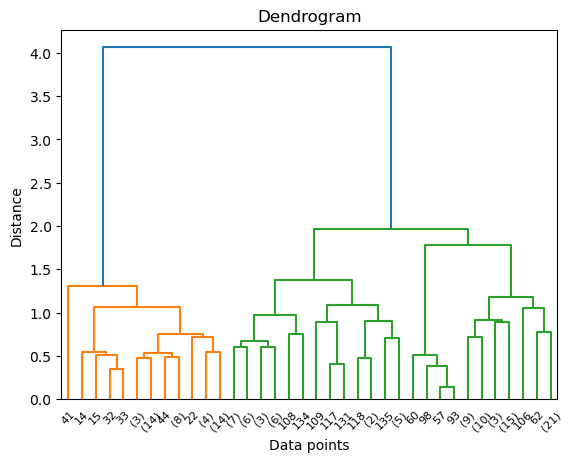

number of clusters 40


<Figure size 640x480 with 0 Axes>

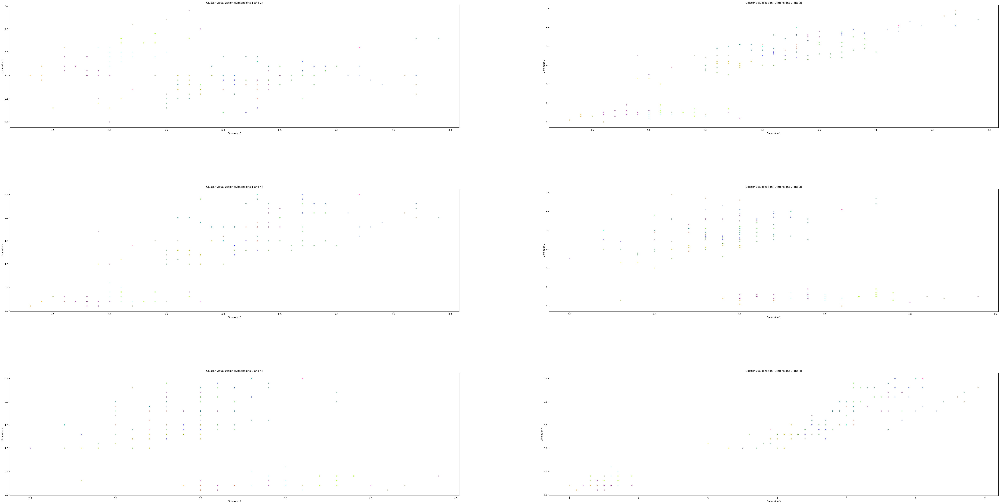

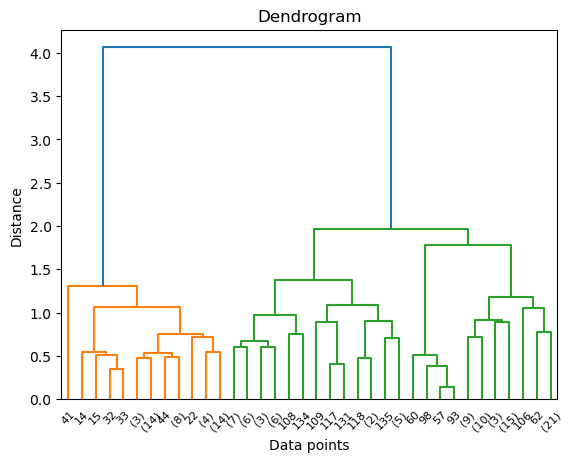

number of clusters 18


<Figure size 640x480 with 0 Axes>

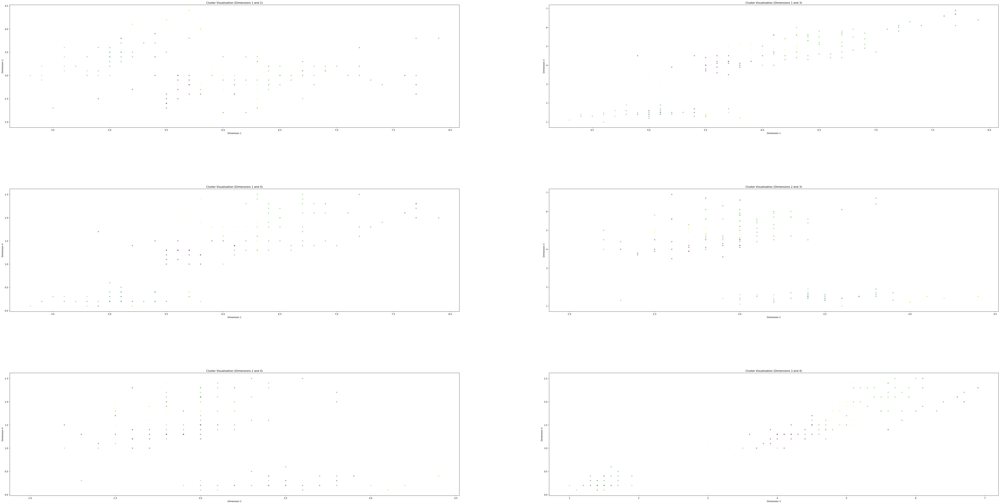

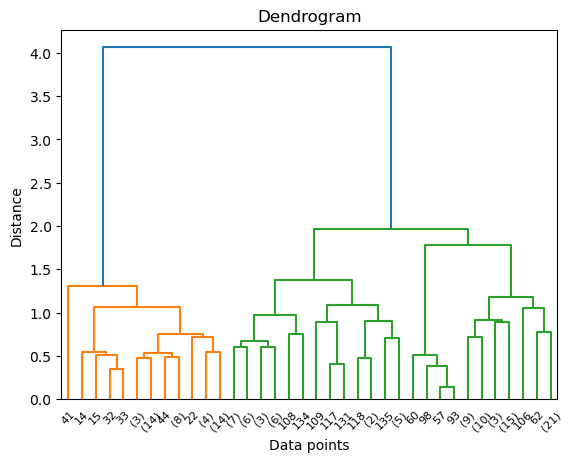

number of clusters 10


<Figure size 640x480 with 0 Axes>

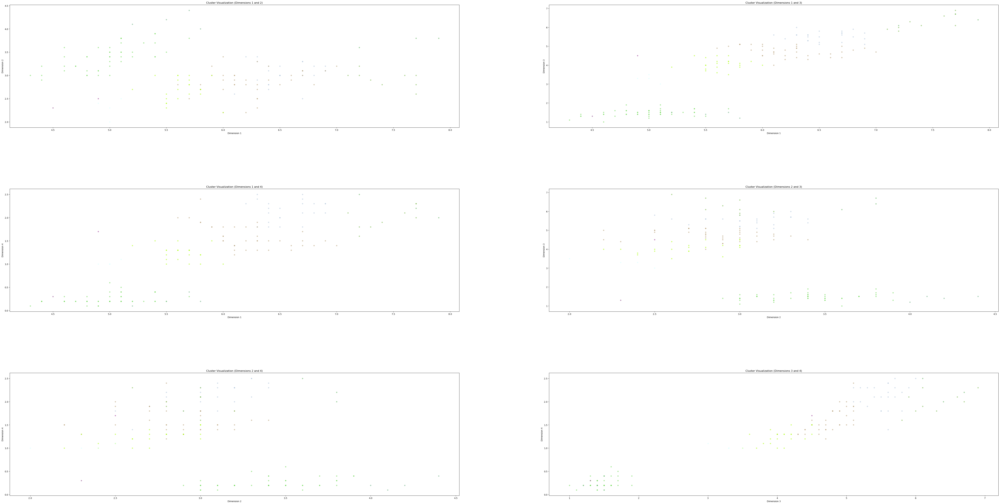

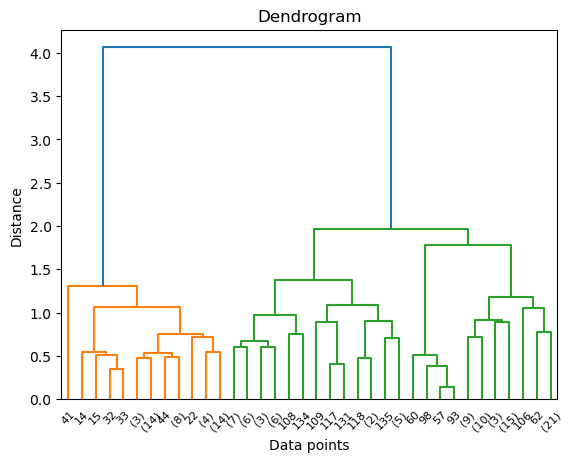

number of clusters 6


<Figure size 640x480 with 0 Axes>

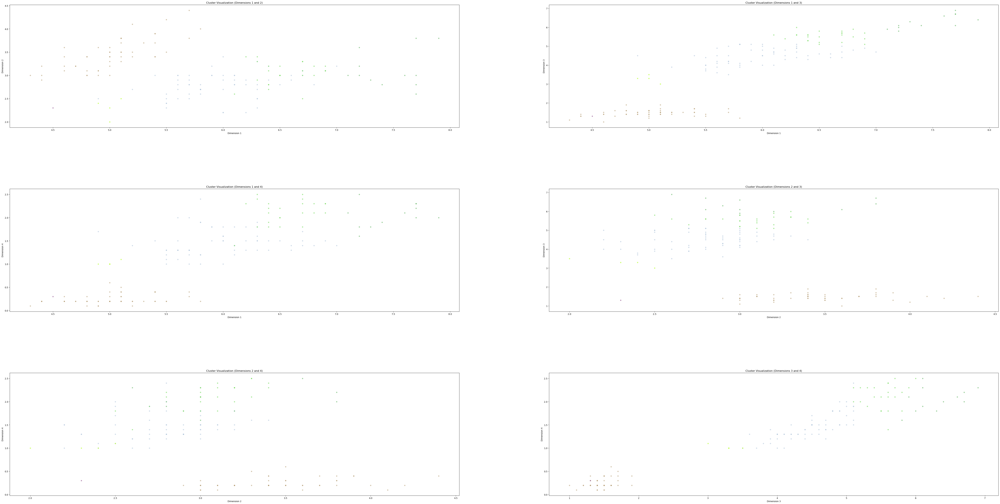

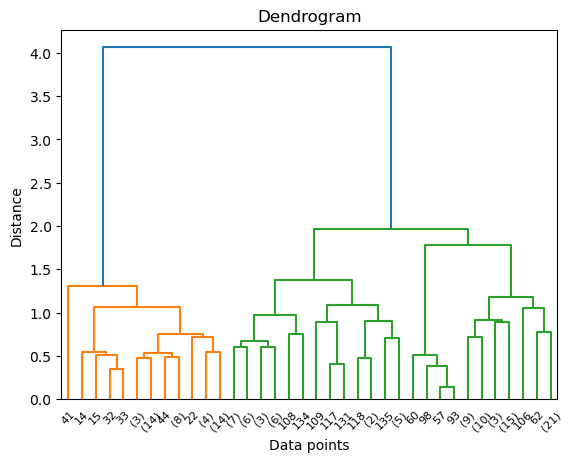

number of clusters 4


<Figure size 640x480 with 0 Axes>

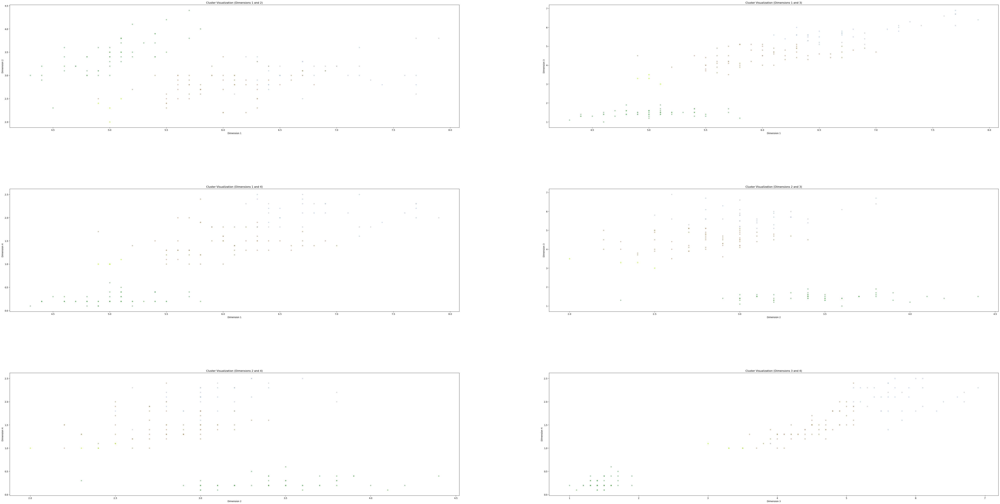

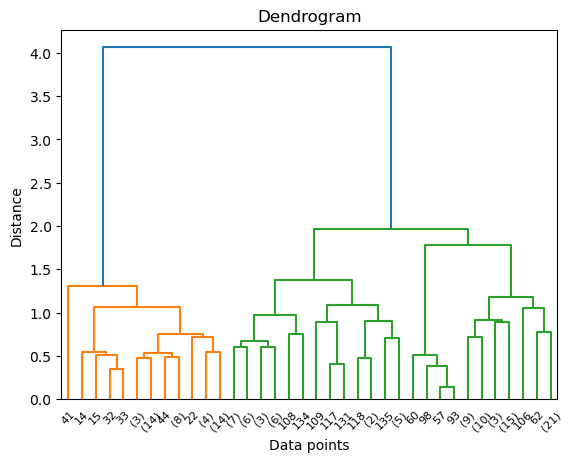

number of clusters 4


<Figure size 640x480 with 0 Axes>

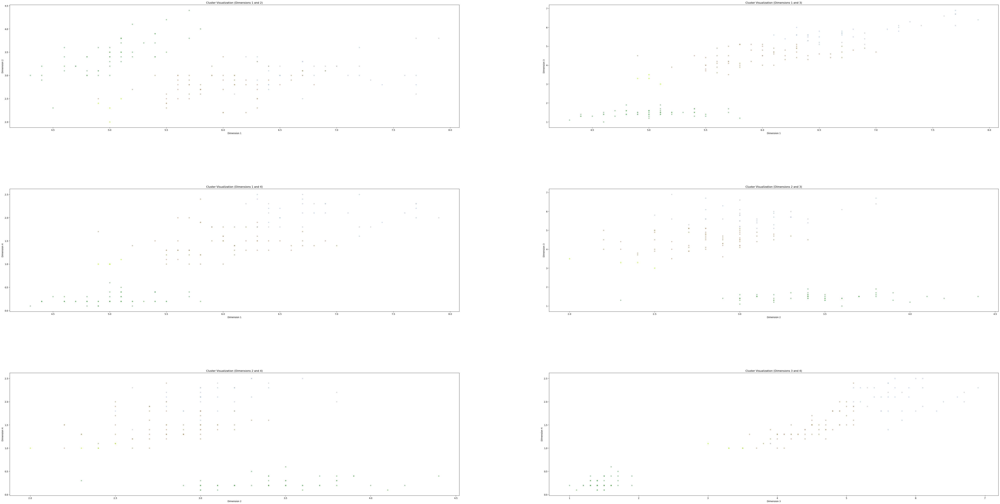

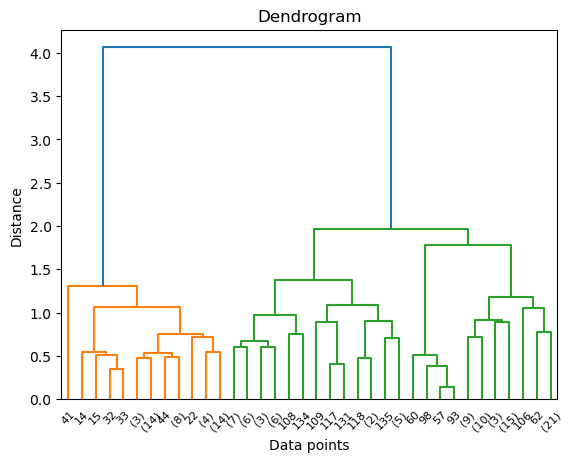

number of clusters 2


<Figure size 640x480 with 0 Axes>

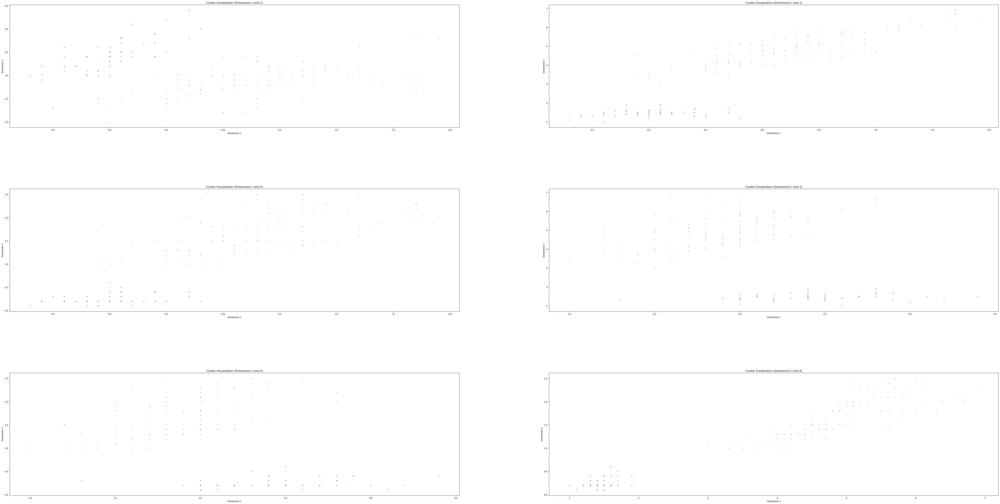

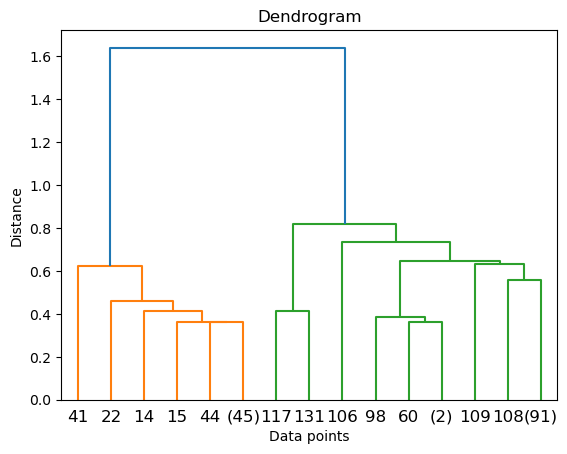

number of clusters 12


<Figure size 640x480 with 0 Axes>

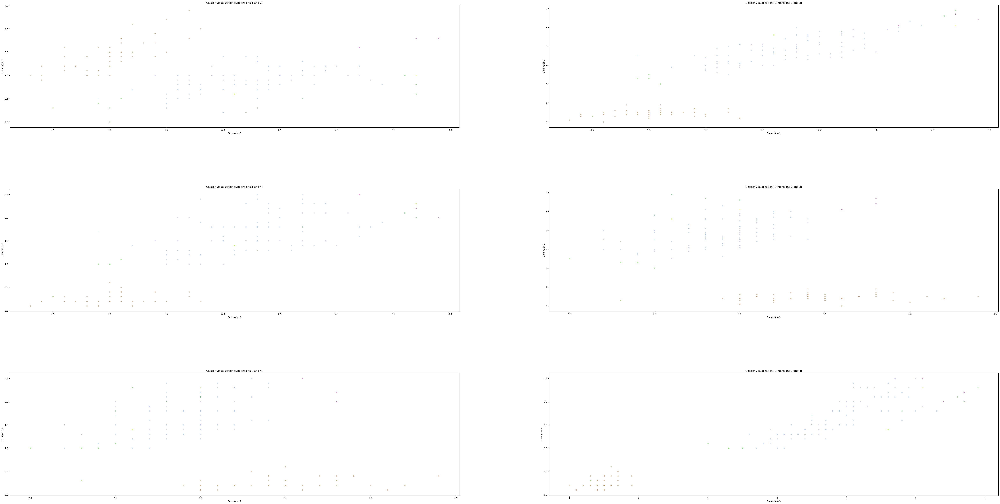

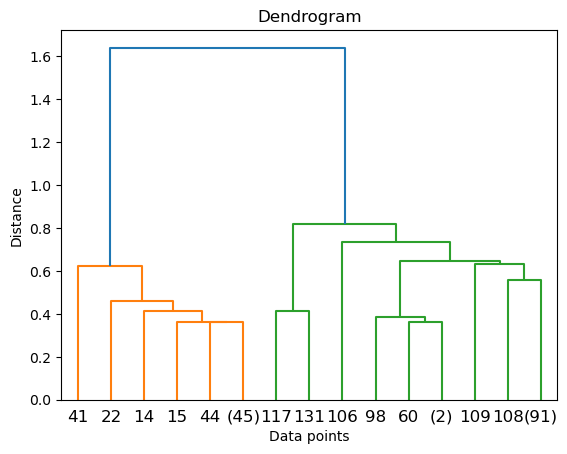

number of clusters 3


<Figure size 640x480 with 0 Axes>

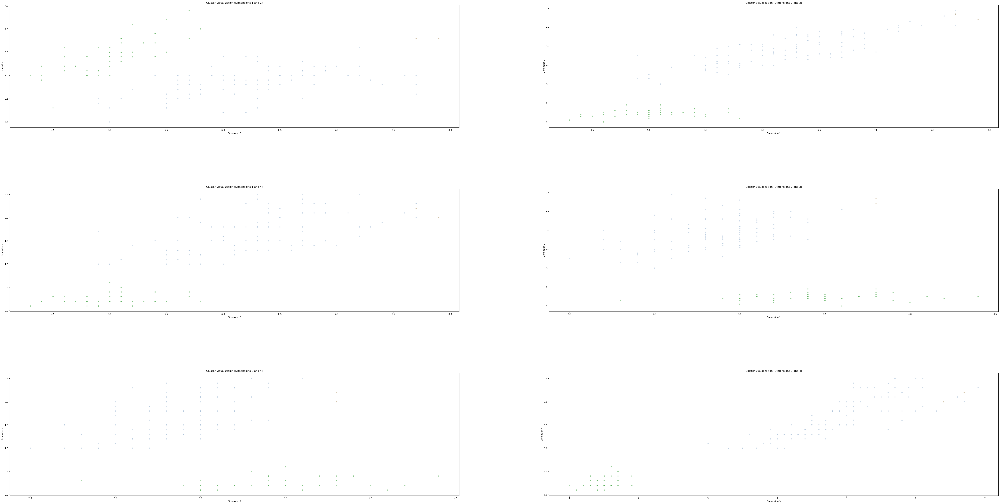

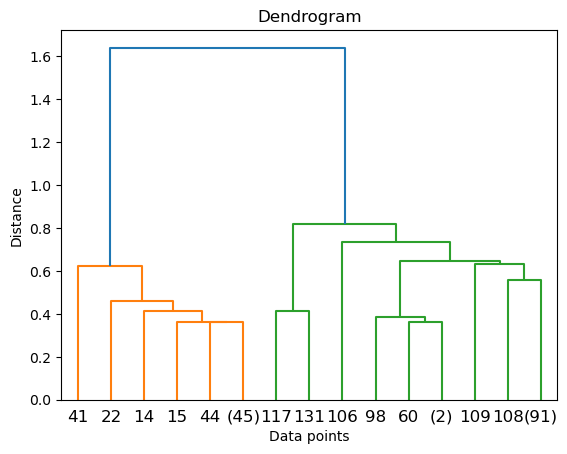

number of clusters 2


<Figure size 640x480 with 0 Axes>

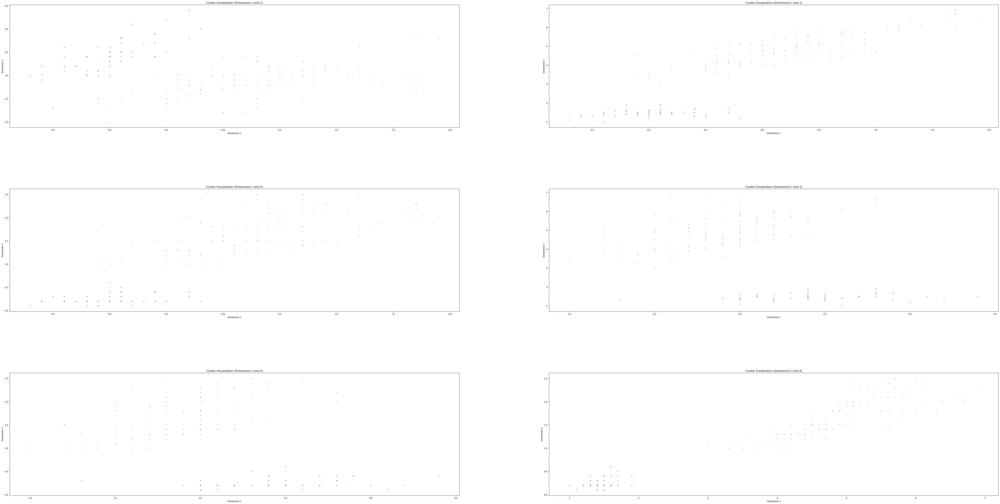

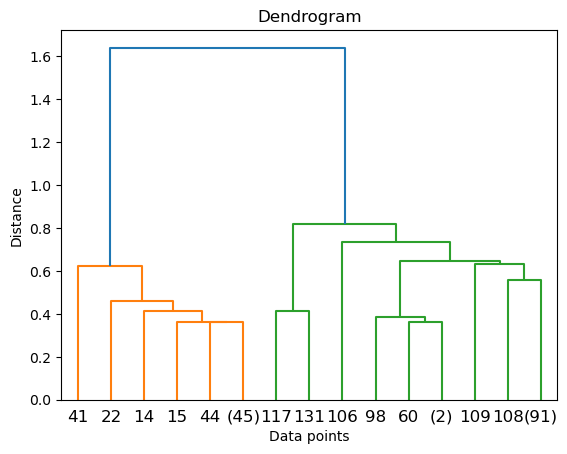

number of clusters 2


<Figure size 640x480 with 0 Axes>

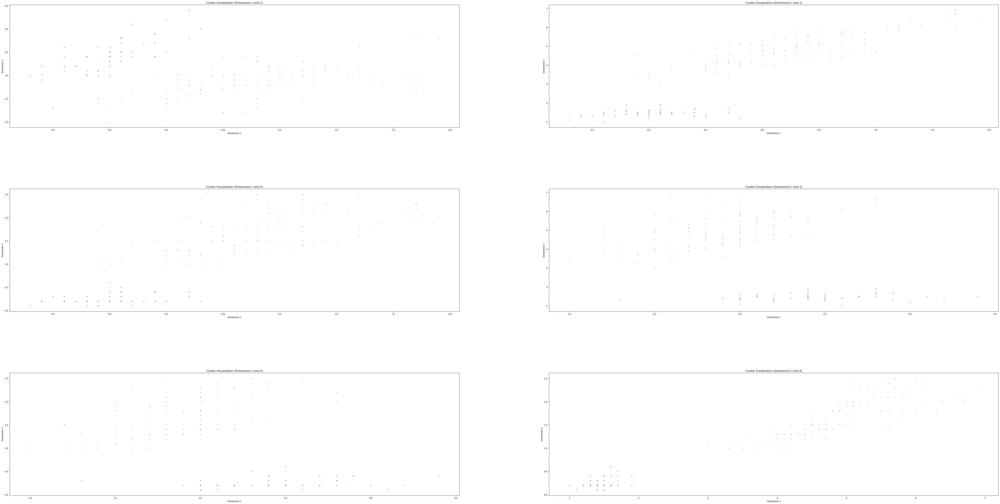

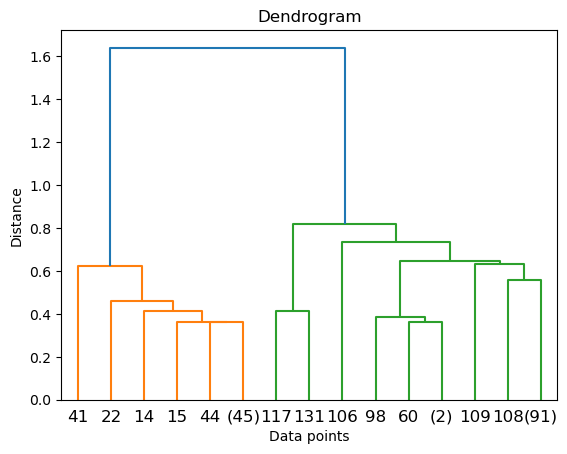

number of clusters 2


<Figure size 640x480 with 0 Axes>

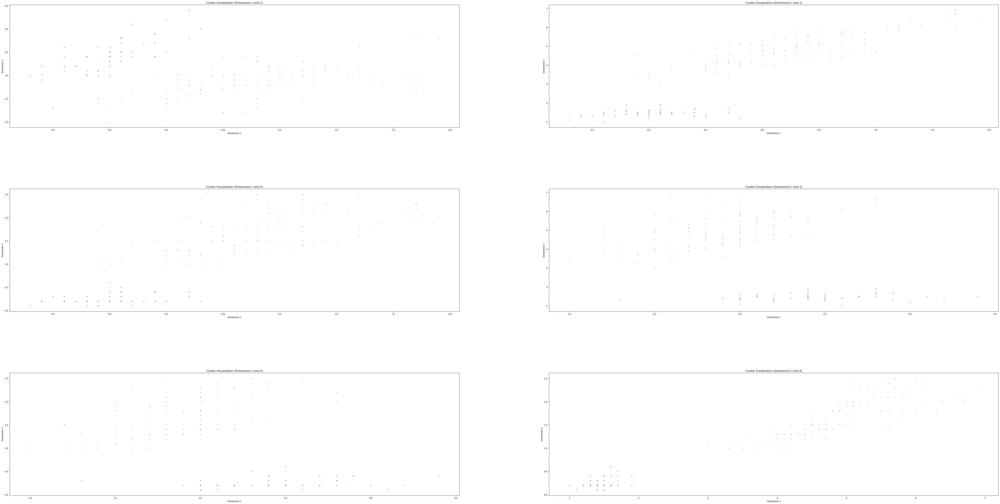

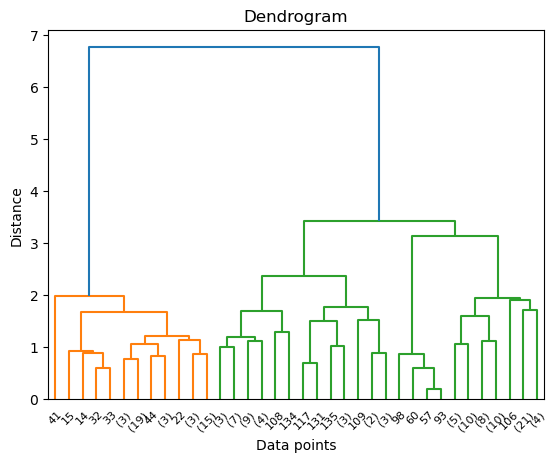

number of clusters 86


<Figure size 640x480 with 0 Axes>

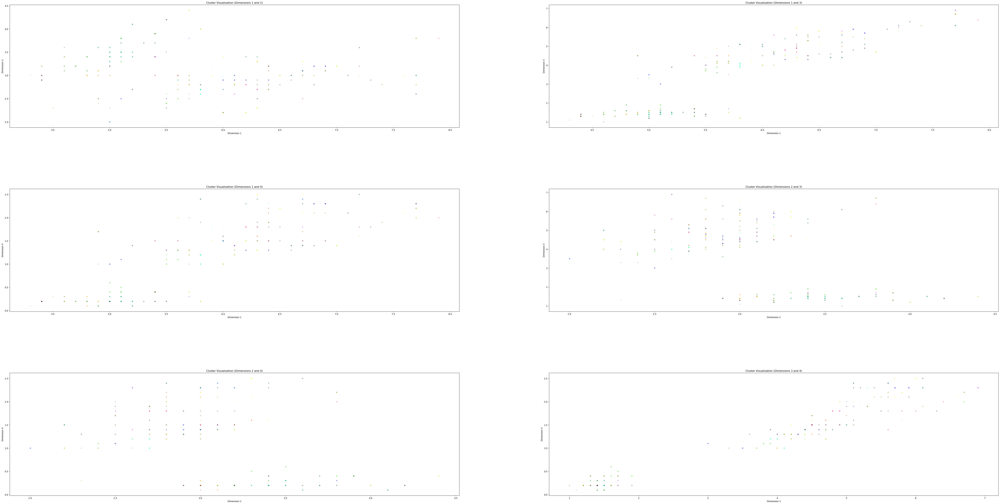

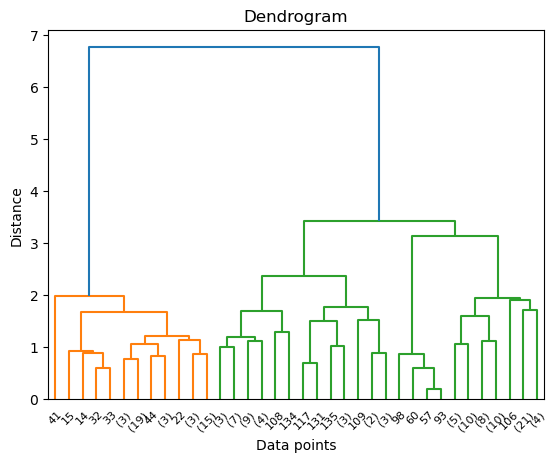

number of clusters 49


<Figure size 640x480 with 0 Axes>

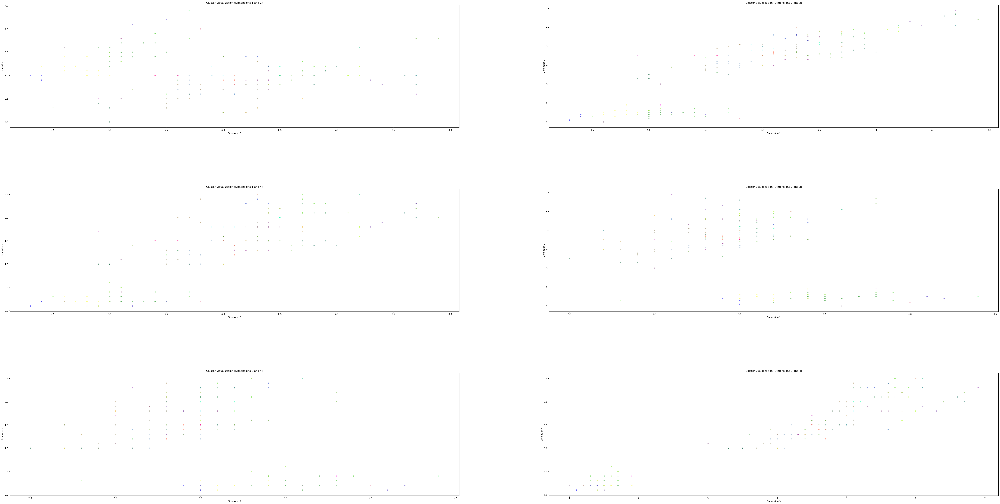

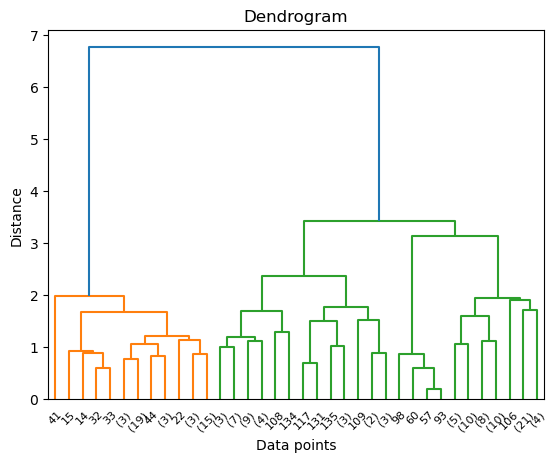

number of clusters 28


<Figure size 640x480 with 0 Axes>

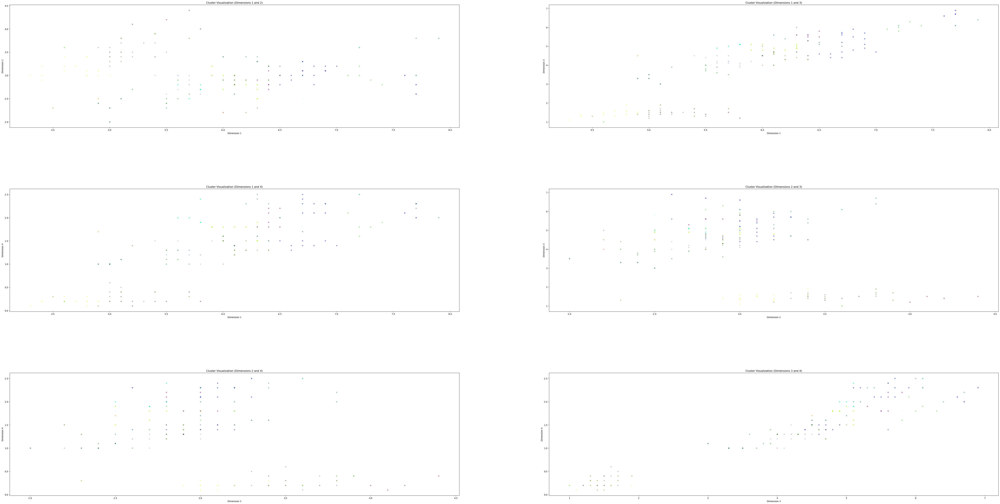

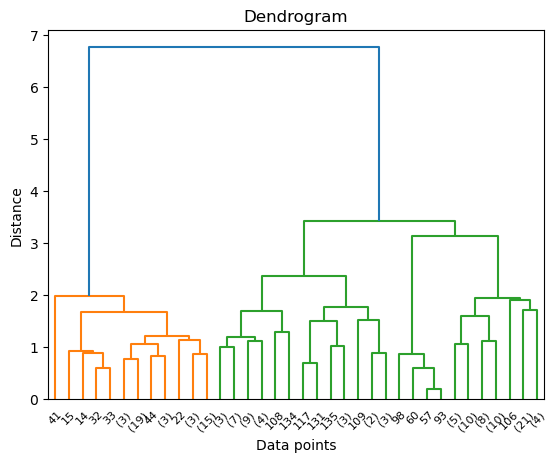

number of clusters 17


<Figure size 640x480 with 0 Axes>

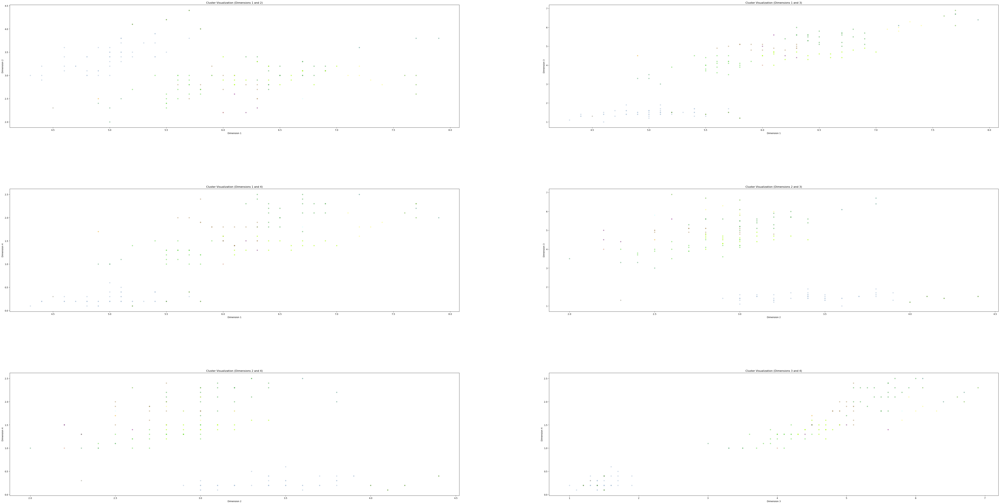

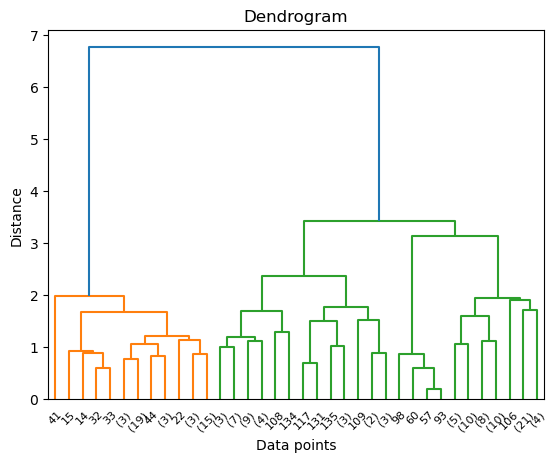

number of clusters 15


<Figure size 640x480 with 0 Axes>

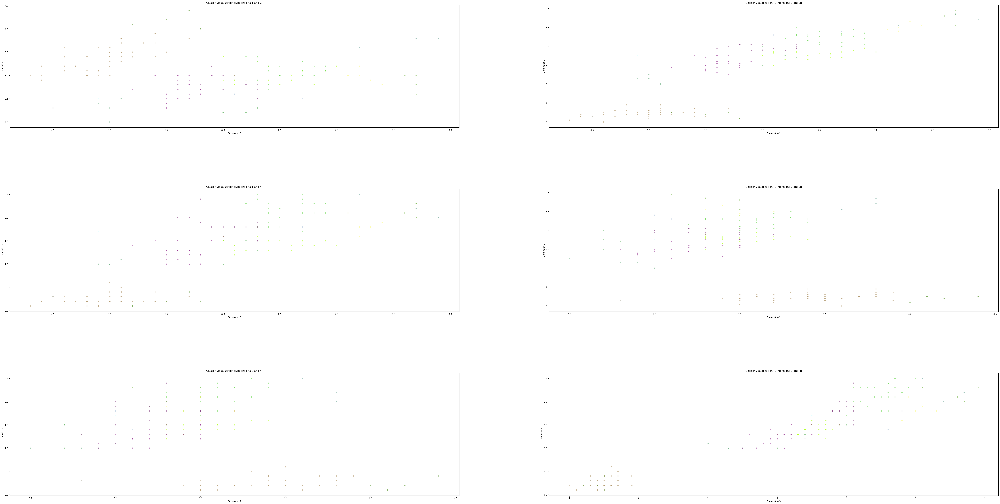

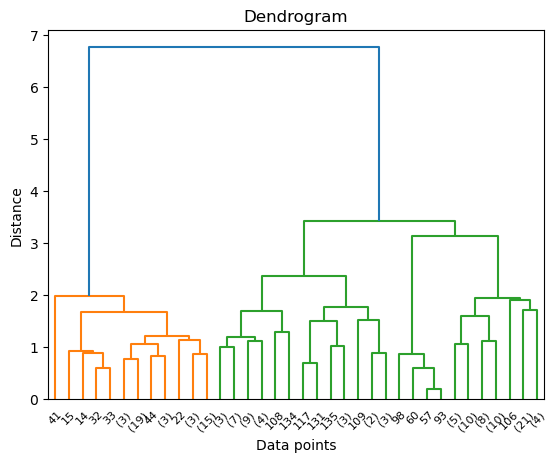

number of clusters 9


<Figure size 640x480 with 0 Axes>

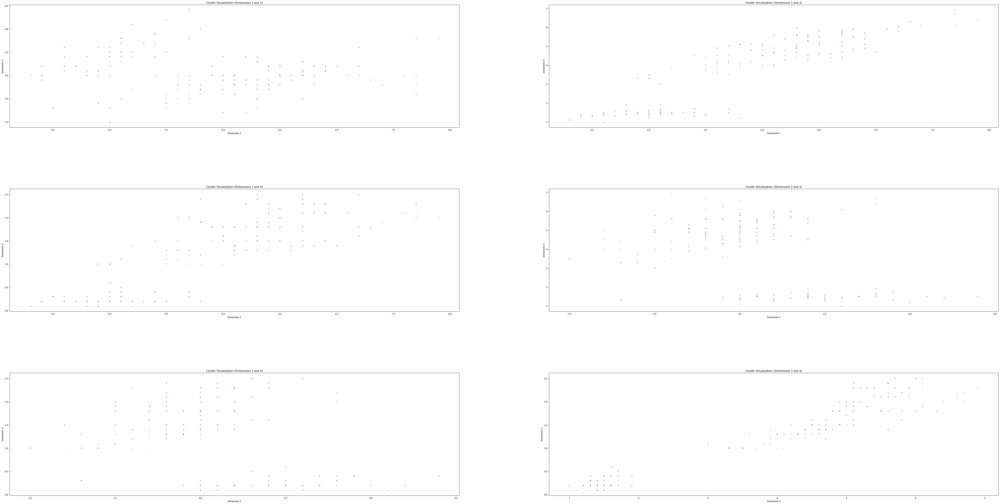

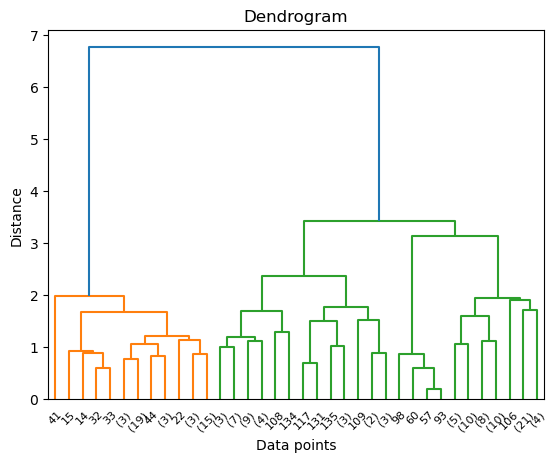

number of clusters 5


<Figure size 640x480 with 0 Axes>

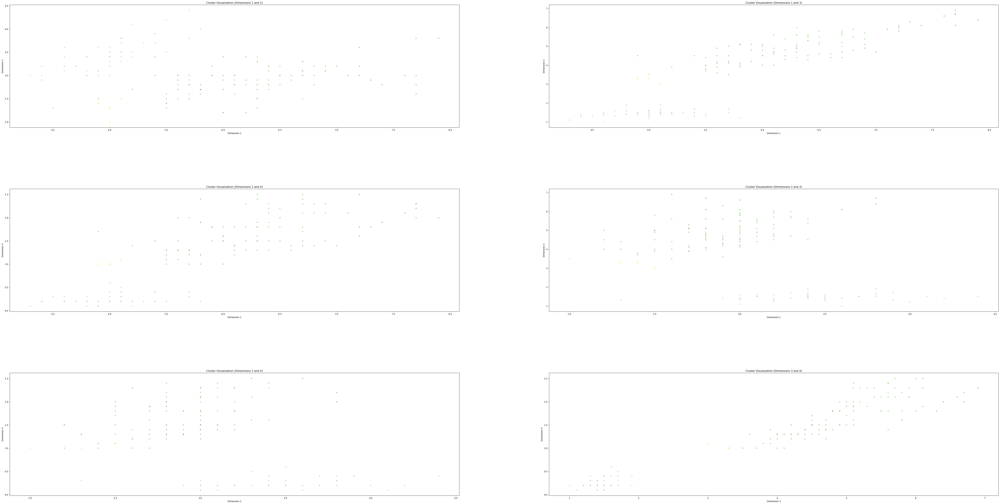

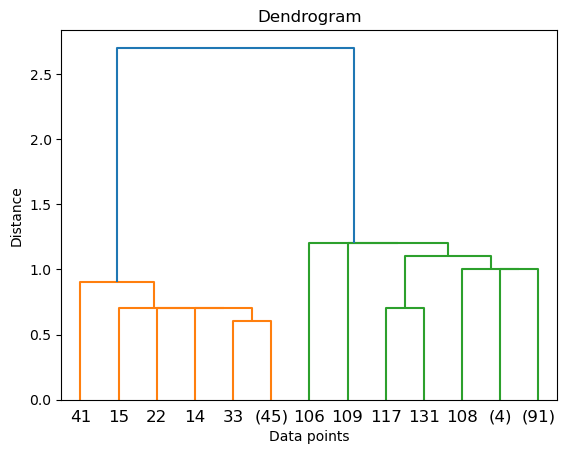

number of clusters 59


<Figure size 640x480 with 0 Axes>

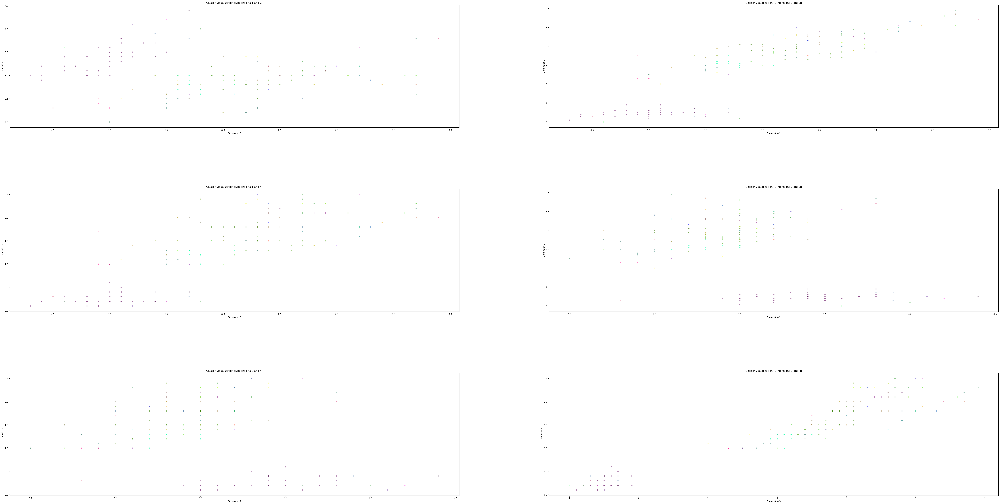

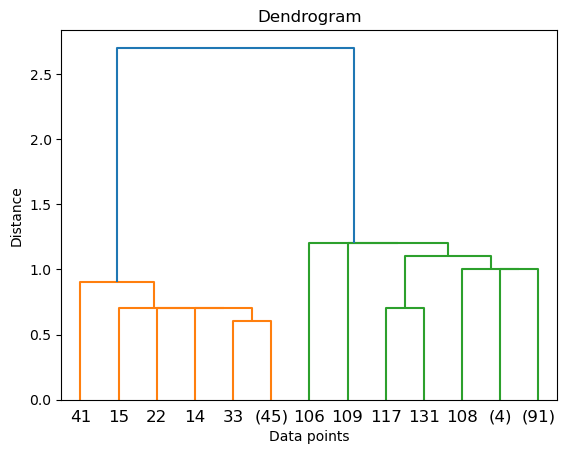

number of clusters 12


<Figure size 640x480 with 0 Axes>

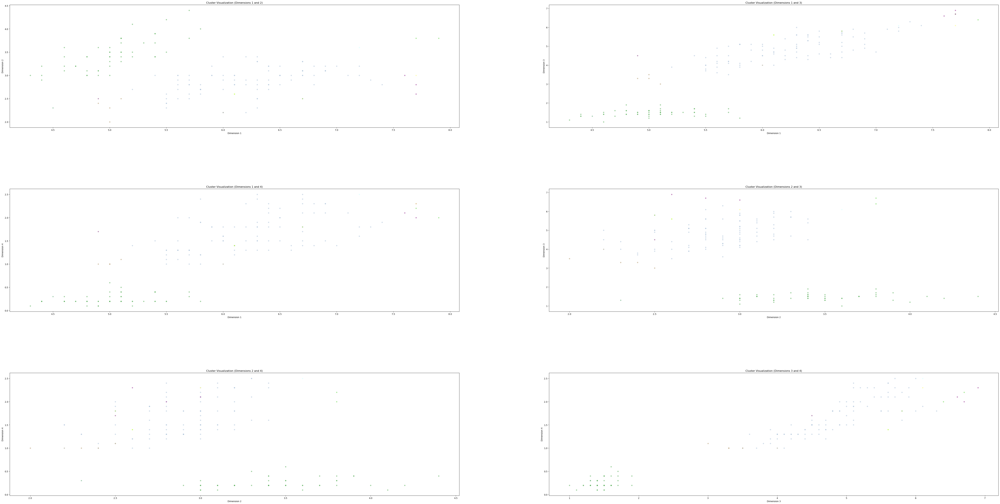

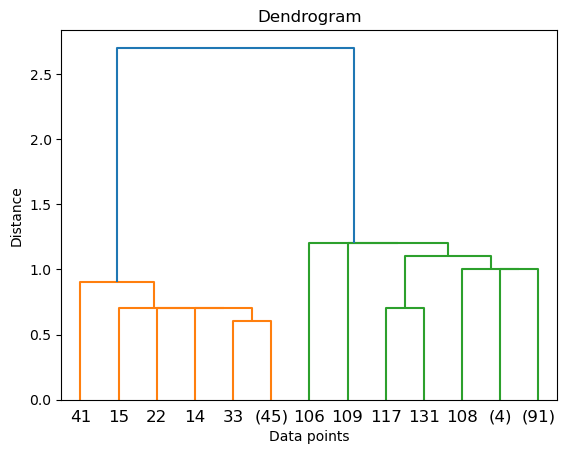

number of clusters 7


<Figure size 640x480 with 0 Axes>

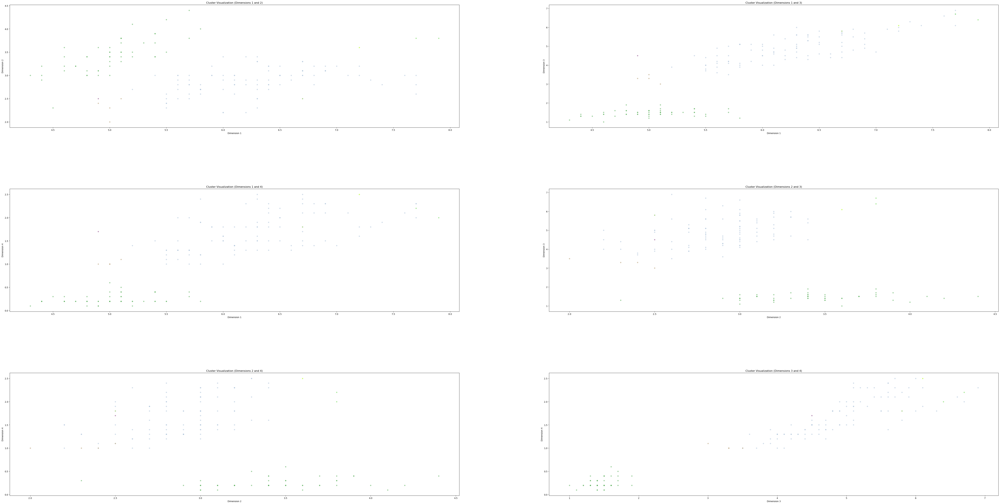

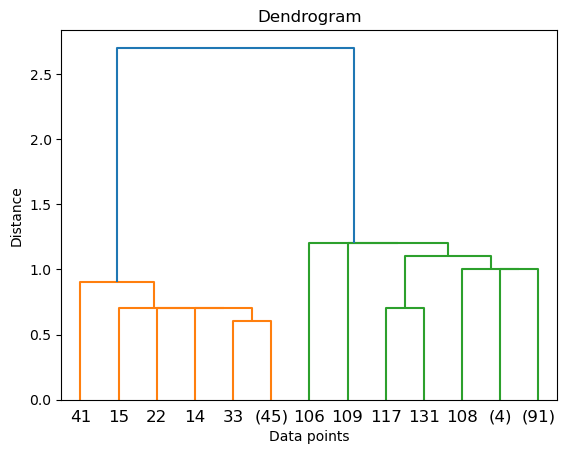

number of clusters 2


<Figure size 640x480 with 0 Axes>

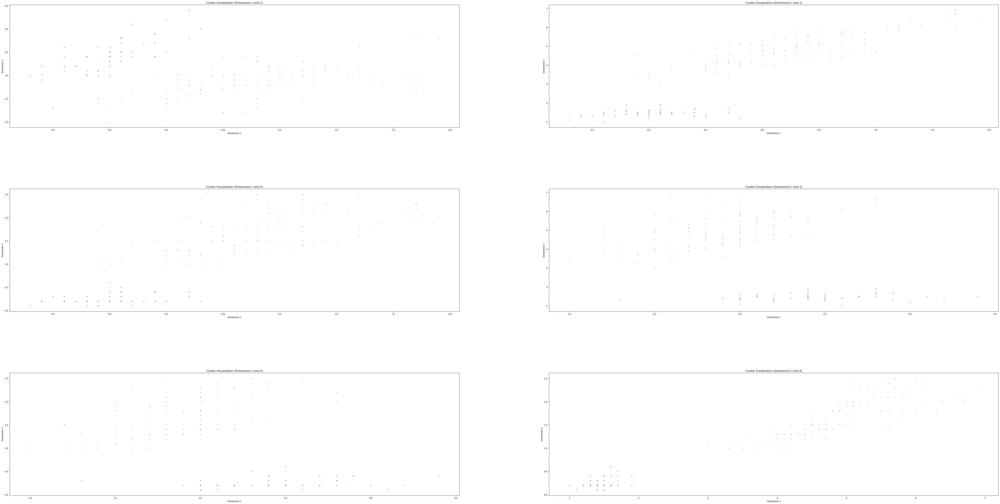

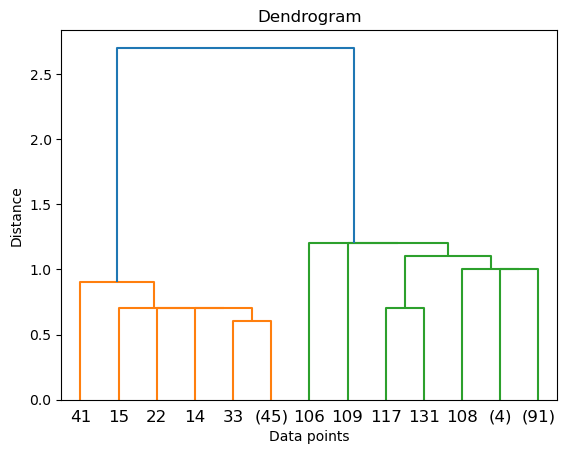

number of clusters 2


<Figure size 640x480 with 0 Axes>

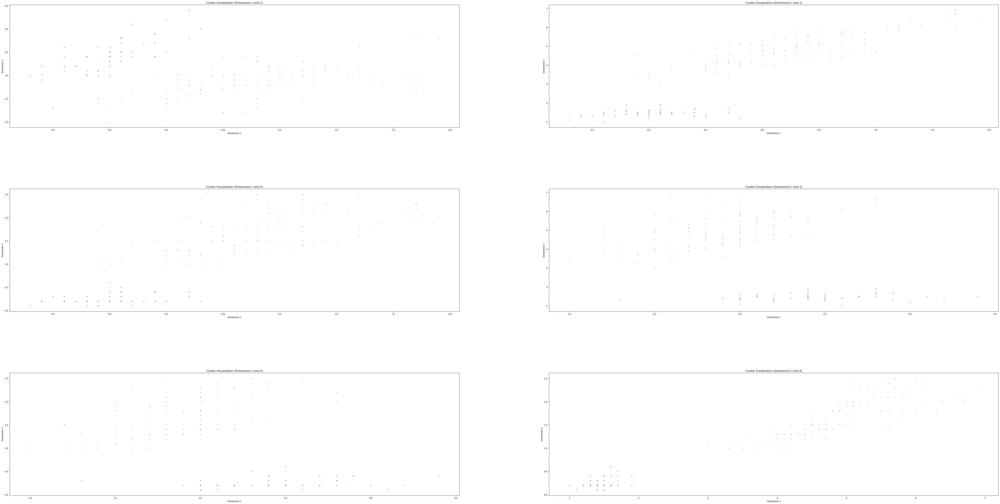

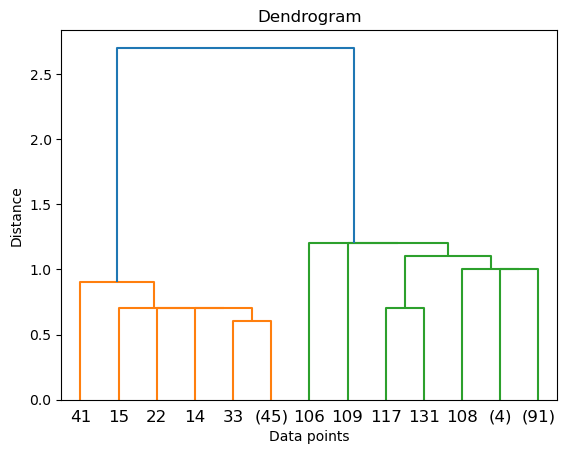

number of clusters 2


<Figure size 640x480 with 0 Axes>

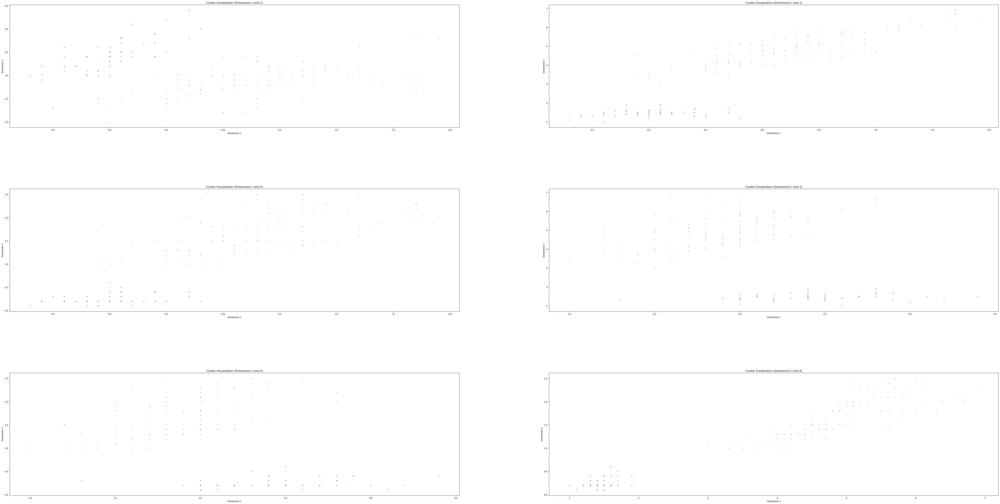

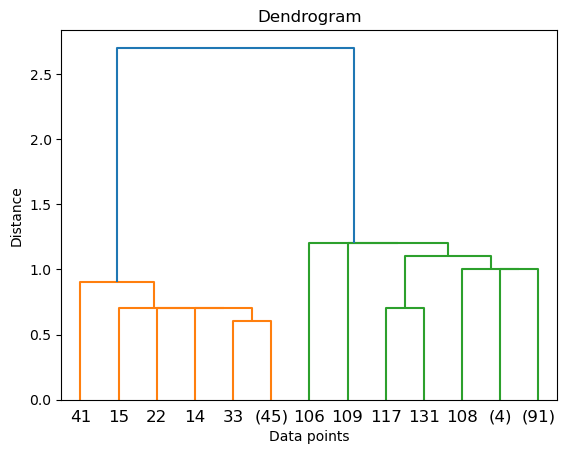

number of clusters 2


<Figure size 640x480 with 0 Axes>

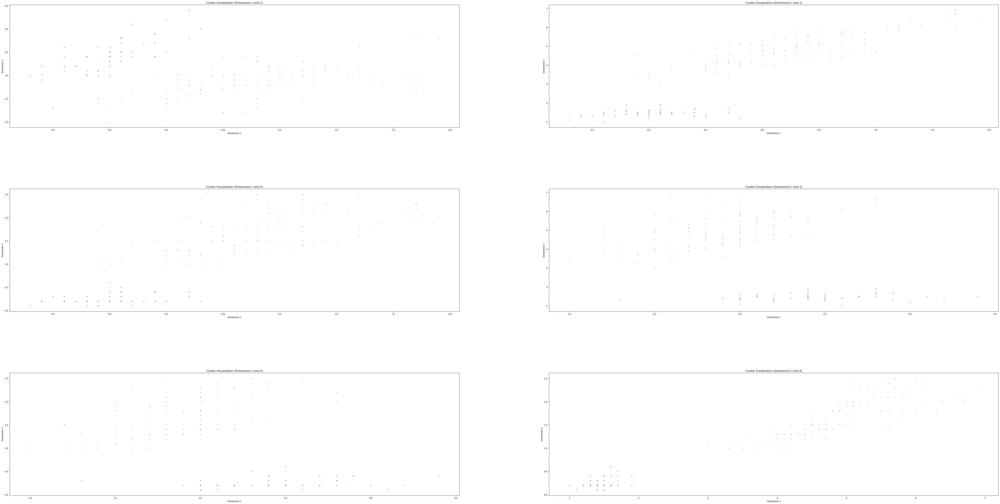

maximum silhouette score:  0.6867350732769777


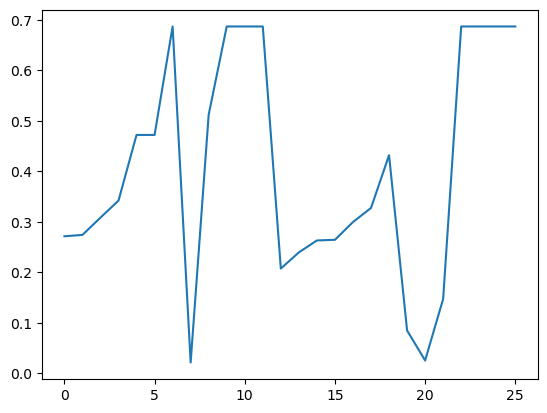

In [15]:
from sklearn.datasets import load_iris
iris_data = load_iris()

data = iris_data.data

distance_func = ['euclidean', 'manhattan', 'cosine']
Linkages = ['average', 'single']
distance_thresholds = [0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2]


silhouette = []

for distance in distance_func:
    
    for linkage_type in Linkages:
        
        for dist_thresh in distance_thresholds:
        

            model = AgglomerativeClustering(n_clusters=None, metric=distance, linkage=linkage_type, distance_threshold=dist_thresh)

            model.fit(data)
            
            if distance == 'manhattan':
                metric = 'cityblock'
            else:
                metric = distance

            linkage_matrix = linkage(data, method=linkage_type, metric=metric)
            
            if len(np.unique(model.labels_)) > 1:
            
                silhouette_avg = silhouette_score(data, model.labels_)
                silhouette.append(silhouette_avg)

                dendrogram(linkage_matrix, truncate_mode="level", p=5)  # You can adjust 'p' to control the number of clusters
                plt.title('Dendrogram')
                plt.xlabel('Data points')
                plt.ylabel('Distance')
                plt.show()
                
                print("number of clusters", model.n_clusters_)
                plt.figure()
                display_cluster(data, km=model, num_clusters=model.n_clusters_)
                
print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(silhouette)            

# plt.figure()
# display_cluster(Multi_blob_Data, km=model ,num_clusters=model.n_clusters_)

In [16]:
# from sklearn.datasets import load_iris
# iris_data = load_iris()

# data = iris_data.data

# distance_func = ['euclidean', 'manhattan', 'cosine']
# Linkages = ['average', 'single']
# # distance_thresholds = [0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2]


# silhouette = []

# for distance in distance_func:
    
#     for linkage_type in Linkages:
        
#         model = AgglomerativeClustering(n_clusters=3, metric=distance, linkage=linkage_type)

#         model.fit(data)

#         if distance == 'manhattan':
#             metric = 'cityblock'
#         else:
#             metric = distance

#         linkage_matrix = linkage(data, method=linkage_type, metric=metric)

#         if len(np.unique(model.labels_)) > 1:

#             silhouette_avg = silhouette_score(data, model.labels_)
#             silhouette.append(silhouette_avg)

#             dendrogram(linkage_matrix, truncate_mode="level", p=5)  # You can adjust 'p' to control the number of clusters
#             plt.title('Dendrogram')
#             plt.xlabel('Data points')
#             plt.ylabel('Distance')
#             plt.show()

#             print("number of clusters", model.n_clusters_)
#             plt.figure()
#             display_cluster(data, km=model, num_clusters=model.n_clusters_)
                
# print("maximum silhouette score: ", max(silhouette))

# plt.figure()
# plt.plot(silhouette)            

# # plt.figure()
# # display_cluster(Multi_blob_Data, km=model ,num_clusters=model.n_clusters_)

number of clusters:  2


<Figure size 640x480 with 0 Axes>

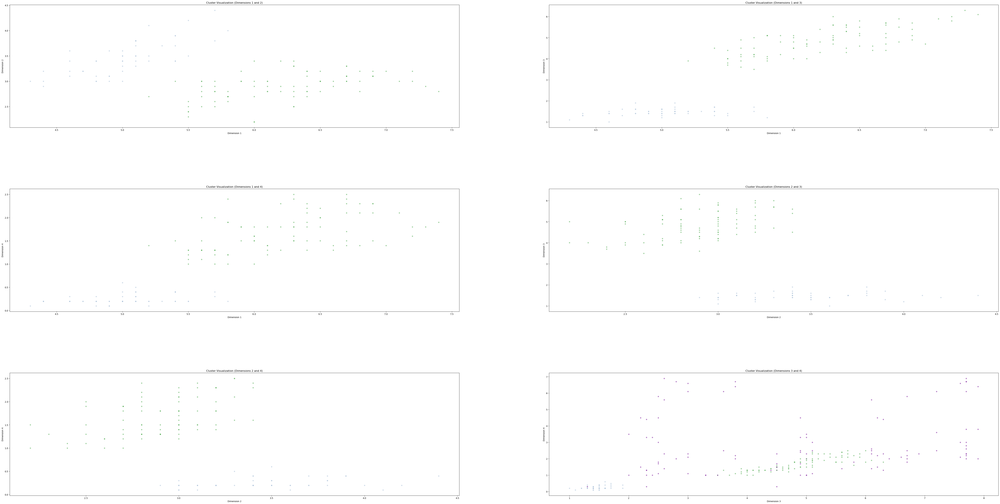

number of clusters:  2


<Figure size 640x480 with 0 Axes>

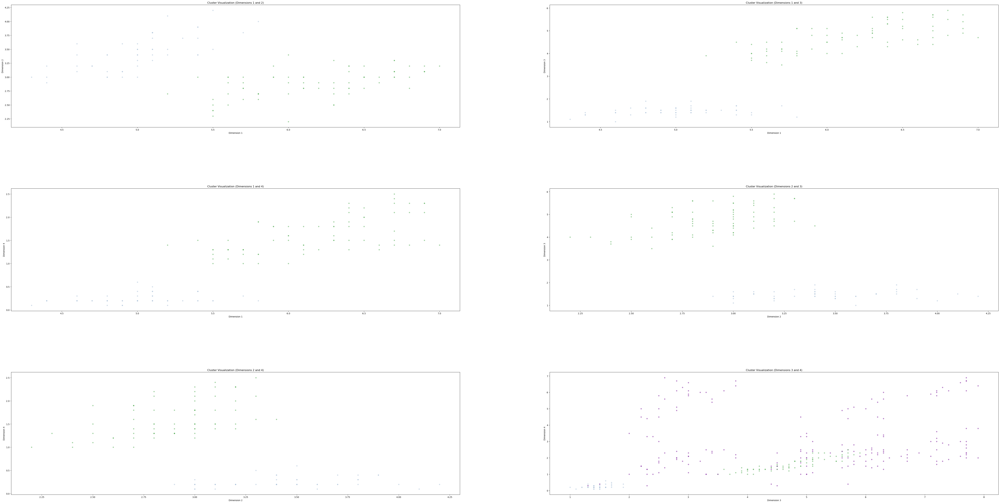

number of clusters:  2


<Figure size 640x480 with 0 Axes>

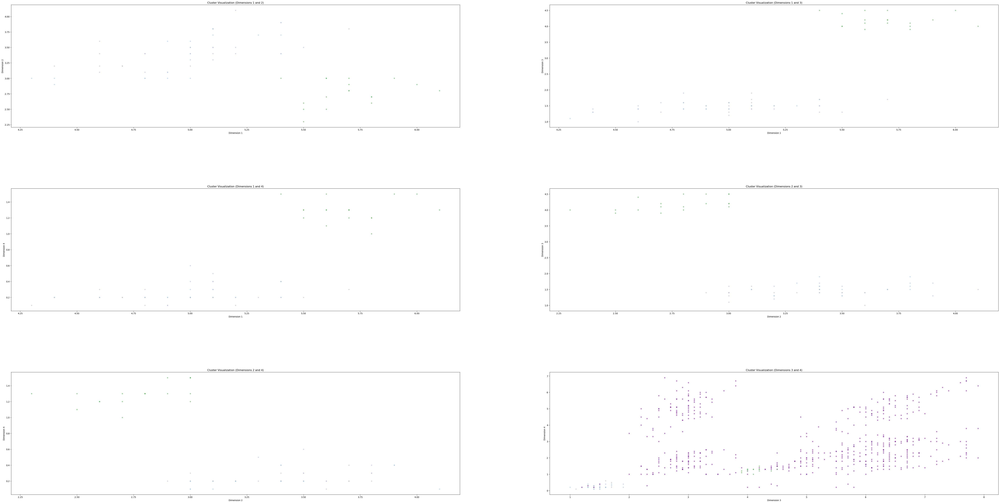

number of clusters:  1


<Figure size 640x480 with 0 Axes>

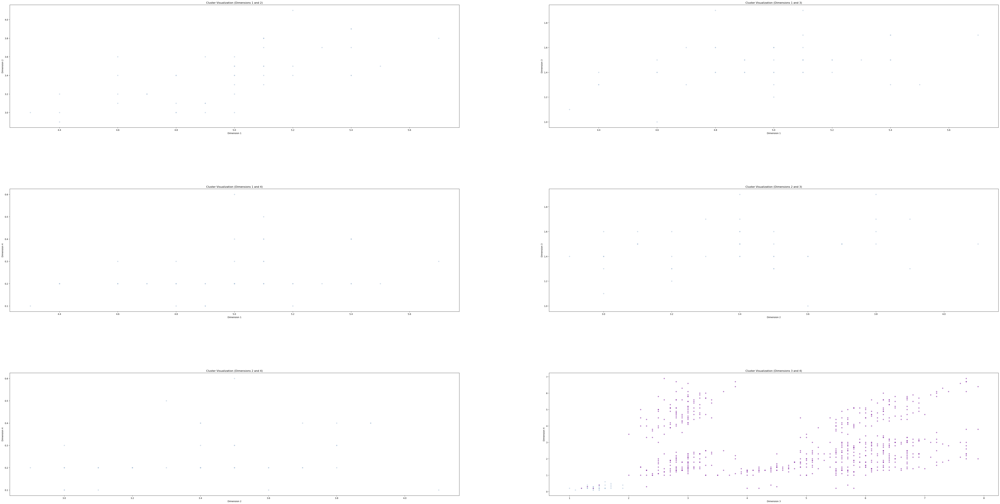

number of clusters:  1


<Figure size 640x480 with 0 Axes>

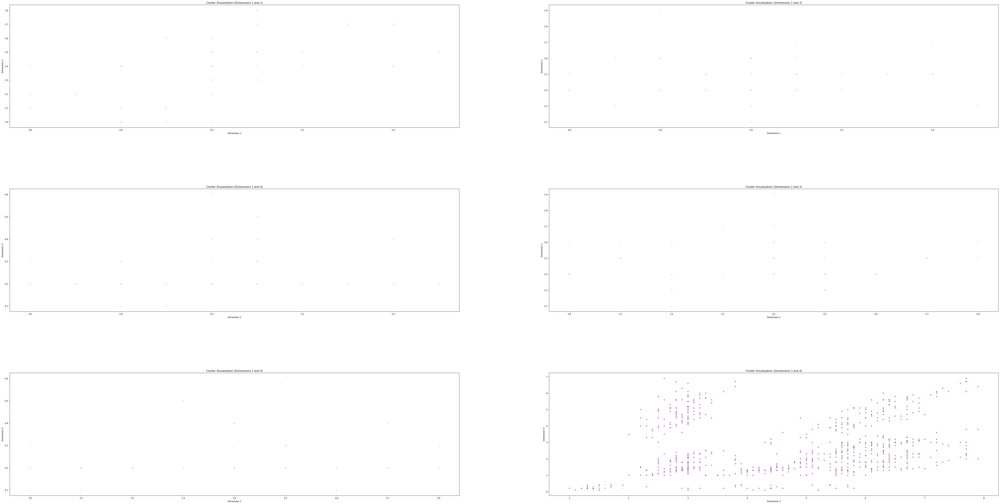

number of clusters:  2


<Figure size 640x480 with 0 Axes>

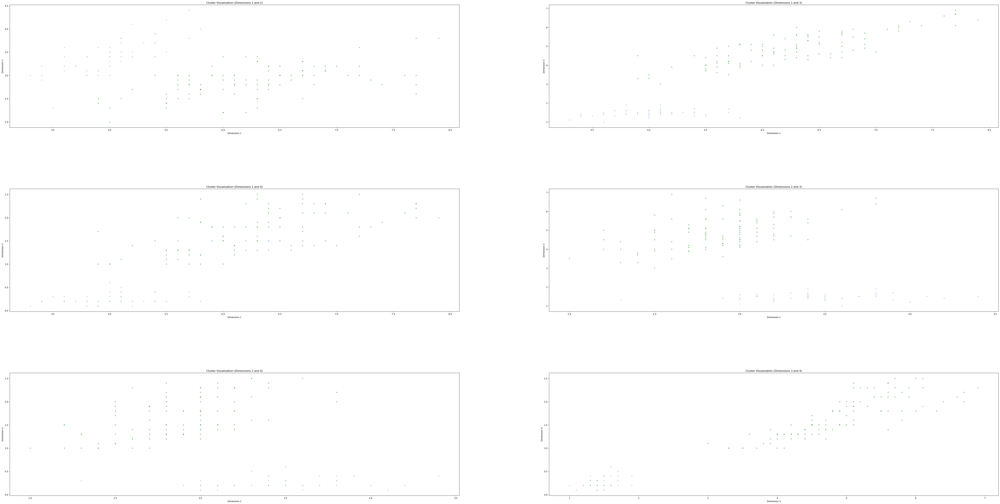

number of clusters:  2


<Figure size 640x480 with 0 Axes>

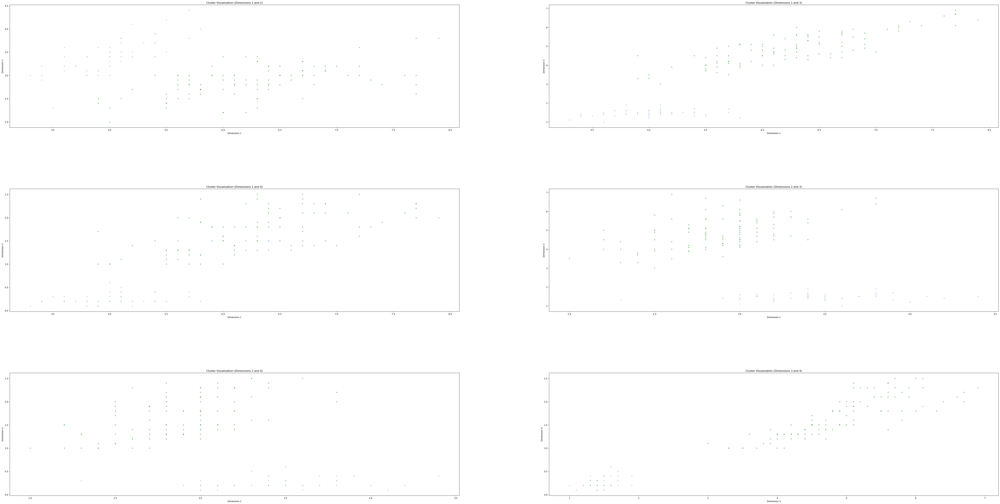

number of clusters:  2


<Figure size 640x480 with 0 Axes>

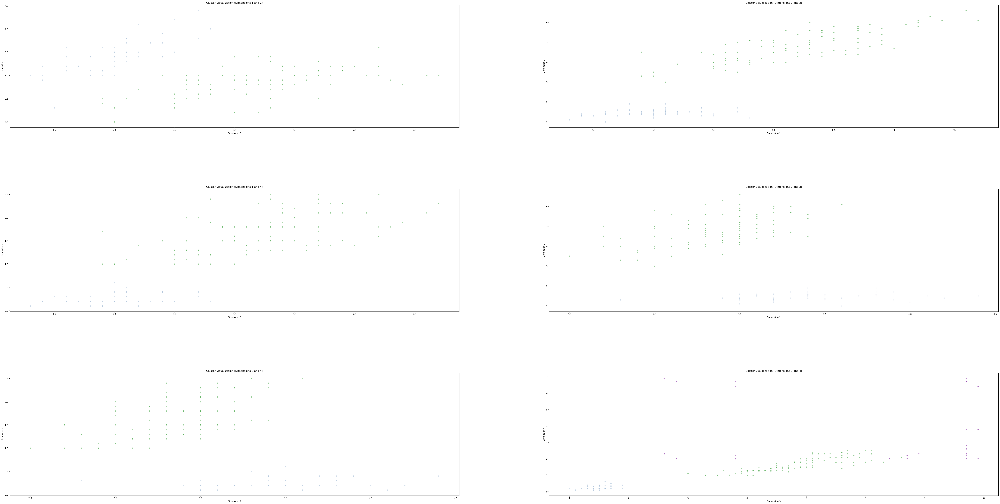

number of clusters:  2


<Figure size 640x480 with 0 Axes>

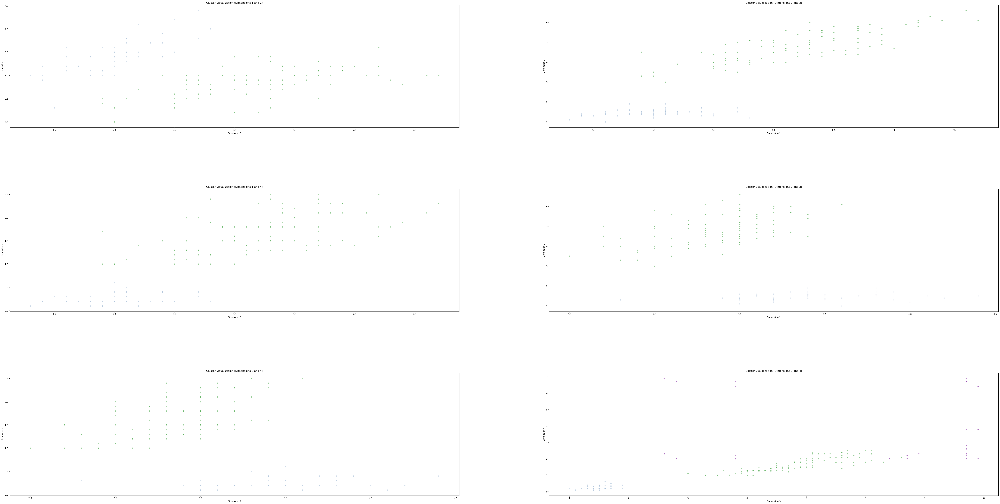

number of clusters:  2


<Figure size 640x480 with 0 Axes>

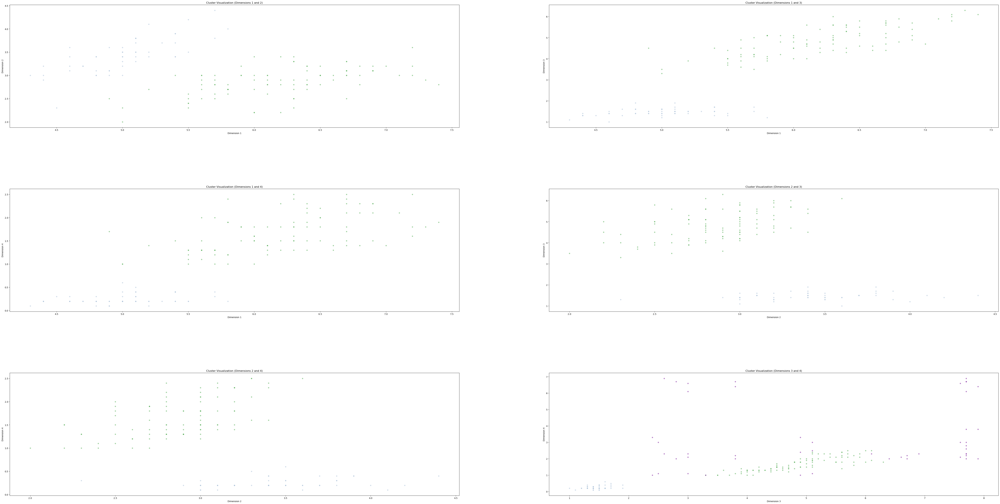

number of clusters:  2


<Figure size 640x480 with 0 Axes>

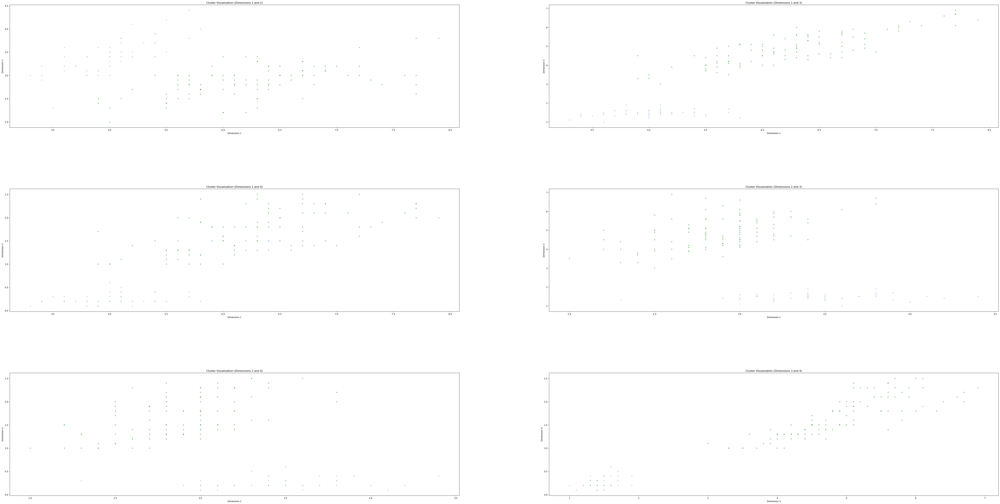

number of clusters:  2


<Figure size 640x480 with 0 Axes>

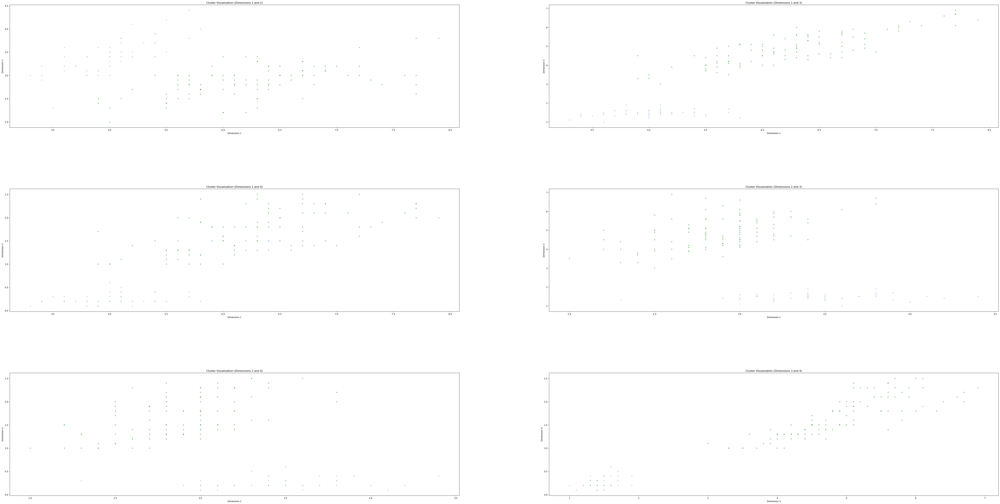

number of clusters:  2


<Figure size 640x480 with 0 Axes>

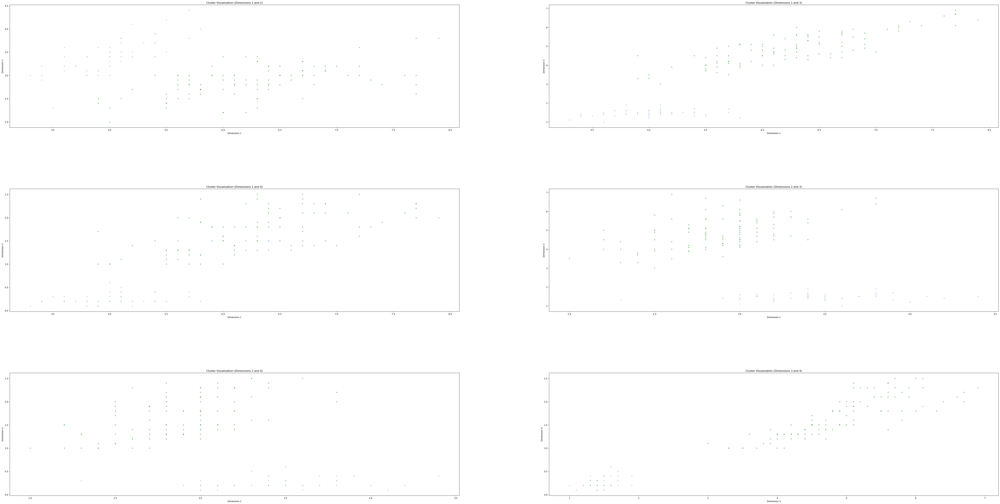

number of clusters:  2


<Figure size 640x480 with 0 Axes>

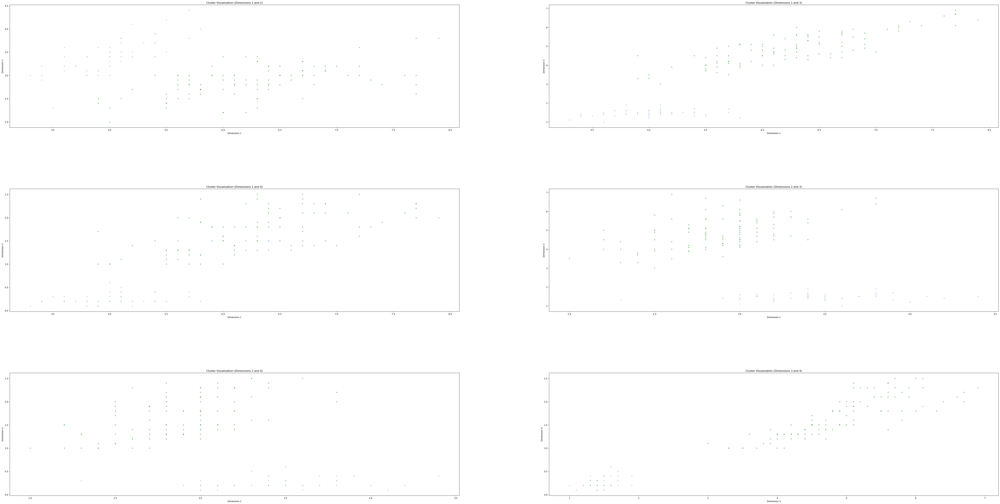

number of clusters:  2


<Figure size 640x480 with 0 Axes>

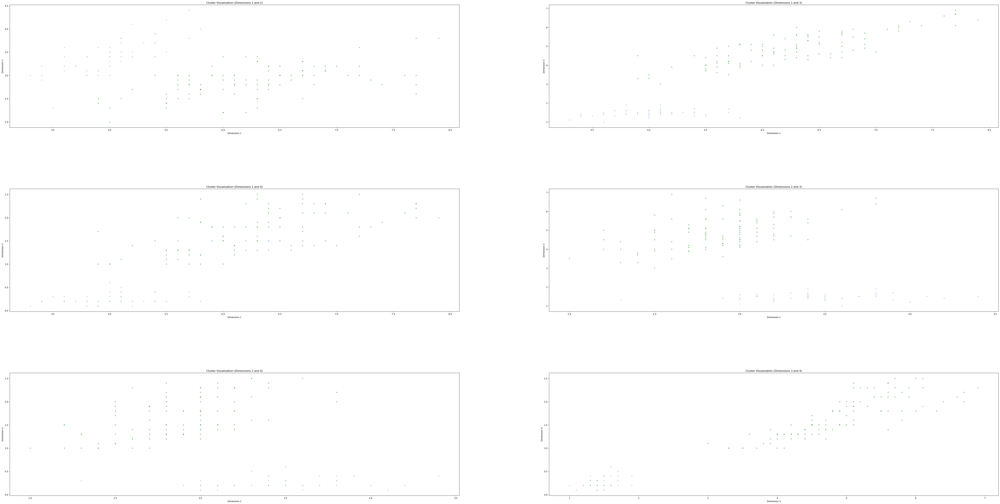

highest score:  0.6867350732769777
best parameters:  (0.9, 5)


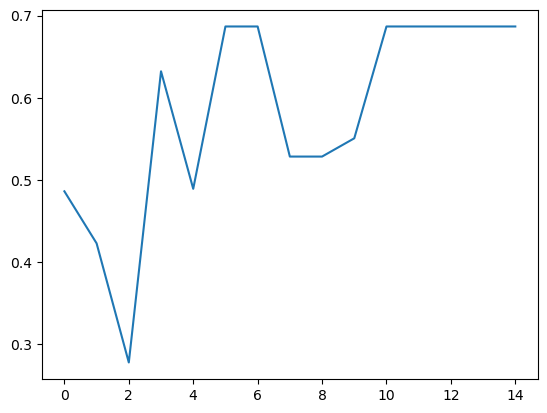

In [17]:
from sklearn.datasets import load_iris
iris_data = load_iris()

data = iris_data.data


EPS = np.arange(0.1, 3.1, 0.4)
min_samples = np.arange(5, 26, 5)

silhouette = []
params = []

for eps in EPS:
    
    for min_samp in min_samples:

        dbscan = DBSCAN(eps=eps, min_samples=min_samp)  # Adjust eps and min_samples as needed

        # Fit the model to the data
        dbscan.fit(data)

        # Get cluster labels for each data point
        cluster_labels = dbscan.labels_

        # Identify the number of clusters (excluding noise)
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)

        if len(np.unique(cluster_labels)) > 1:
            
            silhouette_avg = silhouette_score(data, cluster_labels)
            silhouette.append(silhouette_avg)
            
            parameters = (eps, min_samp)
            params.append(parameters)
            
            print("number of clusters: ", n_clusters)
            
            plt.figure()
            display_cluster(data, km=dbscan, num_clusters=n_clusters)
       

print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

        
plt.figure()
plt.plot(silhouette)

In [18]:
from sklearn.datasets import load_iris
from sklearn.decomposition import PCA
iris_data = load_iris()

data = iris_data.data

# pca = PCA(n_components=2)
# data_2d = pca.fit_transform(data)

covariance_types = ['full', 'tied', 'diag', 'spherical']

silhouette = []

params = []

for n in range(2, 11): 

    for covariance_type in covariance_types:

        gmm = GaussianMixture(n_components=n, covariance_type=covariance_type)
        gmm.fit(data)
        labels = gmm.predict(data)
        probs = gmm.predict_proba(data)
        
        silhouette_avg = silhouette_score(data, labels)
        silhouette.append(silhouette_avg)
        parameters = (n, covariance_type)
        params.append(parameters)

        GMM = kmeans_res(labels)

        log_likelihoods = gmm.score_samples(data)
print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

plt.figure()
plt.plot(silhouette) 

NameError: name 'kmeans_res' is not defined

highest score:  0.5528190123564095
best parameters:  spherical


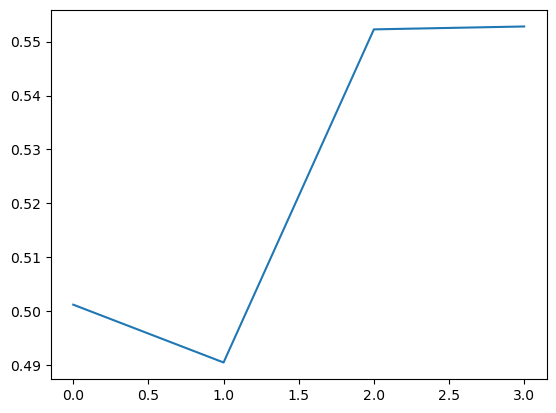

In [63]:
from sklearn.datasets import load_iris
iris_data = load_iris()

data = iris_data.data


covariance_types = ['full', 'tied', 'diag', 'spherical']

silhouette = []
params = []

for covariance_type in covariance_types:

    gmm = GaussianMixture(n_components=3, covariance_type=covariance_type)
    gmm.fit(data)
    labels = gmm.predict(data)
    probs = gmm.predict_proba(data)

    silhouette_avg = silhouette_score(data, labels)
    silhouette.append(silhouette_avg)
    
    parameters = (covariance_type)
    params.append(parameters)

    GMM = kmeans_res(labels)

    log_likelihoods = gmm.score_samples(data)
print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

plt.figure()
plt.plot(silhouette) 

## Normalized

In [37]:
from sklearn.datasets import load_iris
iris_data = load_iris()
data = iris_data.data
data = StandardScaler().fit_transform(data)

<Figure size 640x480 with 0 Axes>

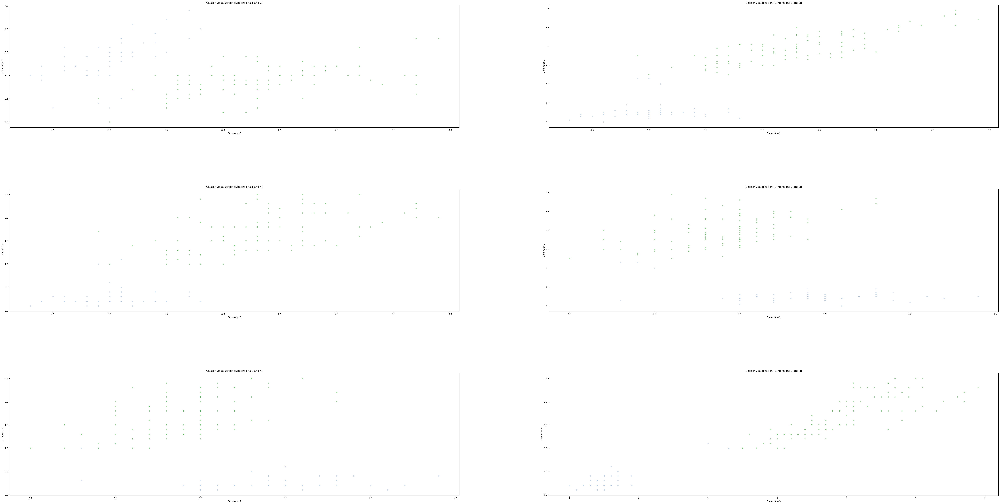

<Figure size 640x480 with 0 Axes>

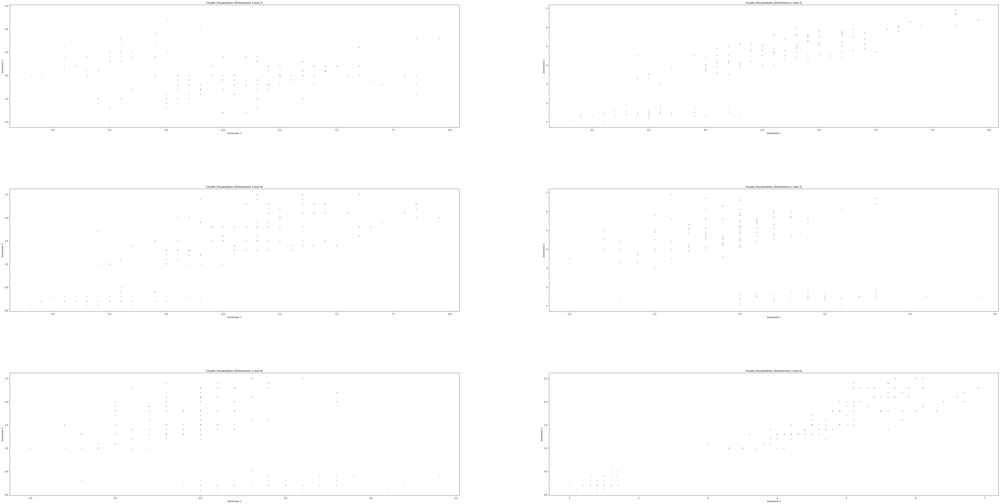

<Figure size 640x480 with 0 Axes>

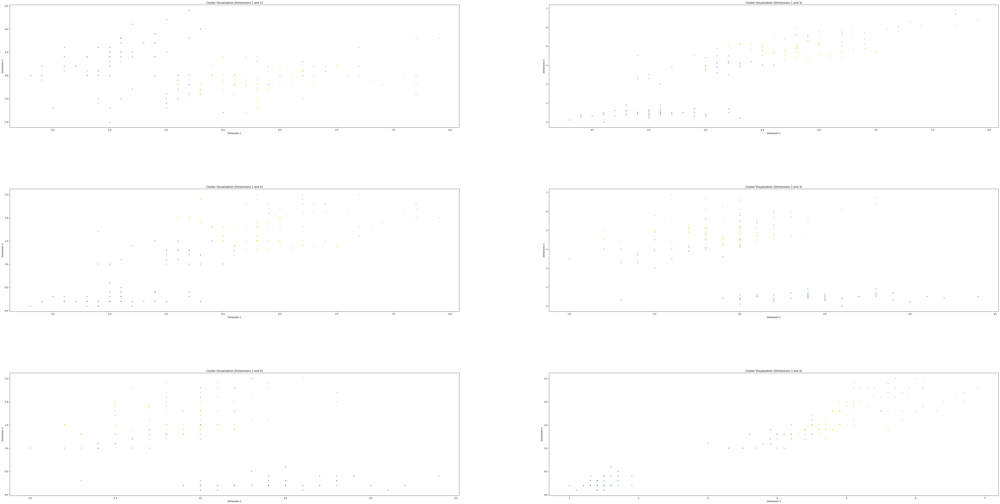

<Figure size 640x480 with 0 Axes>

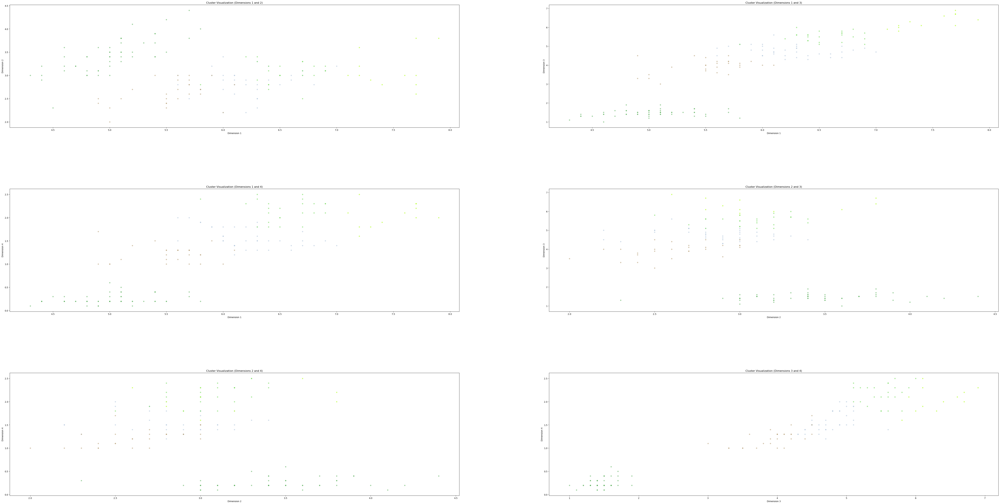

<Figure size 640x480 with 0 Axes>

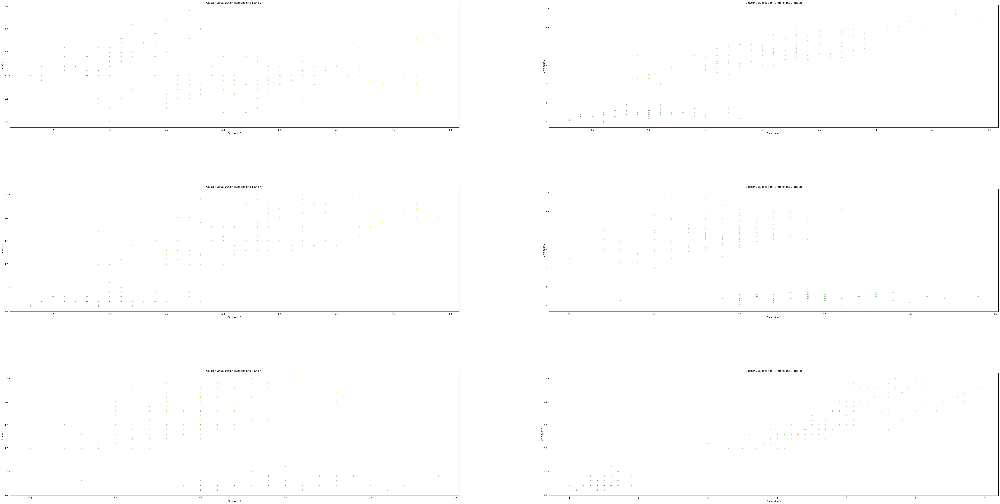

<Figure size 640x480 with 0 Axes>

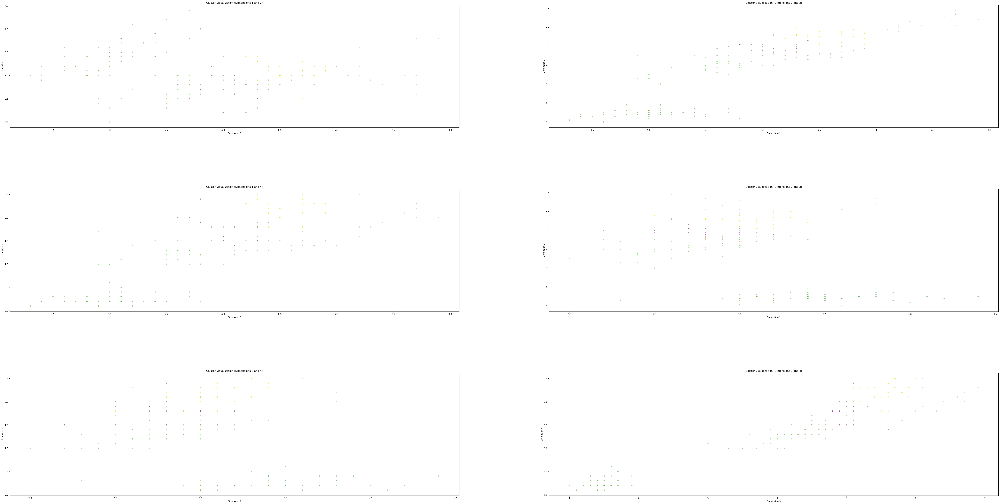

<Figure size 640x480 with 0 Axes>

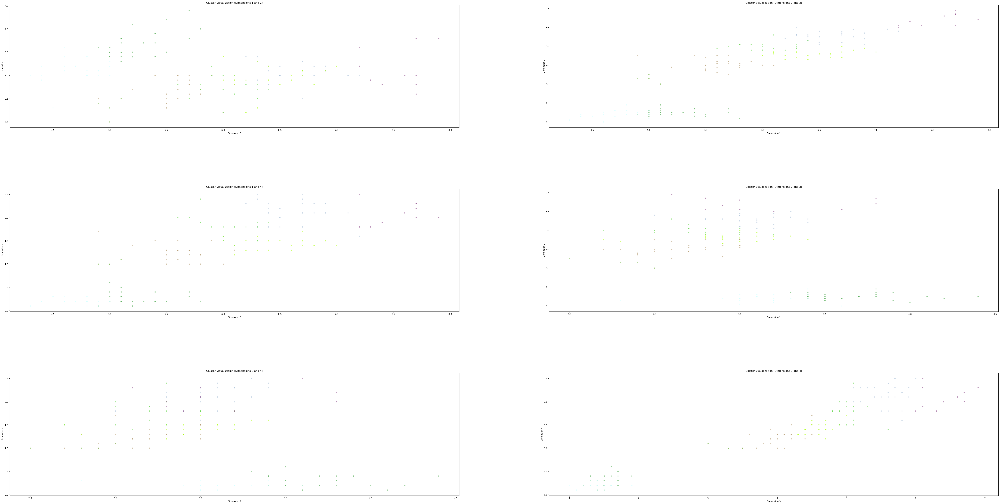

<Figure size 640x480 with 0 Axes>

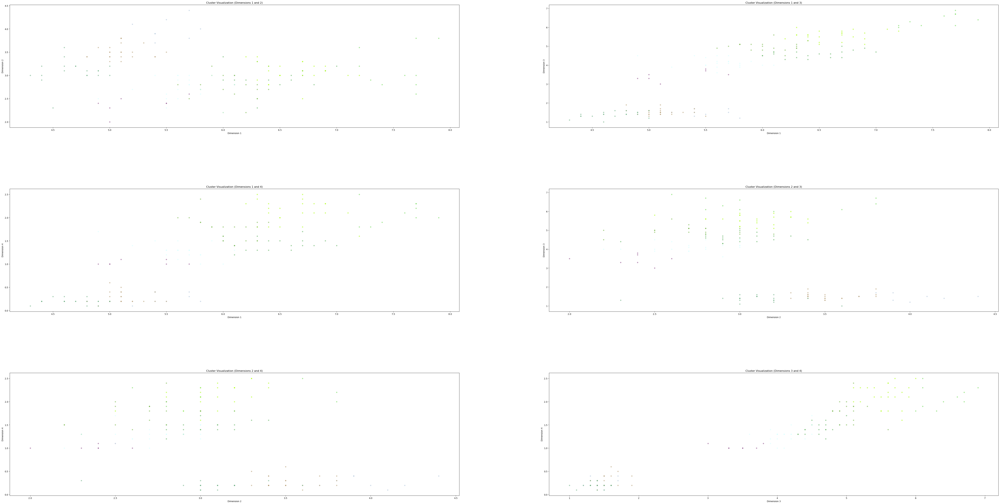

<Figure size 640x480 with 0 Axes>

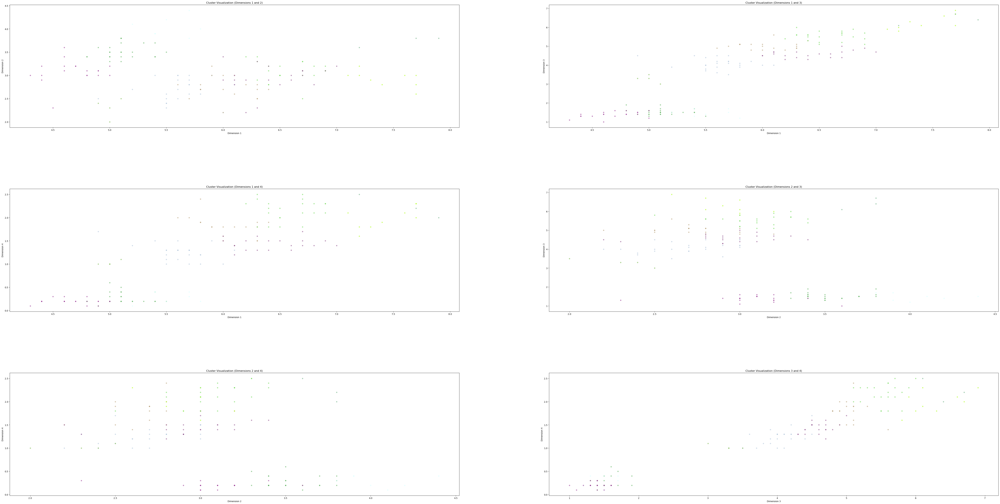

2
maximum silhouette score:  0.6810461692117462


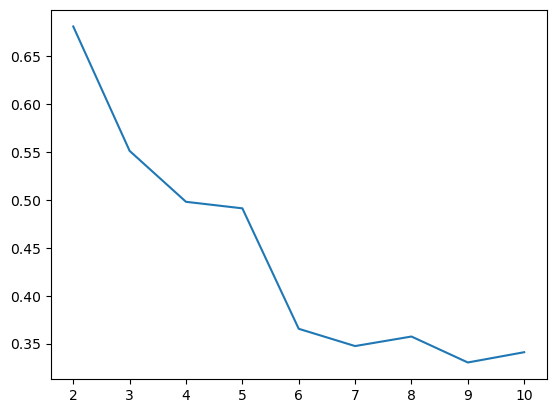

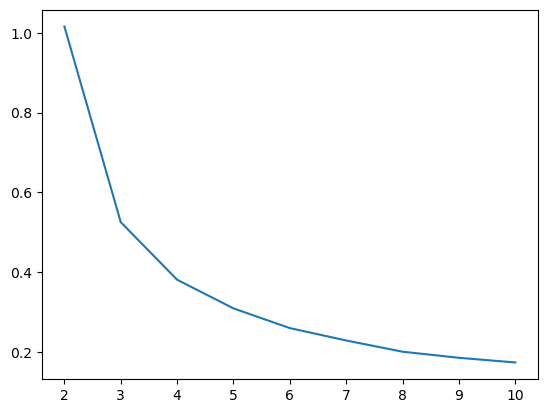

In [19]:
silhouette = []
metric = []
for i in range(2, 11):
    
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(data)
    metric.append((kmeans.inertia_) / len(data))
    silhouette_avg = silhouette_score(data, kmeans.labels_)
    silhouette.append(silhouette_avg)

    plt.figure()
    display_cluster(data, km=kmeans,num_clusters=i)
    
    
    
best_cluster = silhouette.index(max(silhouette)) + 2
print(best_cluster)
    
x_axis = np.arange(2, 11)

print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(x_axis, silhouette)

plt.figure()
plt.plot(x_axis, metric)

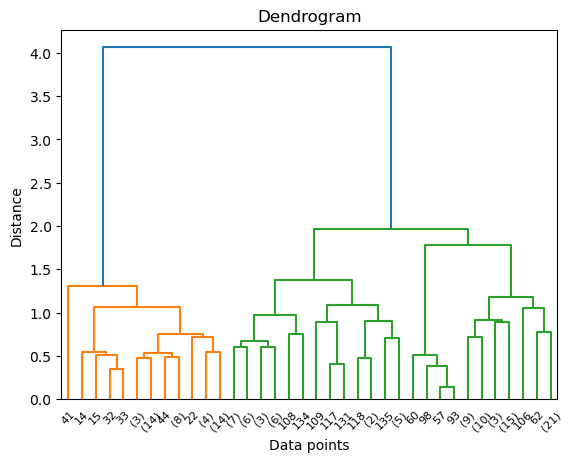

number of clusters 40


<Figure size 640x480 with 0 Axes>

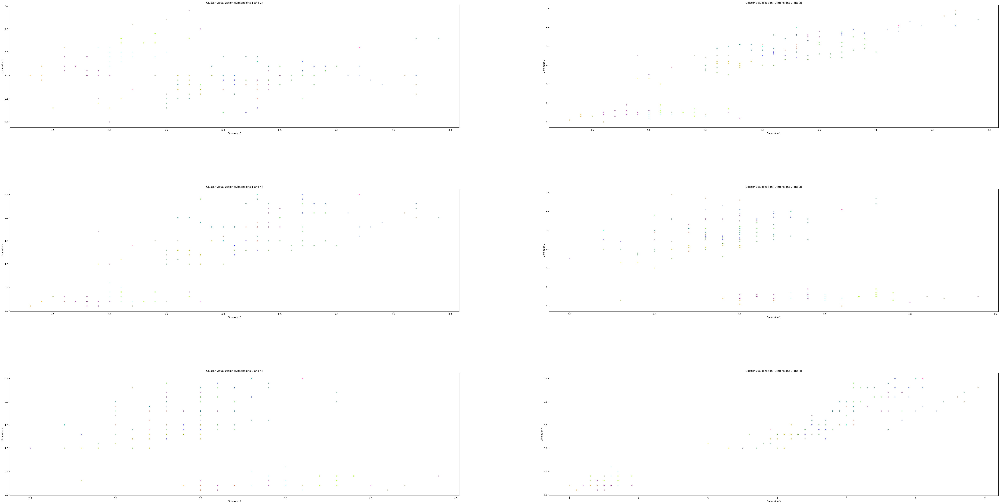

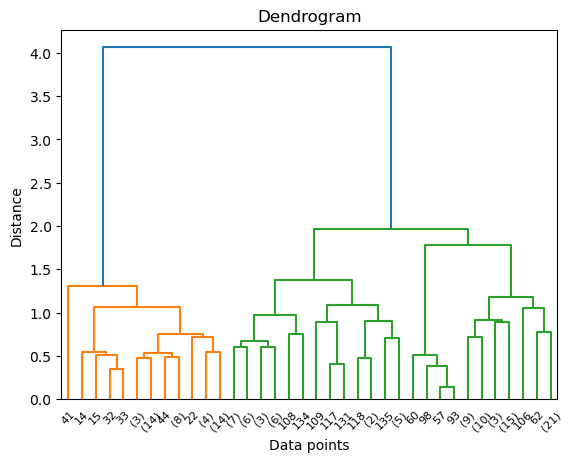

number of clusters 18


<Figure size 640x480 with 0 Axes>

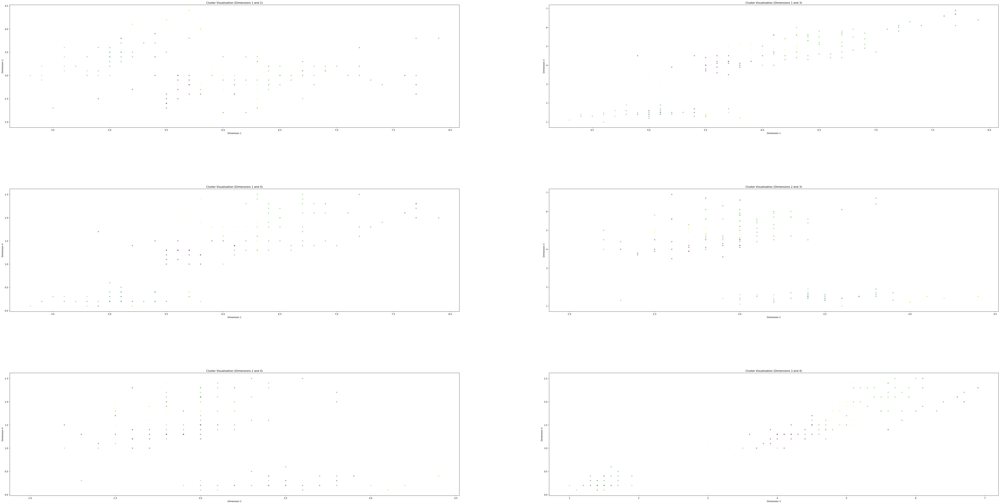

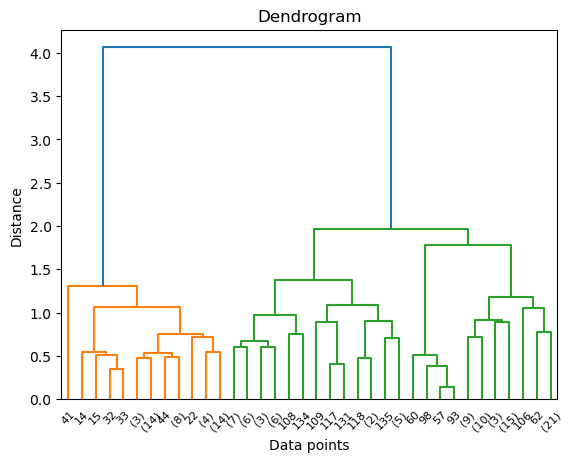

number of clusters 10


<Figure size 640x480 with 0 Axes>

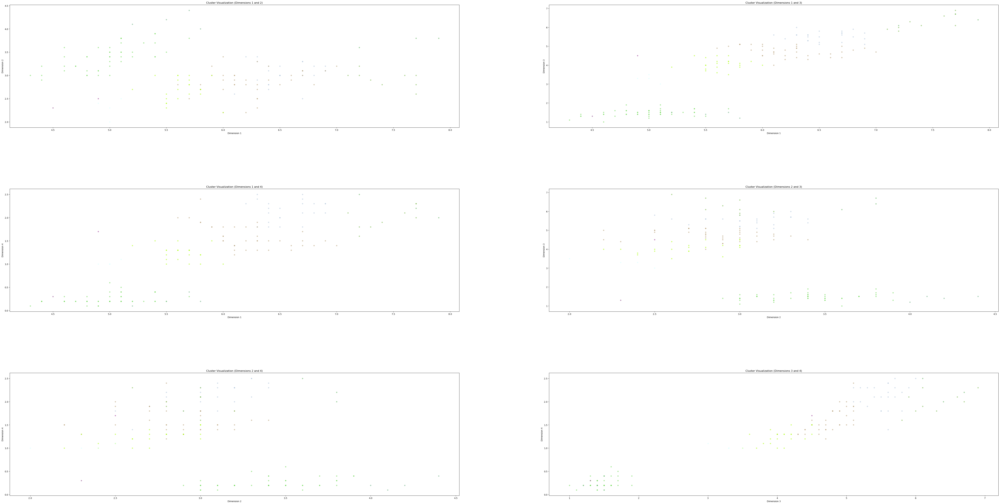

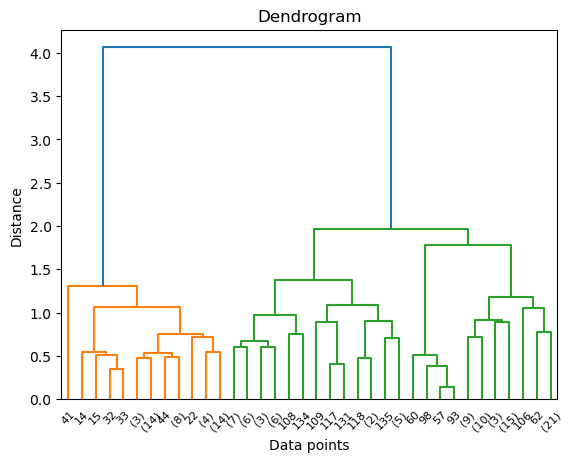

number of clusters 6


<Figure size 640x480 with 0 Axes>

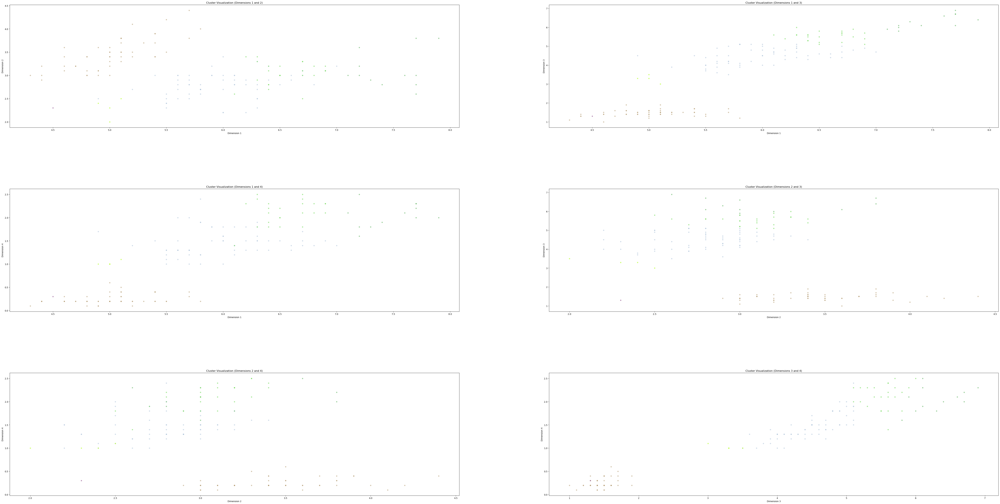

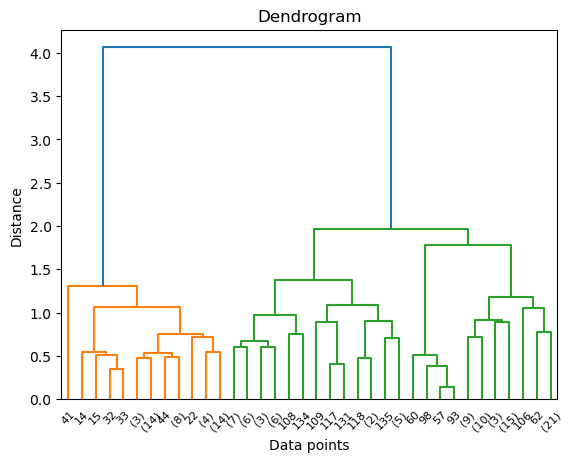

number of clusters 4


<Figure size 640x480 with 0 Axes>

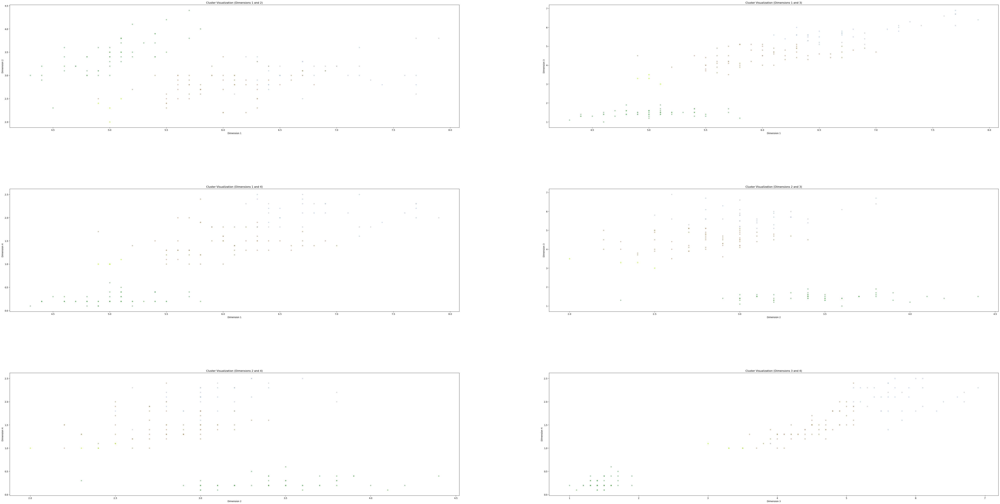

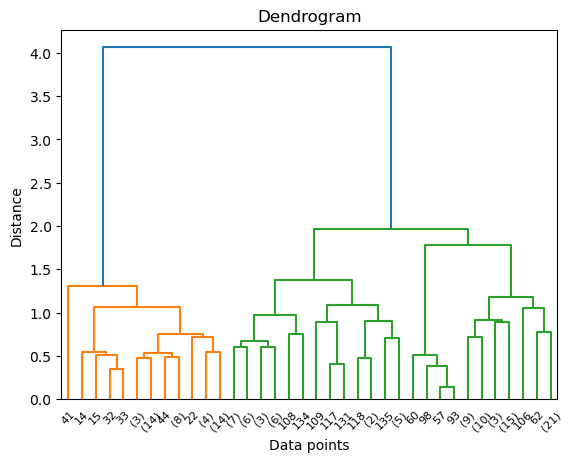

number of clusters 4


<Figure size 640x480 with 0 Axes>

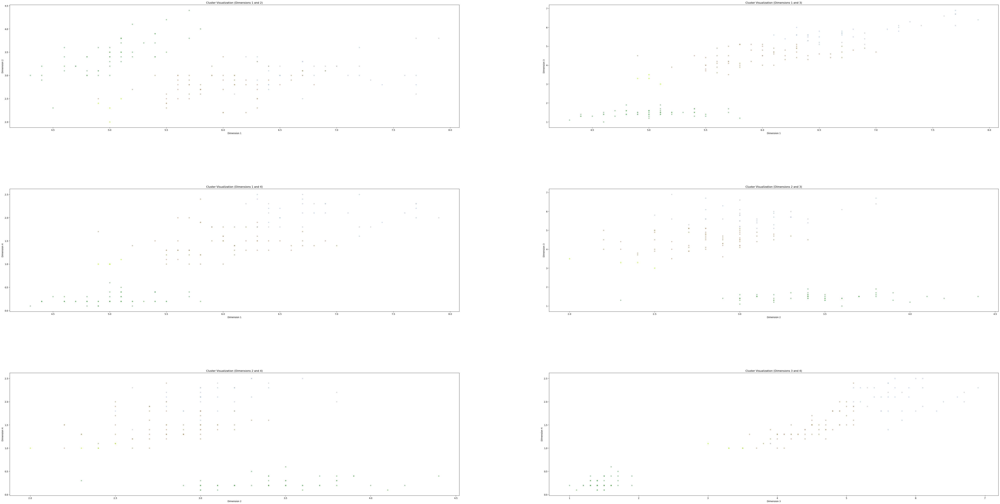

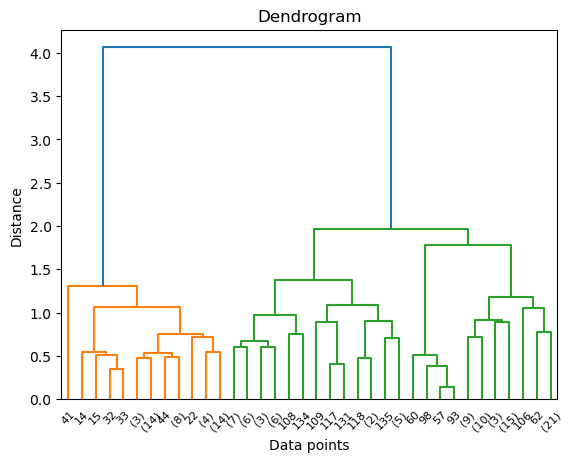

number of clusters 2


<Figure size 640x480 with 0 Axes>

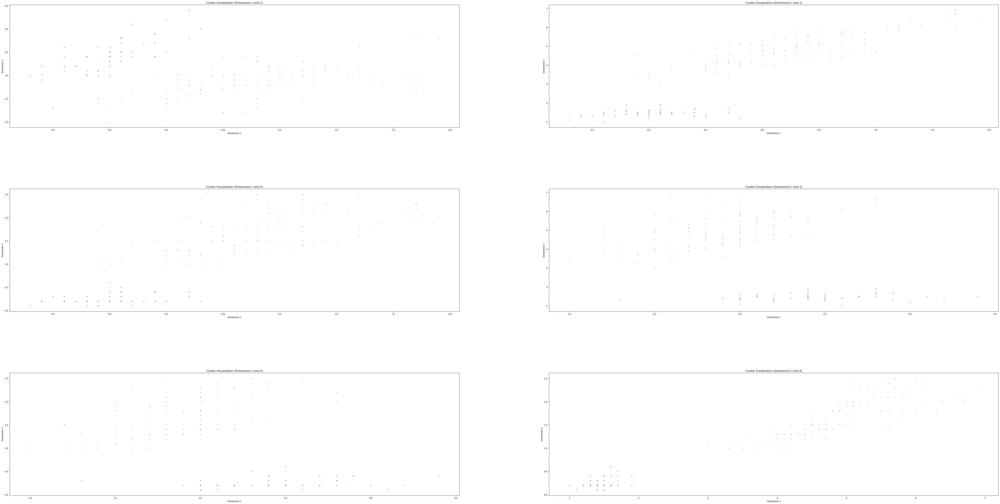

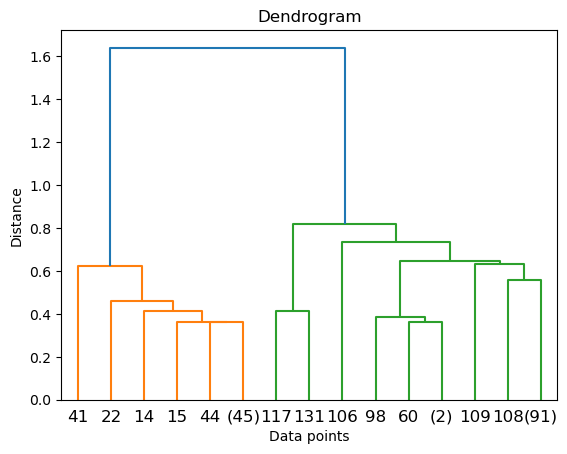

number of clusters 12


<Figure size 640x480 with 0 Axes>

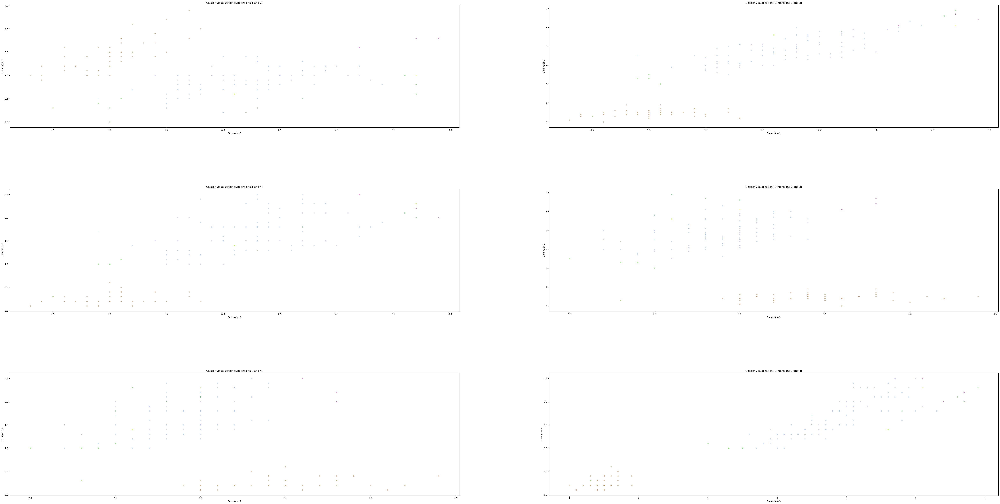

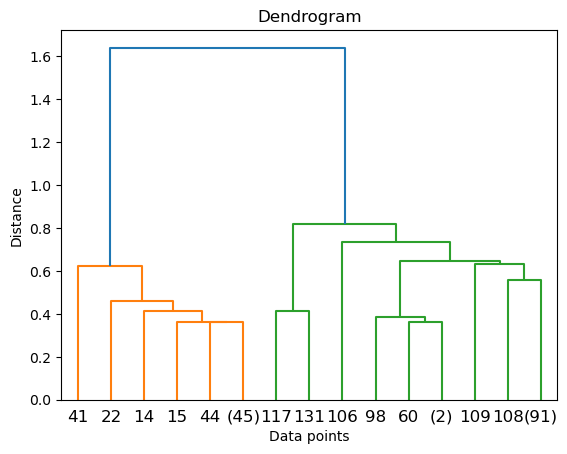

number of clusters 3


<Figure size 640x480 with 0 Axes>

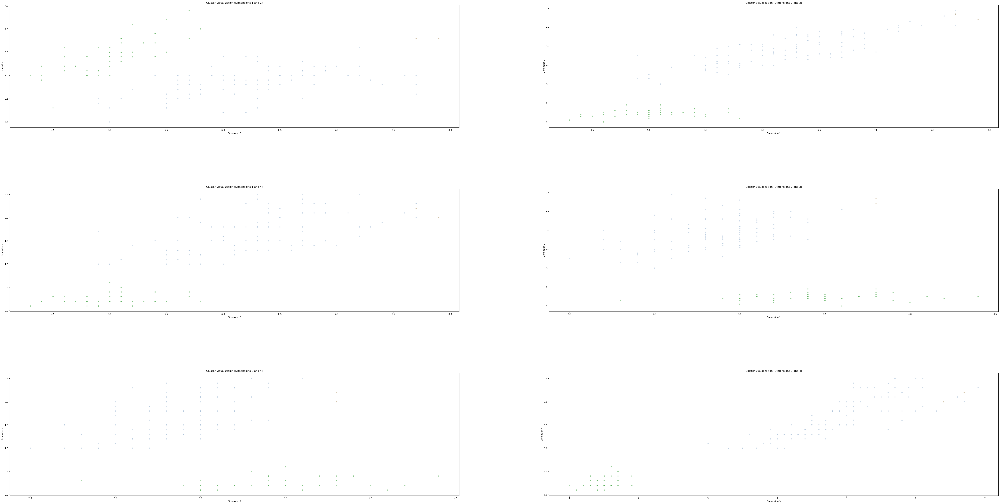

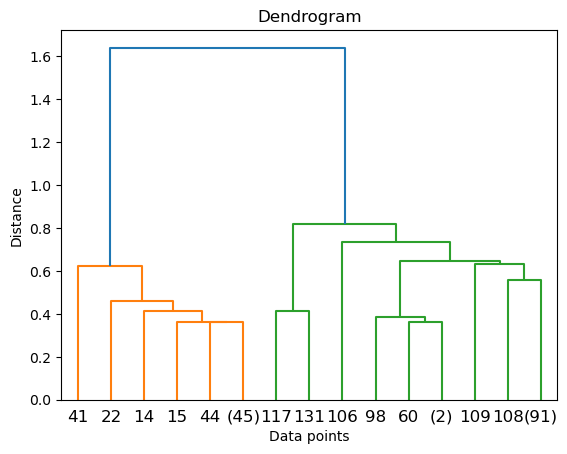

number of clusters 2


<Figure size 640x480 with 0 Axes>

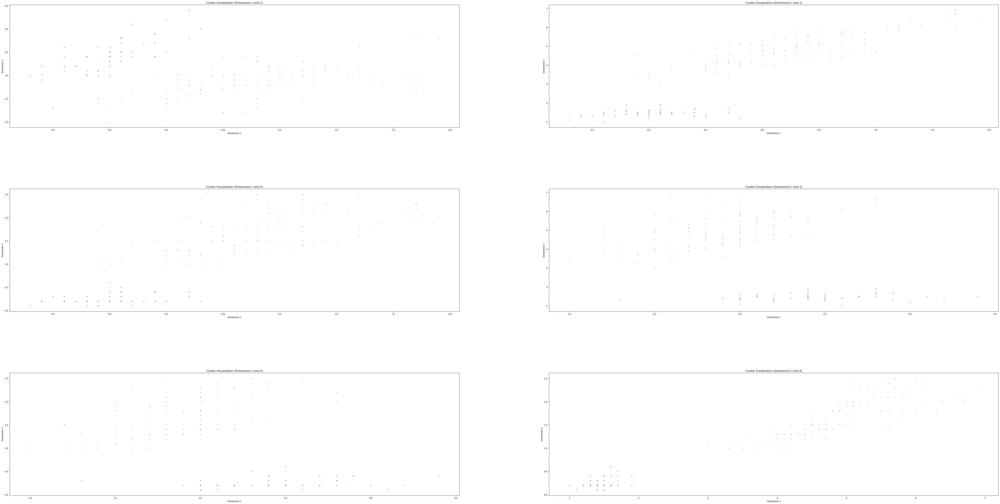

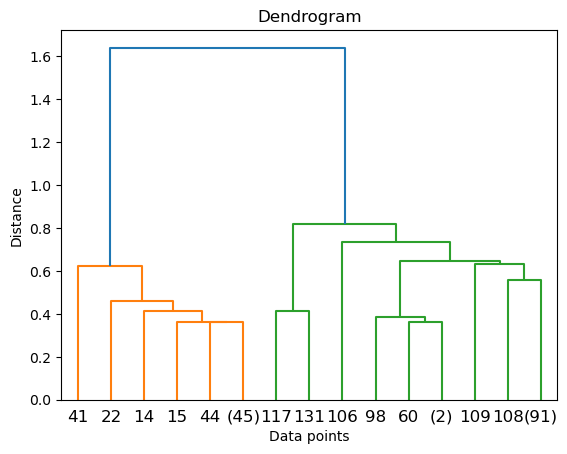

number of clusters 2


<Figure size 640x480 with 0 Axes>

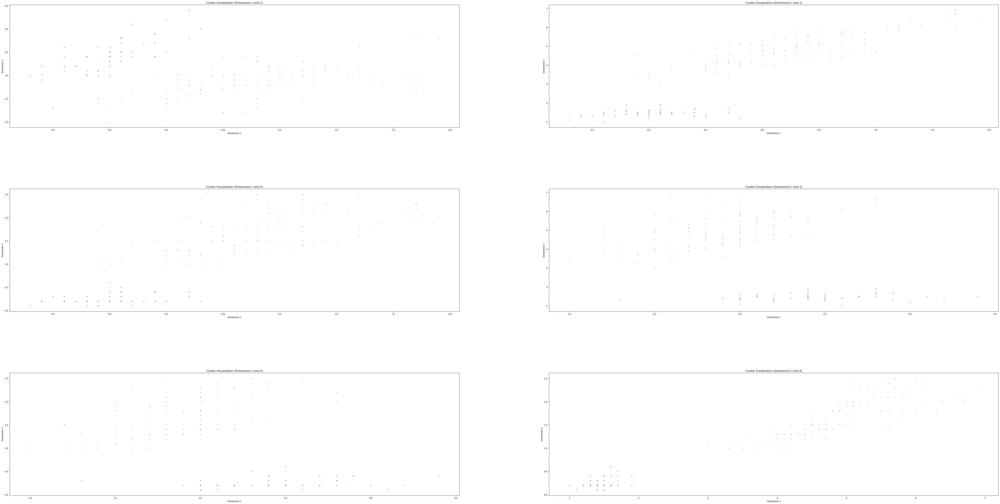

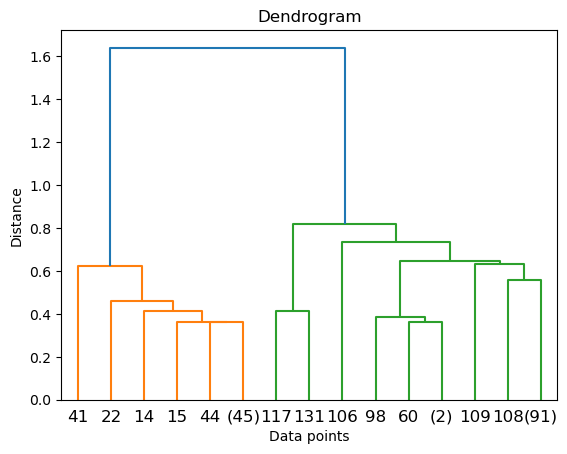

number of clusters 2


<Figure size 640x480 with 0 Axes>

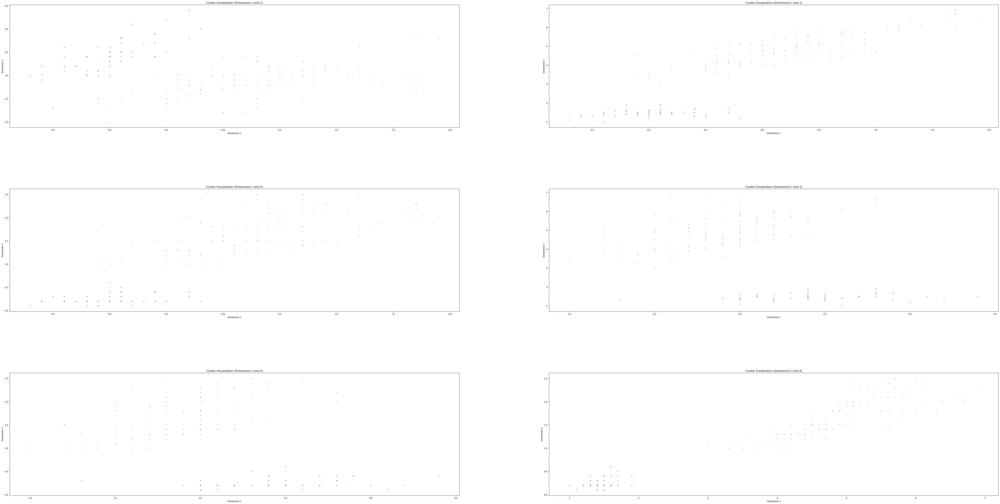

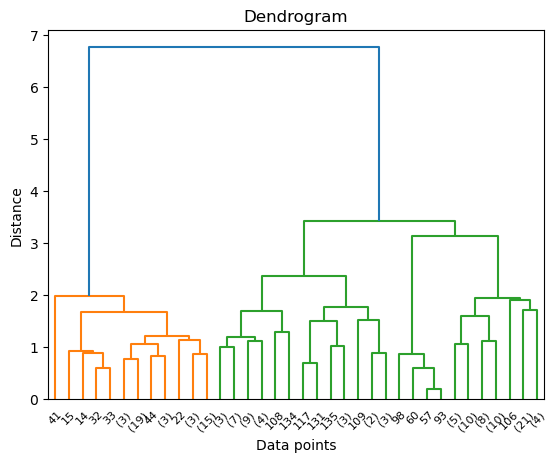

number of clusters 86


<Figure size 640x480 with 0 Axes>

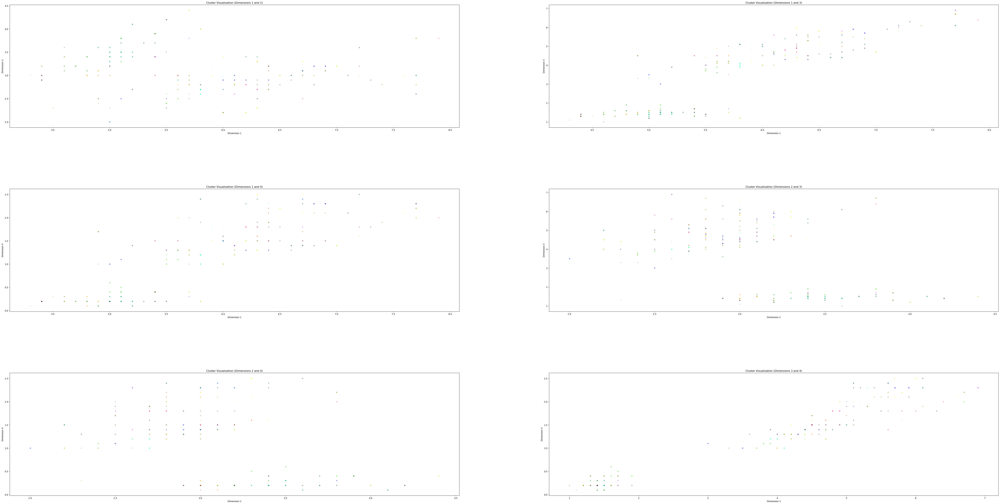

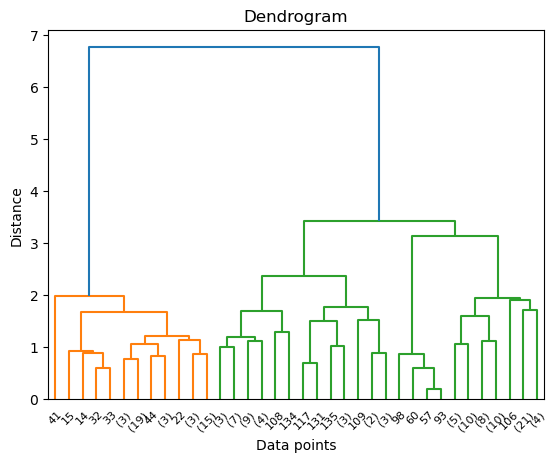

number of clusters 49


<Figure size 640x480 with 0 Axes>

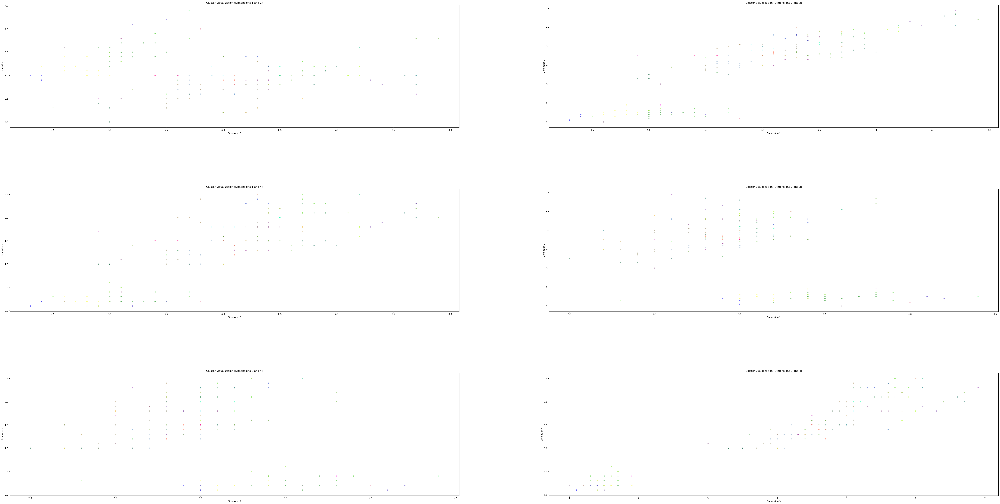

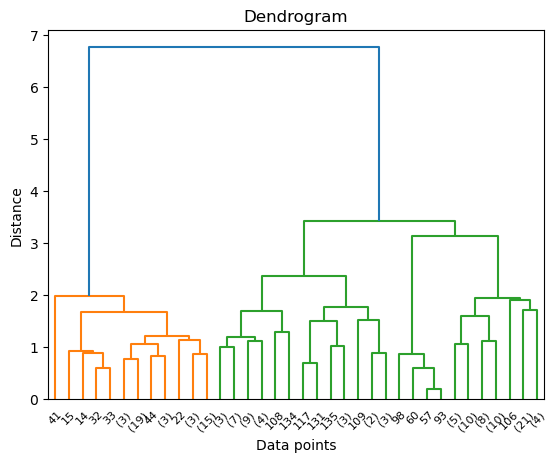

number of clusters 28


<Figure size 640x480 with 0 Axes>

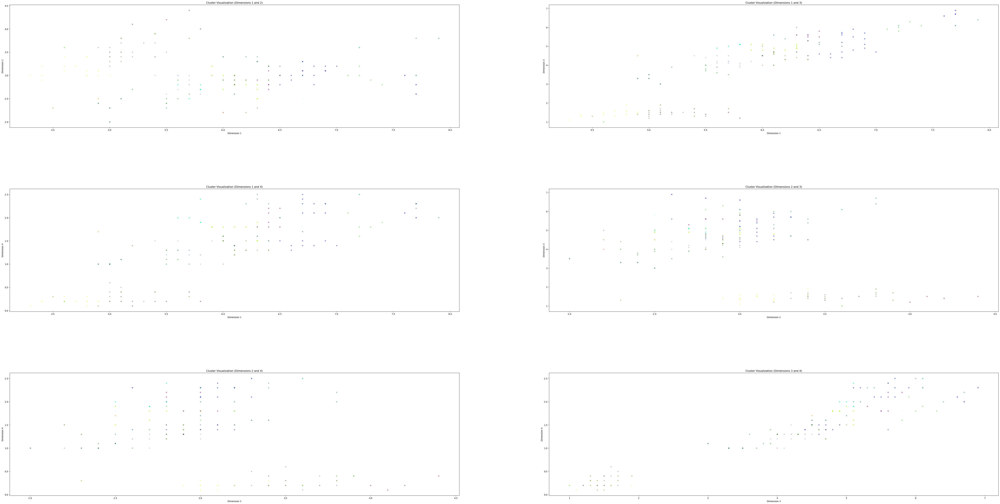

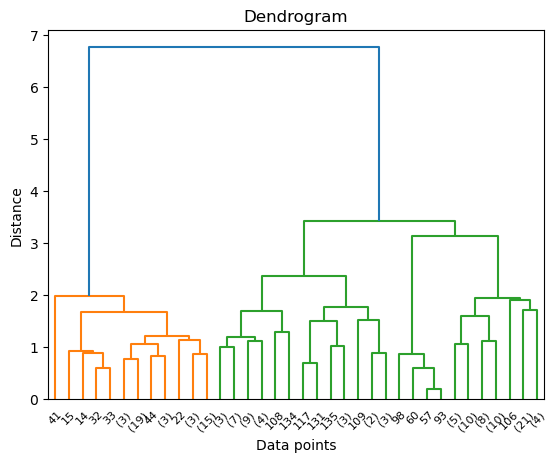

number of clusters 17


<Figure size 640x480 with 0 Axes>

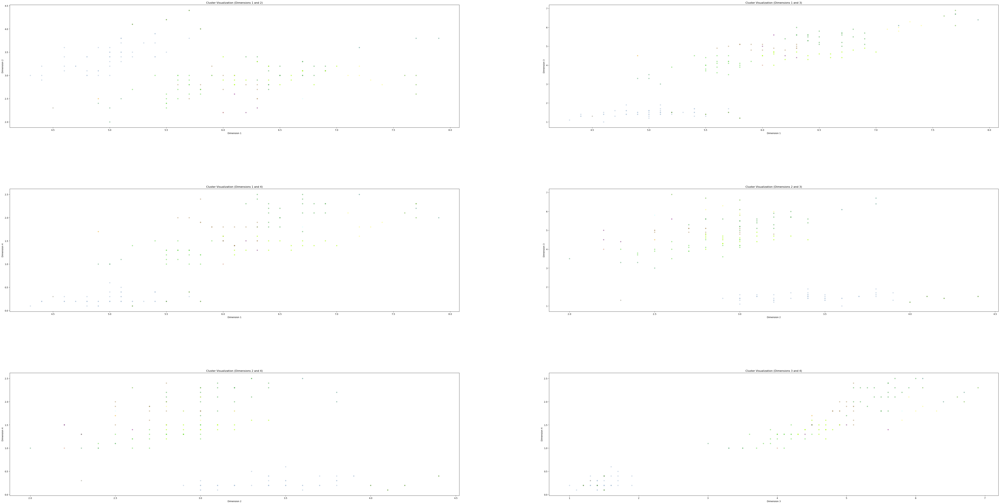

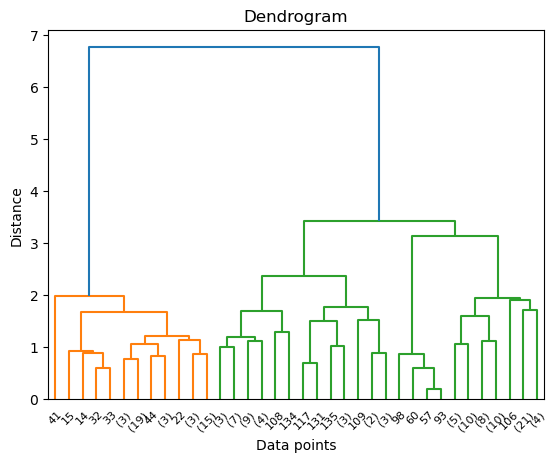

number of clusters 15


<Figure size 640x480 with 0 Axes>

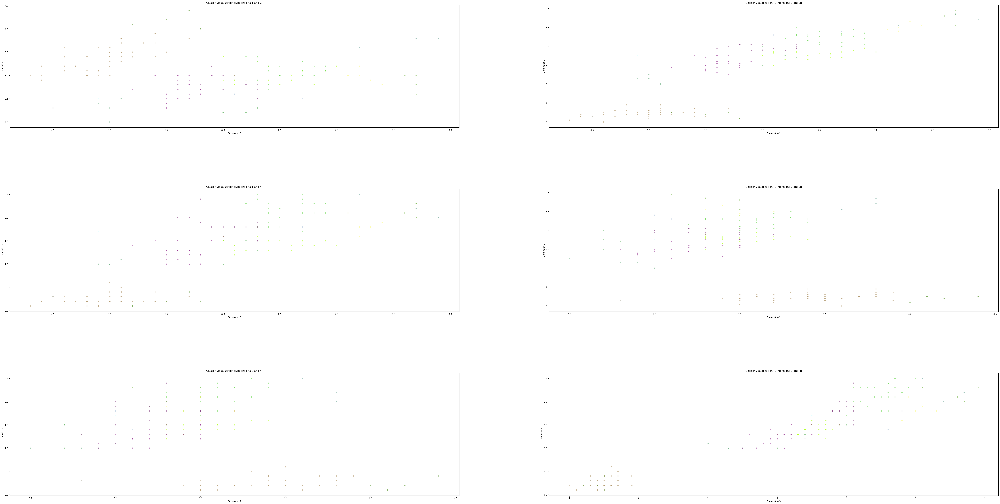

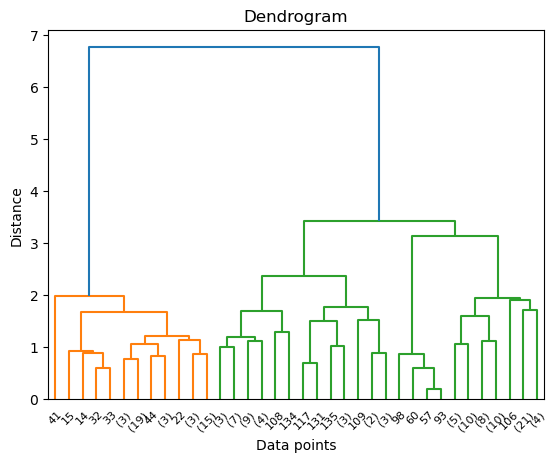

number of clusters 9


<Figure size 640x480 with 0 Axes>

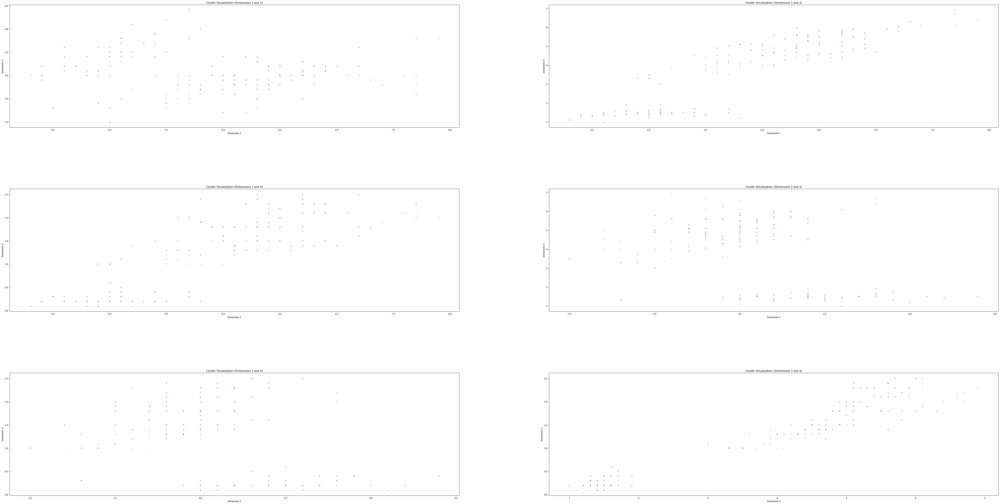

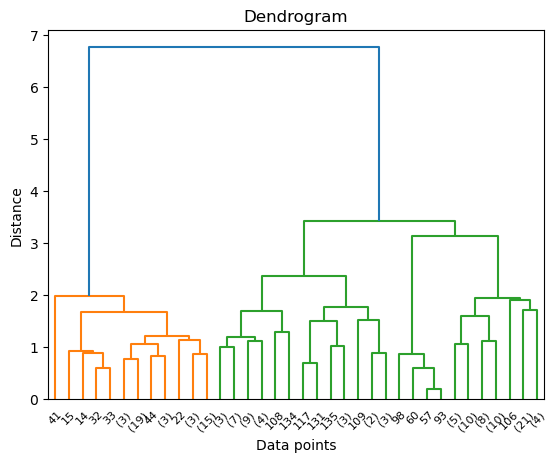

number of clusters 5


<Figure size 640x480 with 0 Axes>

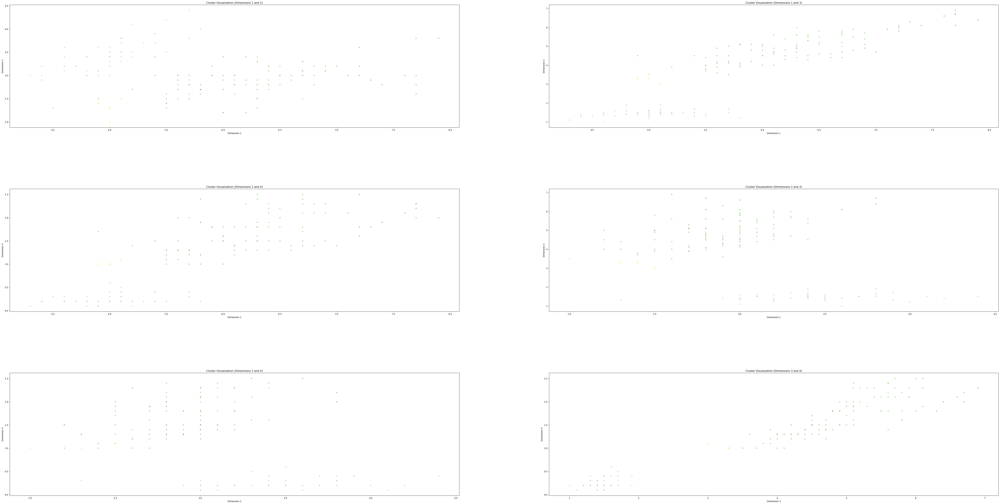

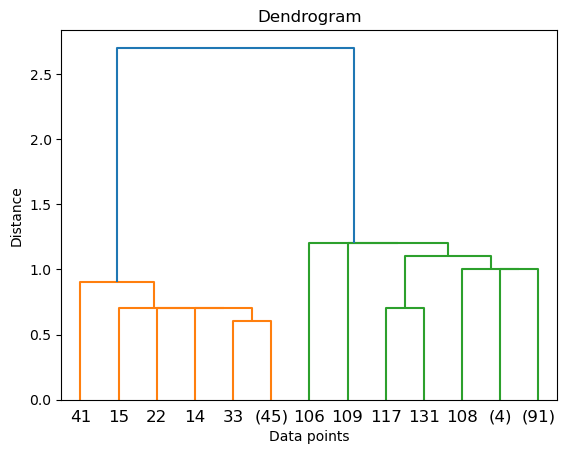

number of clusters 59


<Figure size 640x480 with 0 Axes>

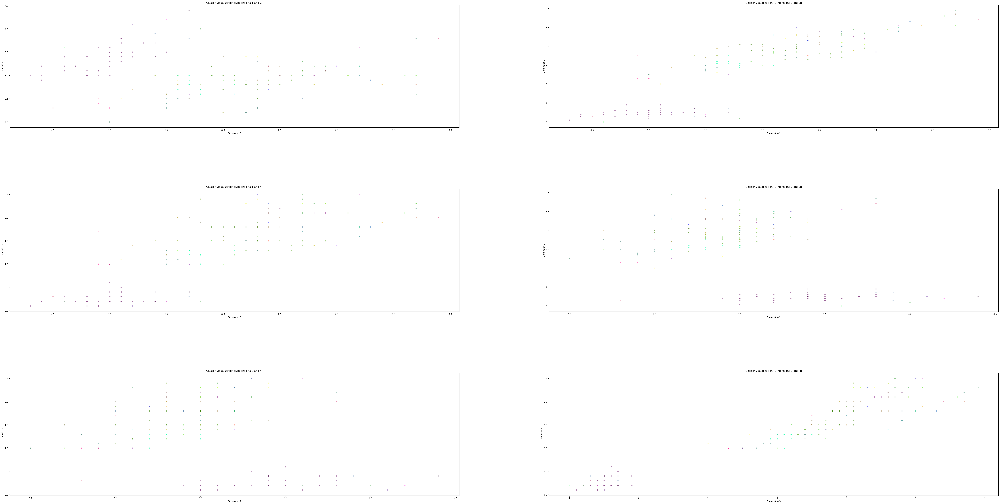

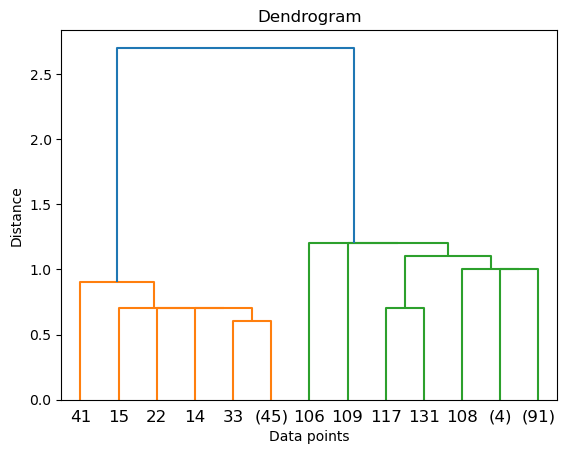

number of clusters 12


<Figure size 640x480 with 0 Axes>

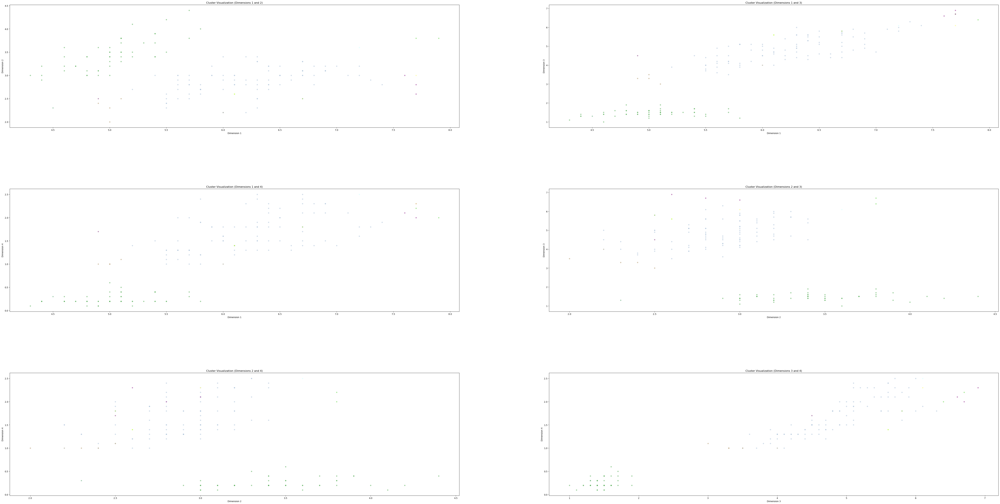

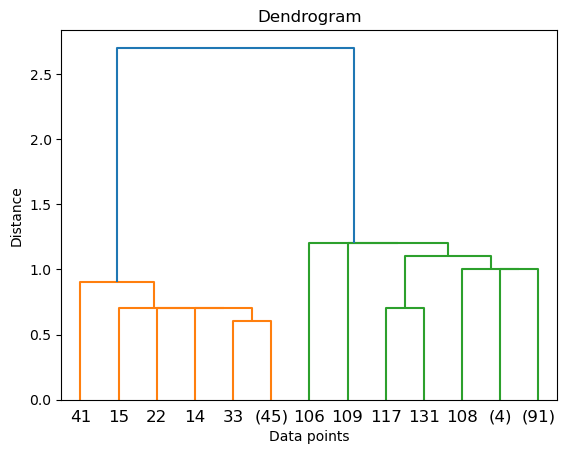

number of clusters 7


<Figure size 640x480 with 0 Axes>

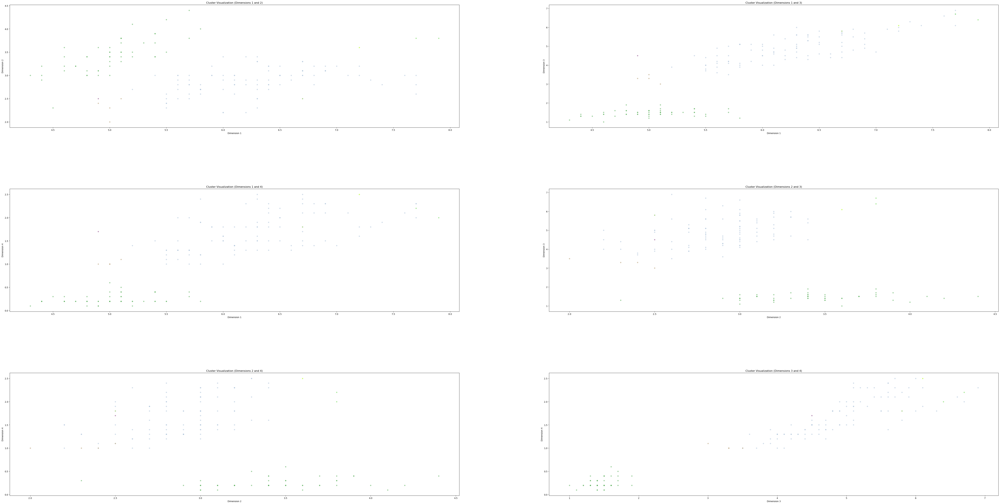

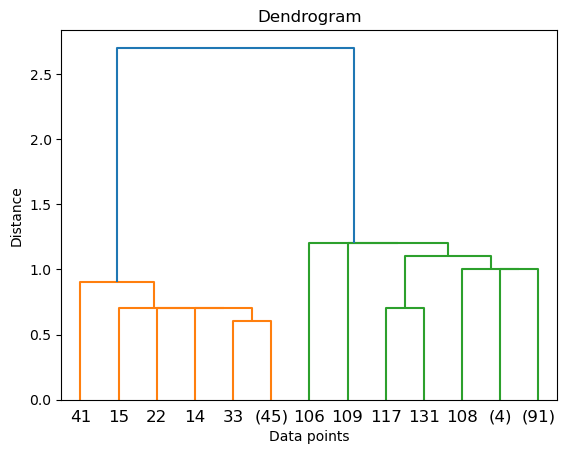

number of clusters 2


<Figure size 640x480 with 0 Axes>

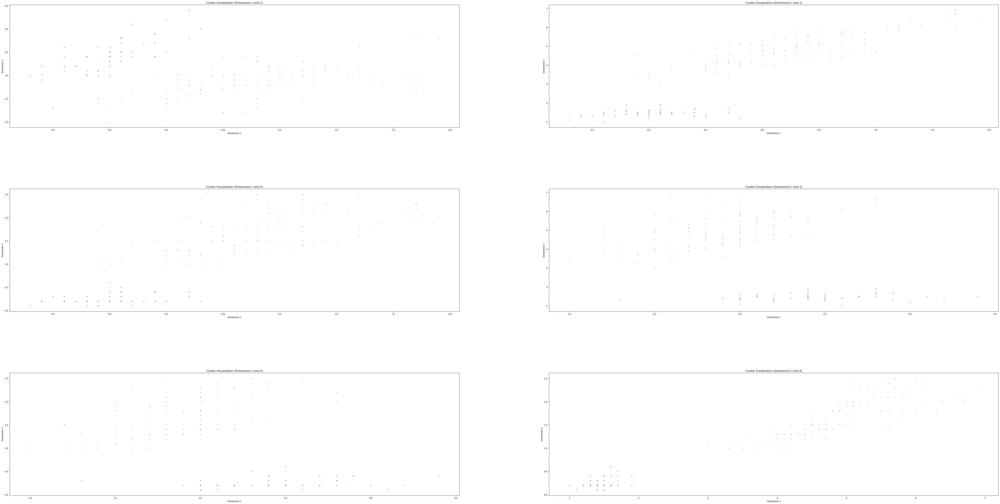

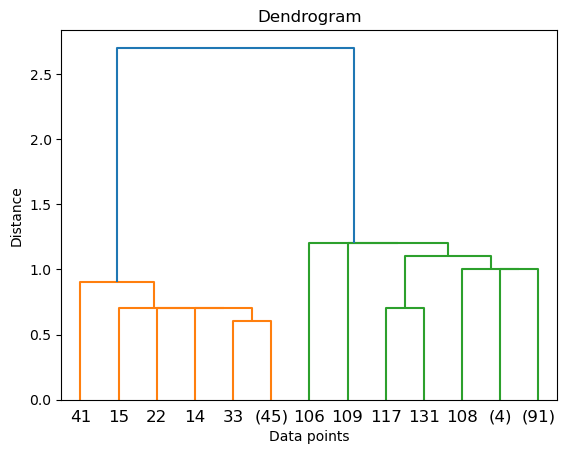

number of clusters 2


<Figure size 640x480 with 0 Axes>

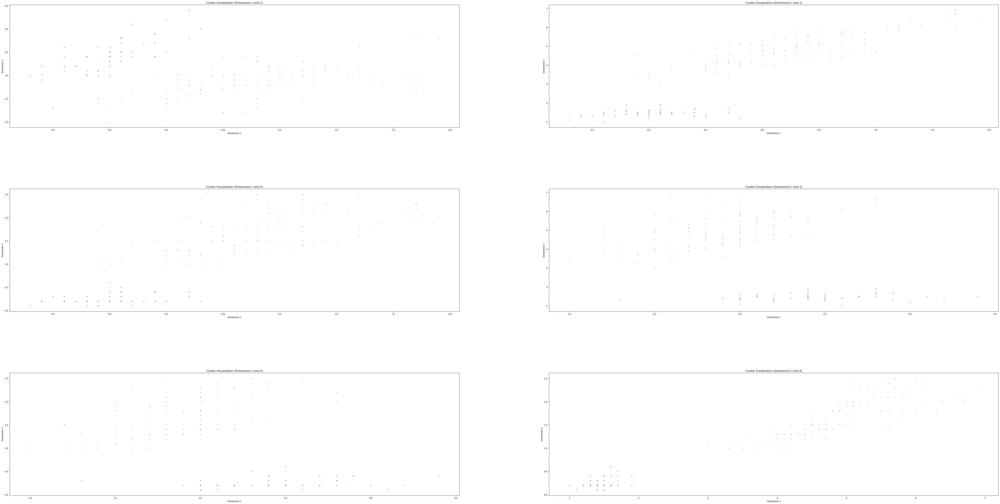

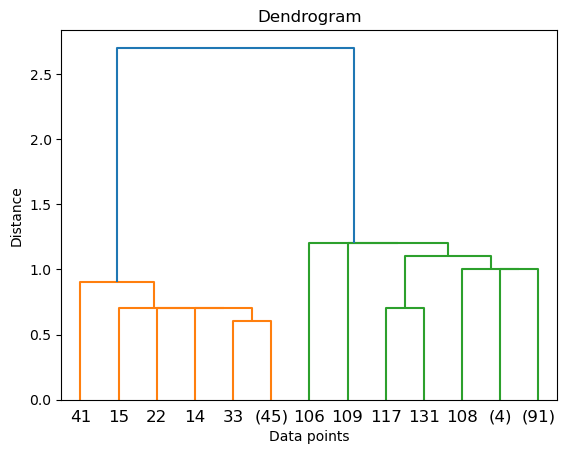

number of clusters 2


<Figure size 640x480 with 0 Axes>

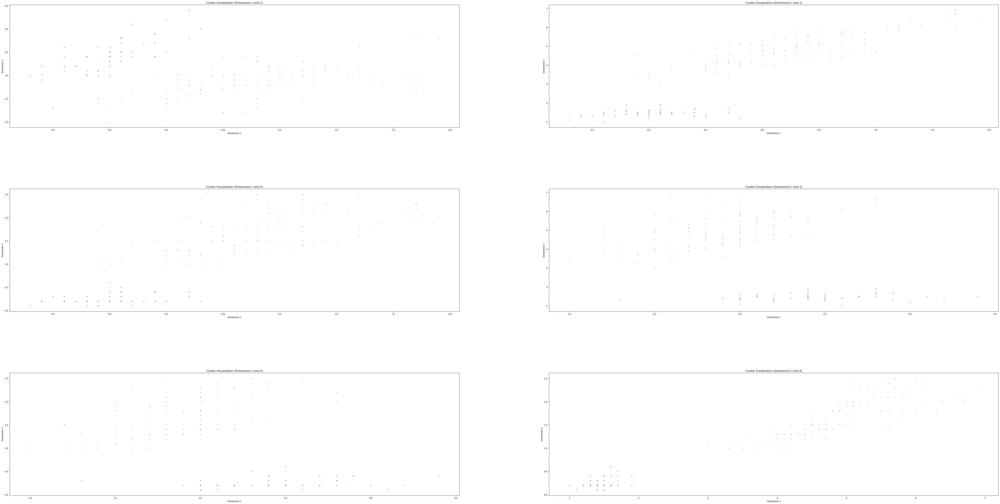

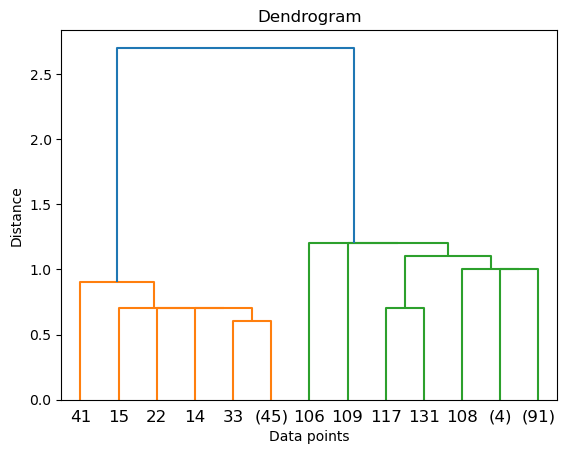

number of clusters 2


<Figure size 640x480 with 0 Axes>

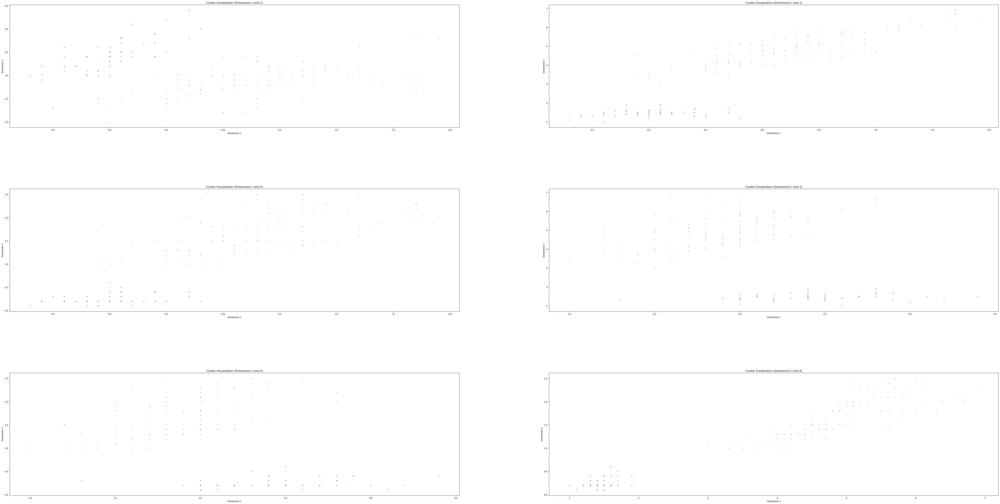

maximum silhouette score:  0.6867350732769777


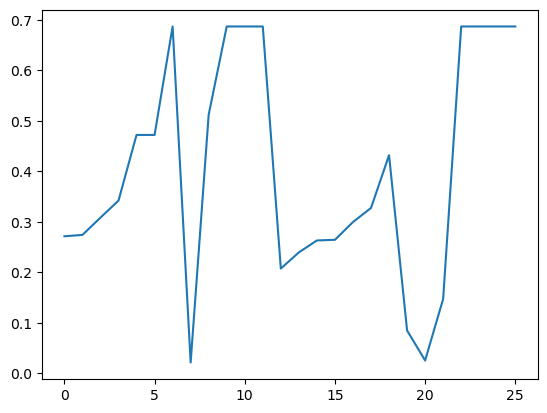

In [20]:
distance_func = ['euclidean', 'manhattan', 'cosine']
Linkages = ['average', 'single']
distance_thresholds = [0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2]


silhouette = []

for distance in distance_func:
    
    for linkage_type in Linkages:
        
        for dist_thresh in distance_thresholds:
        

            model = AgglomerativeClustering(n_clusters=None, metric=distance, linkage=linkage_type, distance_threshold=dist_thresh)

            model.fit(data)
            
            if distance == 'manhattan':
                metric = 'cityblock'
            else:
                metric = distance

            linkage_matrix = linkage(data, method=linkage_type, metric=metric)
            
            if len(np.unique(model.labels_)) > 1:
            
                silhouette_avg = silhouette_score(data, model.labels_)
                silhouette.append(silhouette_avg)

                dendrogram(linkage_matrix, truncate_mode="level", p=5)  # You can adjust 'p' to control the number of clusters
                plt.title('Dendrogram')
                plt.xlabel('Data points')
                plt.ylabel('Distance')
                plt.show()
                
                print("number of clusters", model.n_clusters_)
                plt.figure()
                display_cluster(data, km=model, num_clusters=model.n_clusters_)
                
print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(silhouette)            

# plt.figure()
# display_cluster(Multi_blob_Data, km=model ,num_clusters=model.n_clusters_)

number of clusters:  2


<Figure size 640x480 with 0 Axes>

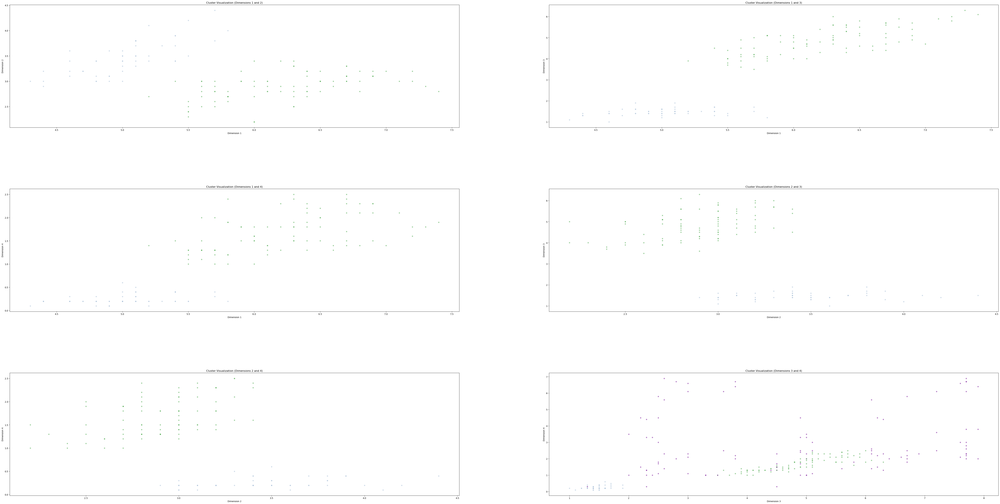

number of clusters:  2


<Figure size 640x480 with 0 Axes>

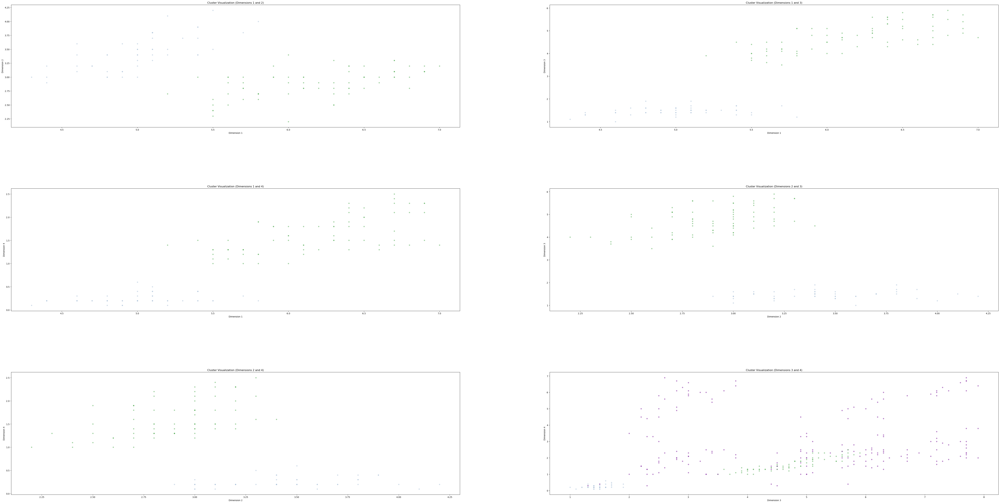

number of clusters:  2


<Figure size 640x480 with 0 Axes>

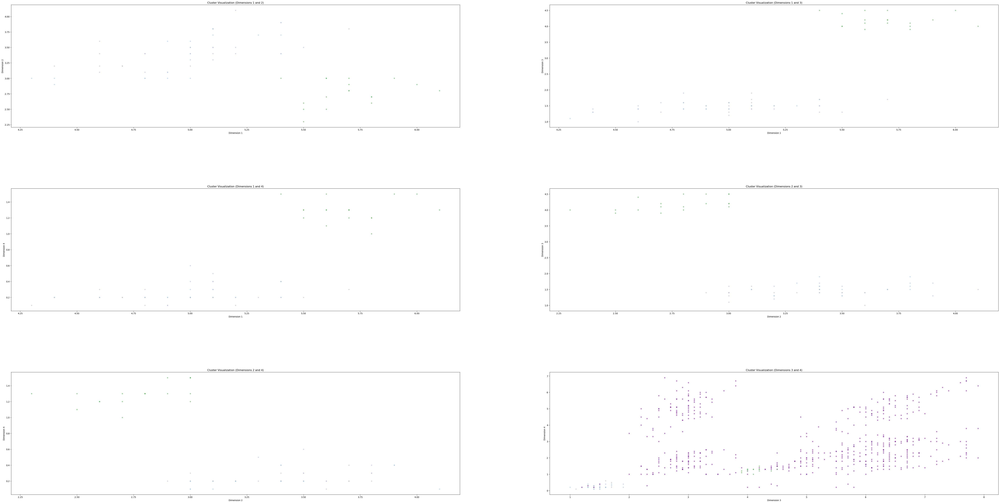

number of clusters:  1


<Figure size 640x480 with 0 Axes>

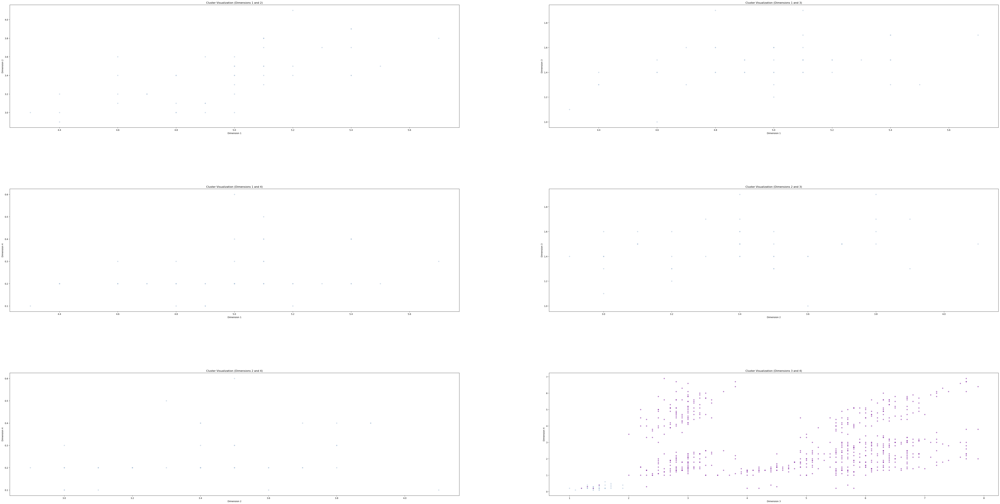

number of clusters:  1


<Figure size 640x480 with 0 Axes>

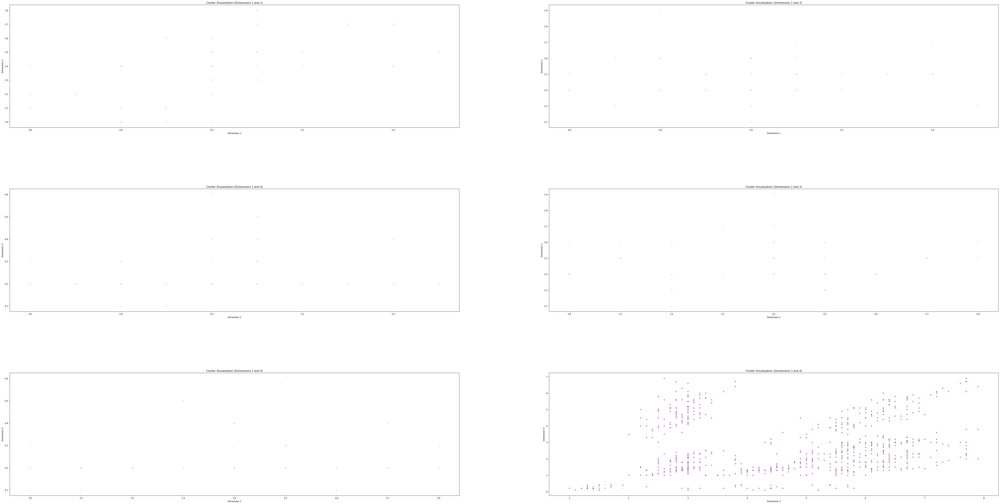

number of clusters:  2


<Figure size 640x480 with 0 Axes>

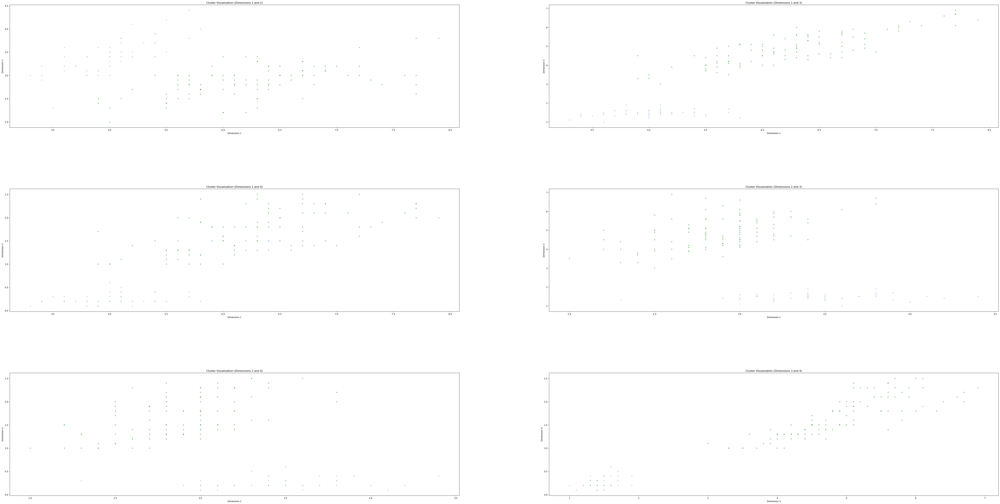

number of clusters:  2


<Figure size 640x480 with 0 Axes>

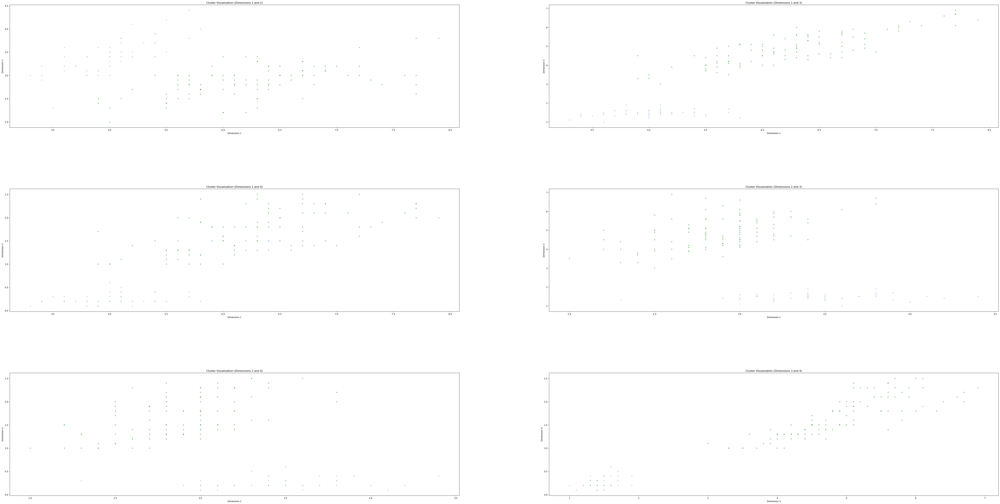

number of clusters:  2


<Figure size 640x480 with 0 Axes>

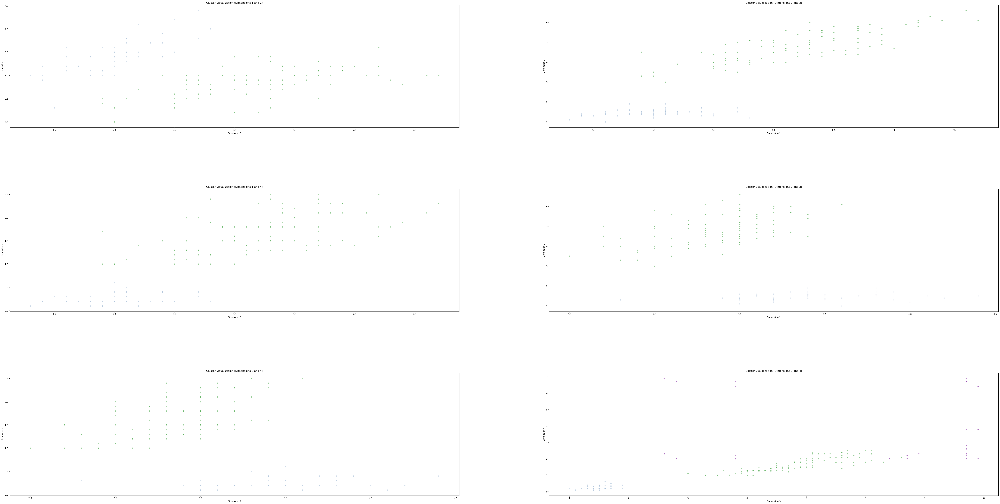

number of clusters:  2


<Figure size 640x480 with 0 Axes>

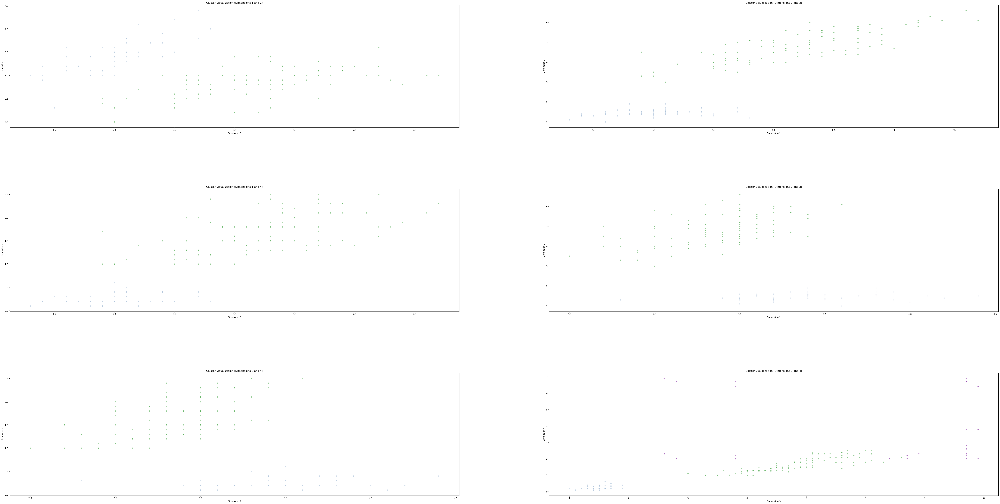

number of clusters:  2


<Figure size 640x480 with 0 Axes>

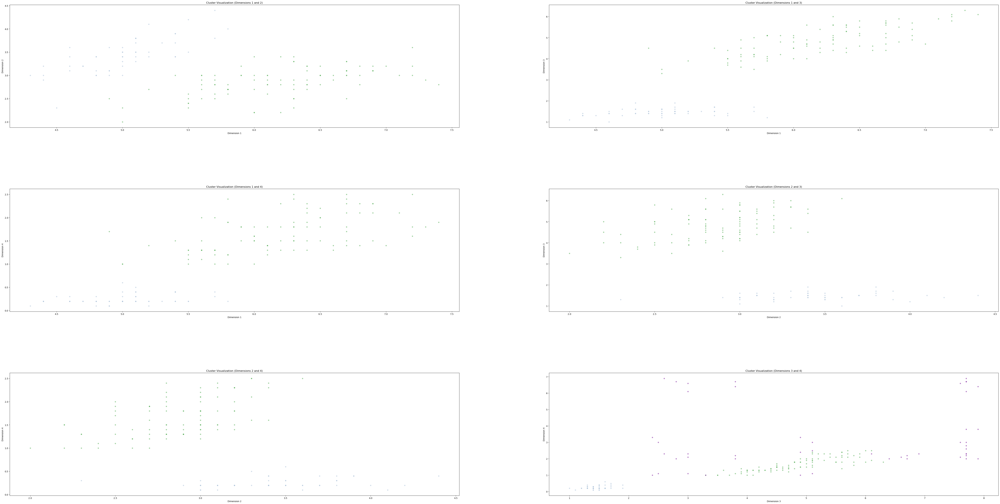

number of clusters:  2


<Figure size 640x480 with 0 Axes>

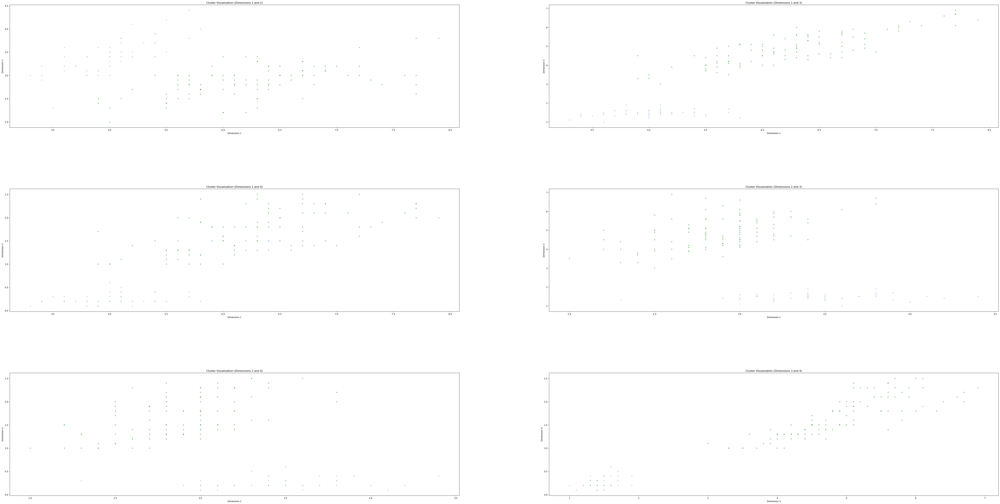

number of clusters:  2


<Figure size 640x480 with 0 Axes>

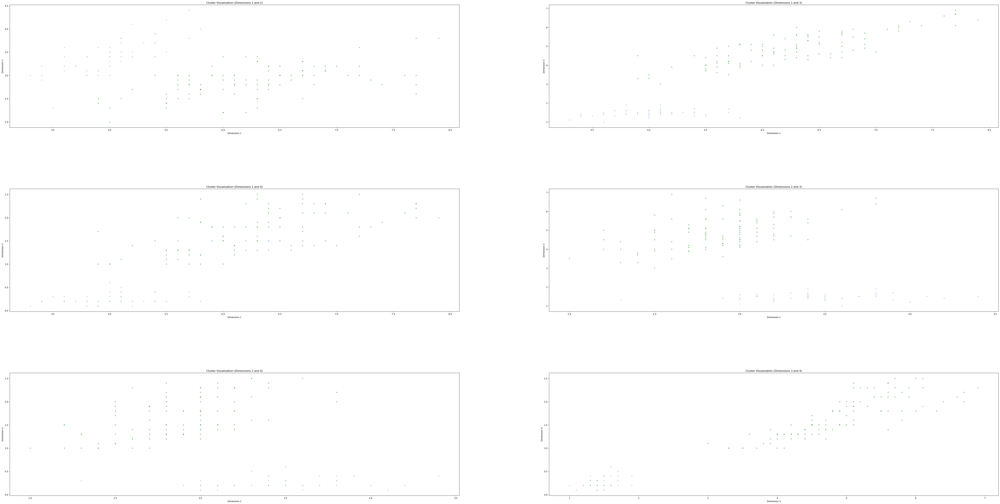

number of clusters:  2


<Figure size 640x480 with 0 Axes>

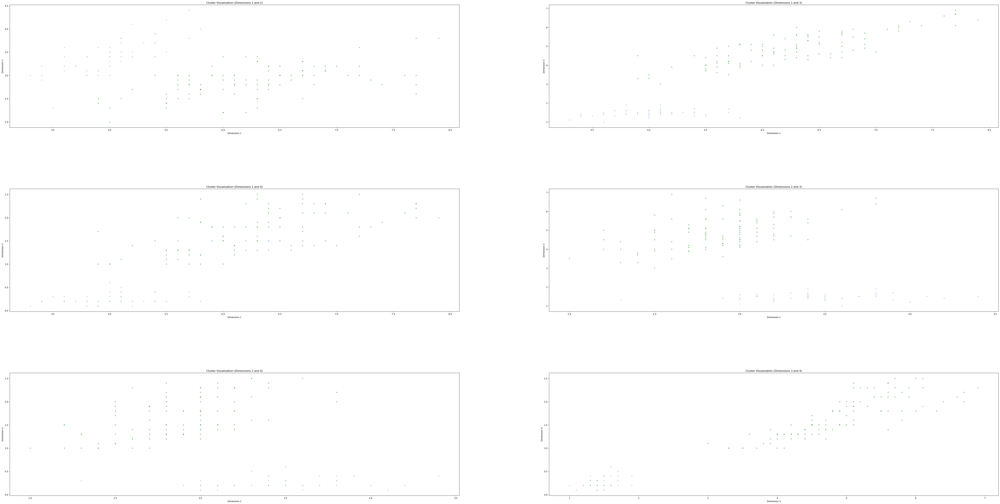

number of clusters:  2


<Figure size 640x480 with 0 Axes>

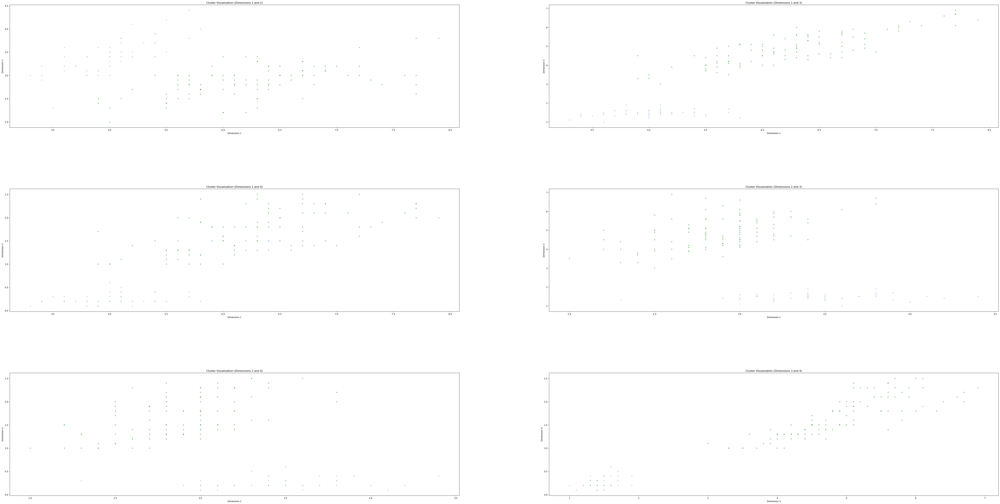

number of clusters:  2


<Figure size 640x480 with 0 Axes>

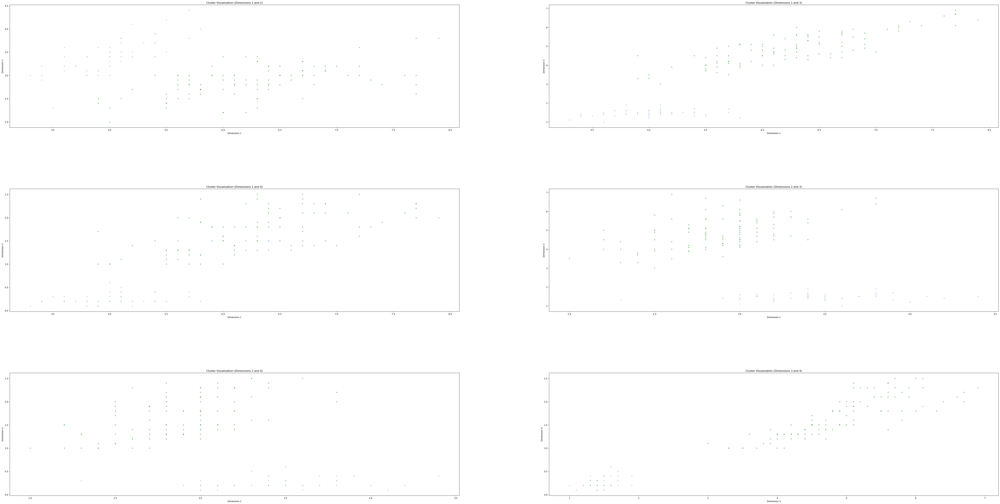

highest score:  0.6867350732769777
best parameters:  (0.9, 5)


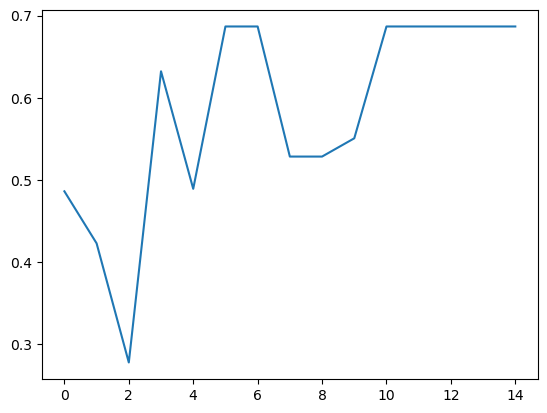

In [21]:
EPS = np.arange(0.1, 3.1, 0.4)
min_samples = np.arange(5, 26, 5)

silhouette = []
params = []

for eps in EPS:
    
    for min_samp in min_samples:

        dbscan = DBSCAN(eps=eps, min_samples=min_samp)  # Adjust eps and min_samples as needed

        # Fit the model to the data
        dbscan.fit(data)

        # Get cluster labels for each data point
        cluster_labels = dbscan.labels_

        # Identify the number of clusters (excluding noise)
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)

        if len(np.unique(cluster_labels)) > 1:
            
            silhouette_avg = silhouette_score(data, cluster_labels)
            silhouette.append(silhouette_avg)
            
            parameters = (eps, min_samp)
            params.append(parameters)
            
            print("number of clusters: ", n_clusters)
            
            plt.figure()
            display_cluster(data, km=dbscan, num_clusters=n_clusters)
       

print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

        
plt.figure()
plt.plot(silhouette)

highest score:  0.6867350732769777
best parameters:  (2, 'full')


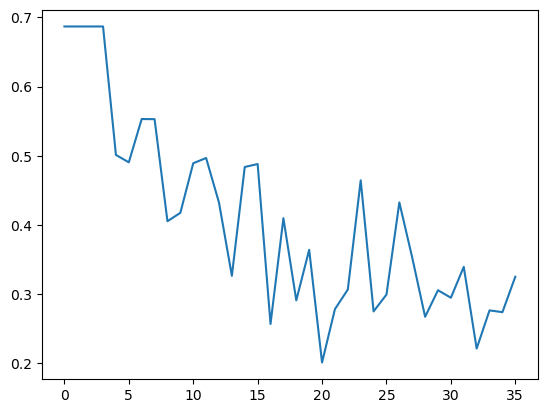

In [22]:
covariance_types = ['full', 'tied', 'diag', 'spherical']

silhouette = []

params = []

for n in range(2, 11): 

    for covariance_type in covariance_types:

        gmm = GaussianMixture(n_components=n, covariance_type=covariance_type)
        gmm.fit(data)
        labels = gmm.predict(data)
        probs = gmm.predict_proba(data)
        
        silhouette_avg = silhouette_score(data, labels)
        silhouette.append(silhouette_avg)
        parameters = (n, covariance_type)
        params.append(parameters)

        log_likelihoods = gmm.score_samples(data)
print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

plt.figure()
plt.plot(silhouette) 

## Customer dataset
Repeat all the above on the customer data set 

In [23]:
df = pd.read_csv(r'C:\Users\Lenovo\Desktop\Ibrahim\ML\Customer_data.csv')

data = df.to_numpy(dtype=np.float64)

2
maximum silhouette score:  0.5828454744042287


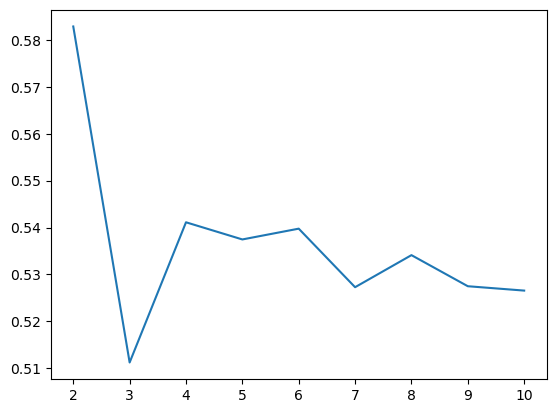

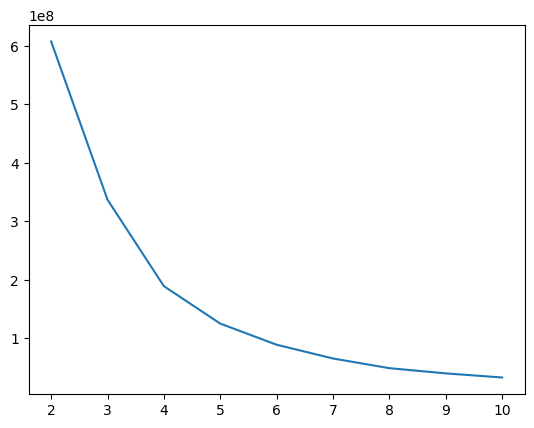

In [28]:
silhouette = []
metric = []
for i in range(2, 11):
    
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(data)
    metric.append((kmeans.inertia_) / len(data))
    silhouette_avg = silhouette_score(data, kmeans.labels_)
    silhouette.append(silhouette_avg)

#     plt.figure()
#     display_cluster(data, km=kmeans,num_clusters=i)
    
    
    
best_cluster = silhouette.index(max(silhouette)) + 2
print(best_cluster)
    
x_axis = np.arange(2, 11)

print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(x_axis, silhouette)

plt.figure()
plt.plot(x_axis, metric)

maximum silhouette score:  0.41472687774301525


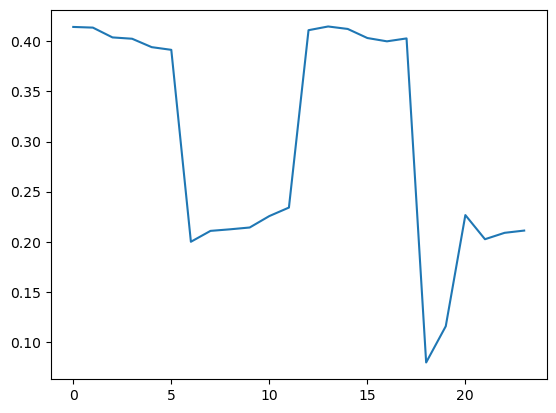

In [30]:
distance_func = ['euclidean', 'manhattan', 'cosine']
Linkages = ['average', 'single']
distance_thresholds = [1000, 1100, 1200, 1300, 1400, 1500]


silhouette = []

for distance in distance_func:
    
    for linkage_type in Linkages:
        
        for dist_thresh in distance_thresholds:
        

            model = AgglomerativeClustering(n_clusters=None, metric=distance, linkage=linkage_type, distance_threshold=dist_thresh)

            model.fit(data)
            
            if distance == 'manhattan':
                metric = 'cityblock'
            else:
                metric = distance

            linkage_matrix = linkage(data, method=linkage_type, metric=metric)
            
            if len(np.unique(model.labels_)) > 1:
            
                silhouette_avg = silhouette_score(data, model.labels_)
                silhouette.append(silhouette_avg)

#                 dendrogram(linkage_matrix, truncate_mode="level", p=5)  # You can adjust 'p' to control the number of clusters
#                 plt.title('Dendrogram')
#                 plt.xlabel('Data points')
#                 plt.ylabel('Distance')
#                 plt.show()
                
#                 print("number of clusters", model.n_clusters_)
#                 plt.figure()
#                 display_cluster(data, km=model, num_clusters=model.n_clusters_)
                
print("maximum silhouette score: ", max(silhouette))

plt.figure()
plt.plot(silhouette)            

# plt.figure()
# display_cluster(Multi_blob_Data, km=model ,num_clusters=model.n_clusters_)

highest score:  0.6199213318255083
best parameters:  (1600, 15)


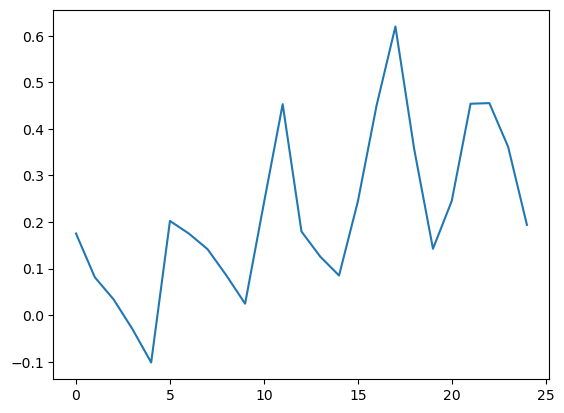

In [31]:
EPS = np.arange(1000, 2000, 200)
min_samples = np.arange(5, 26, 5)

silhouette = []
params = []

for eps in EPS:
    
    for min_samp in min_samples:

        dbscan = DBSCAN(eps=eps, min_samples=min_samp)  # Adjust eps and min_samples as needed

        # Fit the model to the data
        dbscan.fit(data)

        # Get cluster labels for each data point
        cluster_labels = dbscan.labels_

        # Identify the number of clusters (excluding noise)
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        if len(np.unique(cluster_labels)) > 1:
            
            silhouette_avg = silhouette_score(data, cluster_labels)
            silhouette.append(silhouette_avg)
            
            parameters = (eps, min_samp)
            params.append(parameters)
            
#             print("number of clusters: ", n_clusters)
            
#             plt.figure()
#             display_cluster(data, km=dbscan, num_clusters=n_clusters)
        
       

print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

        
plt.figure()
plt.plot(silhouette)

highest score:  0.6373718567082967
best parameters:  (2, 'tied')


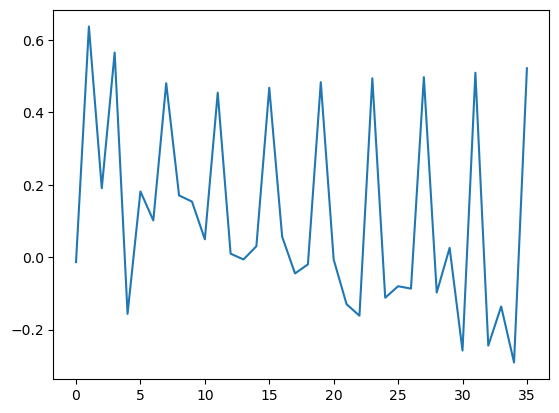

In [6]:
covariance_types = ['full', 'tied', 'diag', 'spherical']

silhouette = []

params = []

for n in range(2, 11): 

    for covariance_type in covariance_types:

        gmm = GaussianMixture(n_components=n, covariance_type=covariance_type)
        gmm.fit(data)
        labels = gmm.predict(data)
        probs = gmm.predict_proba(data)
        
        silhouette_avg = silhouette_score(data, labels)
        silhouette.append(silhouette_avg)
        parameters = (n, covariance_type)
        params.append(parameters)

        log_likelihoods = gmm.score_samples(data)
print("highest score: ", max(silhouette))

max_index = silhouette.index(max(silhouette))
best_param = params[max_index]
print("best parameters: ", best_param)

plt.figure()
plt.plot(silhouette) 